# Imports, Data

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers

import matplotlib.pyplot as plt
import numpy as np
import os
import time
from glob import glob
import math

In [ ]:
print(tf.__version__)

2.4.1


In [ ]:
!nvidia-smi

Tue Mar  9 23:35:13 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.56       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   53C    P8    10W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!pip install tensorflow-addons

     |████████████████████████████████| 706kB 8.0MB/s 


In [ ]:
import tensorflow_addons as tfa

In [ ]:
import cv2
from scipy import ndimage

In [ ]:
# Download resized shots
# Download Line art shots
# Distance map shots
#download weights

In [ ]:
!unzip -q resizedshots.zip

In [ ]:
!unzip -q line_art_shots.zip

In [ ]:
!unzip -q distance_map_shots.zip

In [ ]:
!unzip -q weights.zip

In [ ]:
!mv weights training_checkpoints

In [ ]:
!find . -name ".DS_Store" -delete

## Sketch Keras

In [ ]:
!unzip -q sketchKeras.h5.zip

In [ ]:
!unzip -q final_shots.zip

In [ ]:
def create_sketch_model(input_shape=(1024, 1024, 1)):
  input = layers.Input(shape=input_shape)
  model = layers.Conv2D(32, (3, 3), padding='same')(input)
  model = layers.BatchNormalization()(model)
  activation_1 = layers.ReLU()(model)

  model = layers.Conv2D(64, (4, 4), (2, 2), padding='same')(activation_1)
  model = layers.BatchNormalization()(model)
  model = layers.ReLU()(model)

  model = layers.Conv2D(64, (3, 3), padding='same')(model)
  model = layers.BatchNormalization()(model)
  activation_3 = layers.ReLU()(model)

  model = layers.Conv2D(128, (4, 4), (2, 2), padding='same')(activation_3)
  model = layers.BatchNormalization()(model)
  model = layers.ReLU()(model)

  model = layers.Conv2D(128, (3, 3), padding='same')(model)
  model = layers.BatchNormalization()(model)
  activation_5 = layers.ReLU()(model)

  model = layers.Conv2D(256, (4, 4), (2, 2), padding='same')(activation_5)
  model = layers.BatchNormalization()(model)
  model = layers.ReLU()(model)

  model = layers.Conv2D(256, (3, 3), padding='same')(model)
  model = layers.BatchNormalization()(model)
  activation_7 = layers.ReLU()(model)

  model = layers.Conv2D(512, (4, 4), (2, 2), padding='same')(activation_7)
  model = layers.BatchNormalization()(model)
  activation_8 = layers.ReLU()(model)

  model = layers.Conv2D(512, (3, 3), padding='same')(activation_8)
  model = layers.BatchNormalization()(model)
  activation_9 = layers.ReLU()(model)

  model = layers.concatenate([activation_8, activation_9])

  model = layers.UpSampling2D()(model)

  model = layers.Conv2D(512, (4, 4), padding='same')(model)
  model = layers.BatchNormalization()(model)
  model = layers.ReLU()(model)

  model = layers.Conv2D(256, (3, 3), padding='same')(model)
  model = layers.BatchNormalization()(model)
  activation_11 = layers.ReLU()(model)

  model = layers.concatenate([activation_7, activation_11])

  model = layers.UpSampling2D()(model)

  model = layers.Conv2D(256, (4, 4), padding='same')(model)
  model = layers.BatchNormalization()(model)
  model = layers.ReLU()(model)

  model = layers.Conv2D(128, (3, 3), padding='same')(model)
  model = layers.BatchNormalization()(model)
  activation_13 = layers.ReLU()(model)

  model = layers.concatenate([activation_5, activation_13])

  model = layers.UpSampling2D()(model)

  model = layers.Conv2D(128, (4, 4), padding='same')(model)
  model = layers.BatchNormalization()(model)
  model = layers.ReLU()(model)

  model = layers.Conv2D(64, (3, 3), padding='same')(model)
  model = layers.BatchNormalization()(model)
  activation_15 = layers.ReLU()(model)

  model = layers.concatenate([activation_3, activation_15])

  model = layers.UpSampling2D()(model)

  model = layers.Conv2D(64, (4, 4), padding='same')(model)
  model = layers.BatchNormalization()(model)
  model = layers.ReLU()(model)

  model = layers.Conv2D(32, (3, 3), padding='same')(model)
  model = layers.BatchNormalization()(model)
  activation_17 = layers.ReLU()(model)

  model = layers.concatenate([activation_1, activation_17])

  model = layers.Conv2D(1, (3, 3), padding='same')(model)

  return tf.keras.Model(inputs=input, outputs=[model])

In [ ]:
sketchKeras = create_sketch_model()

In [ ]:
sketchKeras.load_weights("sketchKeras.h5")

In [ ]:
def get_light_map_single(img): # Used
  gray = img
  gray = gray[None]
  gray = gray.transpose((1,2,0))
  blur = cv2.GaussianBlur(gray, (0, 0), 3)
  gray = gray.reshape((gray.shape[0],gray.shape[1]))
  highPass = gray.astype(int) - blur.astype(int)
  highPass = highPass.astype(np.float)
  highPass = highPass / 128.0
  return highPass

def normalize_pic(img): # used
  img = img / np.max(img)
  return img

def resize_img_512_3d(img): # used
    zeros = np.zeros((1,3,1024,1024), dtype=np.float)
    zeros[0 , 0 : img.shape[0] , 0 : img.shape[1] , 0 : img.shape[2]] = img
    return zeros.transpose((1,2,3,0)) # BxCxHxW to CxHxWxB

def show_active_img_and_save_denoise(img, dir_path):
    mat = img.astype(np.float)
    mat = - mat + 1
    mat = mat * 255.0
    mat[mat < 0] = 0
    mat[mat > 255] = 255
    mat = mat.astype(np.uint8)
    mat = ndimage.median_filter(mat, 1)
    # mat = cv2.resize(mat, (455, 256))
    mat = cv2.resize(mat, (1024, 576))
    cv2.imwrite(dir_path, mat)
    return mat

In [ ]:
def get_image(img_path):
  from_mat = cv2.imread(img_path)
  width = float(from_mat.shape[1])
  height = float(from_mat.shape[0])
  new_width = 0
  new_height = 0

  if (width > height):
      from_mat = cv2.resize(from_mat, (1024, int(1024 / width * height)), interpolation=cv2.INTER_AREA)
      new_width = 1024
      new_height = int(1024 / width * height)
  else:
      from_mat = cv2.resize(from_mat, (int(512 / height * width), 512), interpolation=cv2.INTER_AREA)
      new_width = int(512 / height * width)
      new_height = 512

  from_mat = from_mat.transpose((2, 0, 1)) # HxWxC to CxHxW
  light_map = np.zeros(from_mat.shape, dtype=np.float)

  for channel in range(3):
    light_map[channel] = get_light_map_single(from_mat[channel])

  light_map = normalize_pic(light_map)
  light_map = resize_img_512_3d(light_map)

  return light_map, new_width, new_height

In [ ]:
def get_line_art(line_mat, dir_path, new_width, new_height):
  line_mat = line_mat.transpose((3, 1, 2, 0))[0] # CxHxWxB to BxHxWxC
  line_mat = line_mat[0:int(new_height), 0:int(new_width), :]

  image = np.amax(line_mat, 2)

  show_active_img_and_save_denoise(image, dir_path)

In [ ]:
folders = glob("final_shots/*")

In [ ]:
!mkdir line_art_shots

In [ ]:
for folder in folders:
  name = folder.split("/")[1]
  new_dir = f"line_art_shots/{name}"
  os.mkdir(new_dir)
  images = glob(f"./final_shots/{name}/*")

  img_stack = np.empty((len(images) * 3, 1024, 1024, 1))

  for idx, image in enumerate(images):
    img, new_width, new_height = get_image(image)
    img_stack[idx * 3:(idx + 1) * 3,] = img
  
  # print('\r', len(images), end='')

  for index, image in enumerate(images):
    line_mat_stack = np.empty((3, 1024, 1024, 1))

    line_mat_stack = sketchKeras.predict(img_stack[index * 3:(index + 1) * 3,], verbose=0)
    image_name = image.split("/")[-1]
    dir_path = f"{new_dir}/{image_name}"

    get_line_art(line_mat_stack, dir_path, new_width, new_height)

In [ ]:
# from google.colab import output
# output.eval_js('new Audio("https://upload.wikimedia.org/wikipedia/commons/0/05/Beep-09.ogg").play()')

In [ ]:
line_art_folders = glob("line_art_shots/*")

In [ ]:
!mkdir distance_map_shots

In [ ]:
def binarize(sketch, threshold=127):
    return tf.where(sketch < threshold, x=tf.zeros_like(sketch), y=tf.ones_like(sketch) * 255.)

In [ ]:
def get_distance_map(image_path, dir):
  img = tf.keras.preprocessing.image.load_img(image_path, color_mode="grayscale")
  img = tf.keras.preprocessing.image.img_to_array(img)

  sketch = binarize(img)
  a = tf.cast(sketch, tf.uint8).numpy()
  a = a[:, :, 0]

  distance = ndimage.distance_transform_edt(a)
  distance = distance / tf.reduce_max(distance)

  final = (distance + (img[:,:,0] / 255.0) / 12)

  final = tf.image.resize(tf.expand_dims(final, axis=-1), [256, 455])

  tf.keras.preprocessing.image.save_img(dir, final)  

In [ ]:
for folder in line_art_folders:
  name = folder.split("/")[1]
  new_dir = f"distance_map_shots/{name}"
  os.mkdir(new_dir)
  images = glob(f"./line_art_shots/{name}/*")

  print('\r', len(images), end='')

  for image in images:
    image_name = image.split("/")[-1]
    dir_path = f"{new_dir}/{image_name}"

    get_distance_map(image, dir_path)

 8

## Dataset

In [ ]:
name_folders = os.listdir("line_art_shots")

In [ ]:
size = len(glob("line_art_shots/*/*"))

In [ ]:
size

4527

In [ ]:
class TestDataGenerator():
  def __init__(self):
    self.batch_size = 4
    self.image_shape = (256, 455, 3)

  def getitem(self, folders):
    X = self.__get_data(folders)
    return X

  def get_random_positions(self, images_name):
    limit = len(images_name) - 4
    position = np.random.randint(0, limit)

    return [images_name[position], images_name[position + 2], images_name[position + 4]]
  
  def load_image(self, image_path, resize=False):
    img = tf.keras.preprocessing.image.load_img(image_path)
    img = tf.keras.preprocessing.image.img_to_array(img)

    if resize:
      img = tf.image.resize(img, [256, 455])

    img = img / 255.0
    
    return img

  def __get_data(self, batch):
    reference_color_images_0 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)
    reference_line_art_images_0 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)
    reference_distance_maps_0 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)

    reference_color_images_1 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)
    reference_line_art_images_1 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)
    reference_distance_maps_1 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)

    middle_color = np.empty((self.batch_size, *self.image_shape))
    middle_line_art = np.empty((self.batch_size, *self.image_shape))
    middle_distance_map = np.empty((self.batch_size, *self.image_shape))
    
    for i, shot_path in enumerate(batch):
      images_name = sorted(os.listdir(f"resizedshots/{shot_path}"))
      selected_images = self.get_random_positions(images_name)
      
      color_images_paths = [f"resizedshots/{shot_path}/{s_i}" for s_i in selected_images]
      line_art_images_paths = [f"line_art_shots/{shot_path}/{s_i}" for s_i in selected_images]
      distance_map_images_paths = [f"distance_map_shots/{shot_path}/{s_i}" for s_i in selected_images]
      
      reference_color_images_0[i,] = self.load_image(color_images_paths[0])
      reference_line_art_images_0[i,] = self.load_image(line_art_images_paths[0], resize=True)
      reference_distance_maps_0[i,] = self.load_image(distance_map_images_paths[0])

      middle_color[i,] = self.load_image(color_images_paths[1])
      middle_line_art[i,] = self.load_image(line_art_images_paths[1], resize=True)
      middle_distance_map[i,] = self.load_image(distance_map_images_paths[1])

      reference_color_images_1[i,] = self.load_image(color_images_paths[2])
      reference_line_art_images_1[i,] = self.load_image(line_art_images_paths[2], resize=True)
      reference_distance_maps_1[i,] = self.load_image(distance_map_images_paths[2])

      concated_image = tf.concat([reference_color_images_0,
                                reference_line_art_images_0,
                                reference_distance_maps_0,
                                middle_color,
                                middle_line_art,
                                middle_distance_map,
                                reference_color_images_1,
                                reference_line_art_images_1,
                                reference_distance_maps_1], axis=0)

      cropped_image = tf.image.crop_to_bounding_box(concated_image, 0, 99, 256, 256)

    
    rf_0 = cropped_image[0:4], cropped_image[4:8], cropped_image[8:12]
    mid = cropped_image[12:16], cropped_image[16:20], cropped_image[20:24]
    rf_1 = cropped_image[24:28], cropped_image[28:32], cropped_image[32:36]

    #y_small = tf.image.resize(mid[0], [64, 64], method=tf.image.ResizeMethod.BILINEAR)

    return rf_0, mid, rf_1#, y_small

In [ ]:
class InferenceDataGenerator(tf.keras.utils.Sequence):
  def __init__(self, folders_paths, batch_size=4):
    self.image_shape = (256, 455, 3)
    self.batch_size = batch_size
    self.folders_paths = folders_paths
    self.shuffle = shuffle
    self.on_epoch_end()

  def __len__(self):
    return len(self.folders_paths) // self.batch_size

  def __getitem__(self, index):
    index = self.index[index * self.batch_size:(index + 1) * self.batch_size]
    batch = [self.folders_paths[k] for k in index]

    X = self.__get_data(batch)
    return X

  def on_epoch_end(self):
    self.index = np.arange(len(self.folders_paths))
  
  def load_image(self, image_path, resize=False):
    img = tf.keras.preprocessing.image.load_img(image_path)
    img = tf.keras.preprocessing.image.img_to_array(img)
    
    if resize:
      img = tf.image.resize(img, [256, 455])

    img = img / 255.0
    
    return img

  def __get_data(self, batch):
    reference_color_images_0 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)
    reference_line_art_images_0 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)
    reference_distance_maps_0 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)

    reference_color_images_1 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)
    reference_line_art_images_1 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)
    reference_distance_maps_1 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)

    middle_line_art = np.empty((self.batch_size, *self.image_shape))
    middle_distance_map = np.empty((self.batch_size, *self.image_shape))
    
    for i, shot_path in enumerate(batch):
      selected_images = sorted(os.listdir(f"test_shots/color/{shot_path}"))[:4]
      
      color_images_paths = [f"test_shots/color/{shot_path}/{s_i}" for s_i in [selected_images[0], selected_images[-1]]]
      line_art_images_paths = [f"test_shots/line_art_shots/{shot_path}/{s_i}" for s_i in selected_images]
      distance_map_images_paths = [f"test_shots/distance_map_shots/{shot_path}/{s_i}" for s_i in selected_images]
      
      reference_color_images_0[i,] = self.load_image(color_images_paths[0])
      reference_line_art_images_0[i,] = self.load_image(line_art_images_paths[0], resize=True)
      reference_distance_maps_0[i,] = self.load_image(distance_map_images_paths[0])

      middle_line_art[i,] = self.load_image(line_art_images_paths[1], resize=True)
      middle_distance_map[i,] = self.load_image(distance_map_images_paths[1])

      reference_color_images_1[i,] = self.load_image(color_images_paths[1])
      reference_line_art_images_1[i,] = self.load_image(line_art_images_paths[2], resize=True)
      reference_distance_maps_1[i,] = self.load_image(distance_map_images_paths[2])

      concated_image = tf.concat([reference_color_images_0,
                                reference_line_art_images_0,
                                reference_distance_maps_0,
                                middle_color,
                                middle_line_art,
                                middle_distance_map,
                                reference_color_images_1,
                                reference_line_art_images_1,
                                reference_distance_maps_1], axis=0)

      cropped_image = tf.image.crop_to_bounding_box(concated_image, 0, 99, 256, 256)

    rf_0 = cropped_image[0:(self.batch_size)], cropped_image[(self.batch_size):(self.batch_size * 2)], cropped_image[(self.batch_size * 2):(self.batch_size * 3)]
    mid = cropped_image[(self.batch_size * 3):(self.batch_size * 4)], cropped_image[(self.batch_size * 4):(self.batch_size * 5)]
    rf_1 = cropped_image[(self.batch_size * 5):(self.batch_size * 6)], cropped_image[(self.batch_size * 6):(self.batch_size * 7)], cropped_image[(self.batch_size * 7):(self.batch_size * 8)]

    return rf_0, mid, rf_1

In [ ]:
class DataGenerator(tf.keras.utils.Sequence):
  def __init__(self, folders_paths, batch_size=4, shuffle=True):
    self.image_shape = (256, 455, 3)
    self.batch_size = batch_size
    self.folders_paths = folders_paths
    self.shuffle = shuffle
    self.on_epoch_end()

  def __len__(self):
    return len(self.folders_paths) // self.batch_size

  def __getitem__(self, index):
    index = self.index[index * self.batch_size:(index + 1) * self.batch_size]
    batch = [self.folders_paths[k] for k in index]

    X = self.__get_data(batch)
    return X

  def on_epoch_end(self):
    self.index = np.arange(len(self.folders_paths))
    if self.shuffle == True:
        np.random.shuffle(self.index)

  def get_random_positions(self, images_name):
    limit = len(images_name) - 4
    position = np.random.randint(0, limit)

    return [images_name[position], images_name[position + 2], images_name[position + 4]]
  
  def load_image(self, image_path, resize=False):
    img = tf.keras.preprocessing.image.load_img(image_path)
    img = tf.keras.preprocessing.image.img_to_array(img)
    
    if resize:
      img = tf.image.resize(img, [256, 455])

    img = img / 255.0
    
    return img

  def __get_data(self, batch):
    reference_color_images_0 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)
    reference_line_art_images_0 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)
    reference_distance_maps_0 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)

    reference_color_images_1 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)
    reference_line_art_images_1 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)
    reference_distance_maps_1 = np.empty((self.batch_size, *self.image_shape), dtype=np.float32)

    middle_color = np.empty((self.batch_size, *self.image_shape))
    middle_line_art = np.empty((self.batch_size, *self.image_shape))
    middle_distance_map = np.empty((self.batch_size, *self.image_shape))
    
    for i, shot_path in enumerate(batch):
      images_name = sorted(os.listdir(f"resizedshots/{shot_path}"))
      selected_images = self.get_random_positions(images_name)
      
      color_images_paths = [f"resizedshots/{shot_path}/{s_i}" for s_i in selected_images]
      line_art_images_paths = [f"line_art_shots/{shot_path}/{s_i}" for s_i in selected_images]
      distance_map_images_paths = [f"distance_map_shots/{shot_path}/{s_i}" for s_i in selected_images]
      
      reference_color_images_0[i,] = self.load_image(color_images_paths[0])
      reference_line_art_images_0[i,] = self.load_image(line_art_images_paths[0], resize=True)
      reference_distance_maps_0[i,] = self.load_image(distance_map_images_paths[0])

      middle_color[i,] = self.load_image(color_images_paths[1])
      middle_line_art[i,] = self.load_image(line_art_images_paths[1], resize=True)
      middle_distance_map[i,] = self.load_image(distance_map_images_paths[1])

      reference_color_images_1[i,] = self.load_image(color_images_paths[2])
      reference_line_art_images_1[i,] = self.load_image(line_art_images_paths[2], resize=True)
      reference_distance_maps_1[i,] = self.load_image(distance_map_images_paths[2])

      concated_image = tf.concat([reference_color_images_0,
                                reference_line_art_images_0,
                                reference_distance_maps_0,
                                middle_color,
                                middle_line_art,
                                middle_distance_map,
                                reference_color_images_1,
                                reference_line_art_images_1,
                                reference_distance_maps_1], axis=0)
      
      # cropped_image = tf.image.random_crop(concated_image, size=[self.batch_size * 9, 256, 256, 3])

      cropped_image = tf.image.crop_to_bounding_box(concated_image, 0, 99, 256, 256)

    
    rf_0 = cropped_image[0:4], cropped_image[4:8], cropped_image[8:12]
    mid = cropped_image[12:16], cropped_image[16:20], cropped_image[20:24]
    rf_1 = cropped_image[24:28], cropped_image[28:32], cropped_image[32:36]

    # y_small = tf.image.resize(mid[0], [64, 64], method=tf.image.ResizeMethod.BILINEAR)

    return rf_0, mid, rf_1#, y_small

In [ ]:
train_generator = DataGenerator(name_folders)

In [ ]:
test_generator = TestDataGenerator()

In [ ]:
reference_0, middle, reference_1 = train_generator.__getitem__(44)

In [ ]:
reference_0[0][0].dtype, middle[0][0].dtype, reference_1[0][0].dtype

(tf.float32, tf.float32, tf.float32)

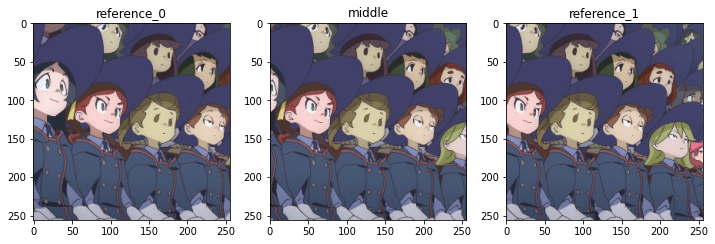

In [ ]:
_, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 10))
ax[0].set_title("reference_0")
ax[0].imshow(reference_0[0][0])

ax[1].set_title("middle")
ax[1].imshow(middle[0][0])

ax[2].set_title("reference_1")
ax[2].imshow(reference_1[0][0])

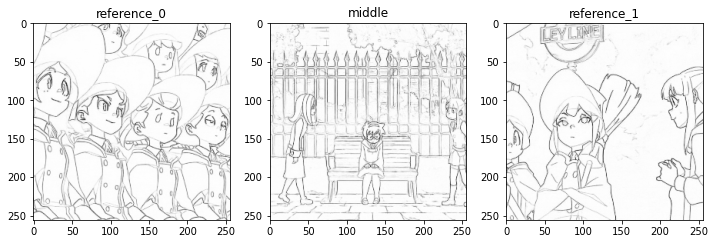

In [ ]:
_, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 10))
ax[0].set_title("reference_0")
ax[0].imshow(reference_0[1][0])

ax[1].set_title("middle")
ax[1].imshow(middle[1][1])

ax[2].set_title("reference_1")
ax[2].imshow(reference_1[1][2])

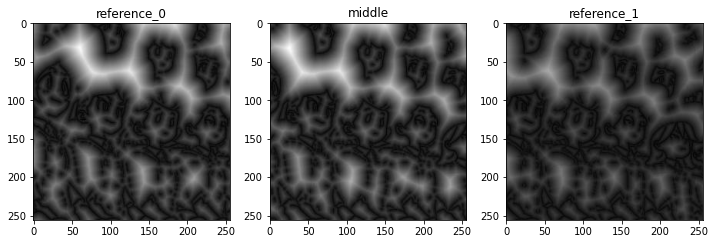

In [ ]:
_, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 10))
ax[0].set_title("reference_0")
ax[0].imshow(reference_0[2][0])

ax[1].set_title("middle")
ax[1].imshow(middle[2][0])

ax[2].set_title("reference_1")
ax[2].imshow(reference_1[2][0])

# Spectral Normalization

In [ ]:
class SpectralNormalization(layers.Wrapper):
  def __init__(self, layer, iteration=1, eps=1e-12, training=True, **kwargs):
    super(SpectralNormalization, self).__init__(layer, **kwargs)
    self.iteration = iteration
    self.eps = eps
    self.do_power_iteration = training
  
  def build(self, input_shape):
    self.layer.build(input_shape)
    self.w = self.layer.kernel
    self.w_shape = self.w.shape.as_list()

    self.v = self.add_weight(shape=(1, tf.math.reduce_prod(self.w_shape[:-1])),
                                    initializer=tf.initializers.TruncatedNormal(stddev=0.02),
                                    trainable=False,
                                    name='sn_v',
                                    dtype=tf.float32)
    
    self.u = self.add_weight(shape=(1, self.w_shape[-1]),
                              initializer=tf.initializers.TruncatedNormal(stddev=0.02),
                              trainable=False,
                              name='sn_u',
                              dtype=tf.float32)
  
    super(SpectralNormalization, self).build()
  
  def call(self, layer_inputs):
    self.update_weights()
    output = self.layer(layer_inputs)
    # self.restore_weights()

    return output

  def update_weights(self):
    w_reshaped = tf.reshape(self.w, [-1, self.w_shape[-1]])
    
    u_hat = self.u
    v_hat = self.v

    if self.do_power_iteration:
      for _ in range(self.iteration):
        v_ = tf.matmul(u_hat, tf.transpose(w_reshaped))
        v_hat = v_ / (tf.reduce_sum(v_ ** 2) ** 0.5 + self.eps)

        u_ = tf.matmul(v_hat, w_reshaped)
        u_hat = u_ / (tf.reduce_sum(u_**2)**0.5 + self.eps)


    sigma = tf.matmul(tf.matmul(v_hat, w_reshaped), tf.transpose(u_hat))
    self.u.assign(u_hat)
    self.v.assign(v_hat)

    self.layer.kernel.assign(self.w / sigma)
      
  def restore_weights(self):
    self.layer.kernel.assign(self.w)

# Temporal Constrain Network

## LearnableTSM

In [ ]:
class LearnableTSM(tf.keras.Model):
  def __init__(self):
    super(LearnableTSM, self).__init__()
    self.shift_ratio = 0.5
    self.shift_groups = 2
    self.shift_width = 3

    pre_weights = tf.constant([0.0, 0.0, 1.0], dtype=tf.float32)
    pre_weights = tf.reshape(pre_weights, [3, 1, 1, 1, 1])

    post_weights = tf.constant([1.0, 0.0, 0.0], dtype=tf.float32)
    post_weights = tf.reshape(post_weights, [3, 1, 1, 1, 1])

    self.pre_shift_conv = layers.Conv3D(1, [3, 1, 1], use_bias=False, padding="same", weights=[pre_weights])
    self.post_shift_conv = layers.Conv3D(1, [3, 1, 1], use_bias=False, padding="same", weights=[post_weights])

    # at least 3 kernels so we obtain T=3 ?

  def apply_tsm(self, tensor, conv):
    B, T, H, W, C = tensor.shape

    tensor = tf.transpose(tensor, [0, 4, 1, 2, 3])
    tensor = conv(tf.reshape(tensor, [B * C, T, H, W, 1]))
    tensor = tf.reshape(tensor, [B, C, T, H, W])
    tensor = tf.transpose(tensor, [0, 2, 3, 4, 1])

    return tensor

  def call(self, input_tensor):
    shape = B, T, H, W, C = input_tensor.shape
    split_size = int(C * self.shift_ratio) // self.shift_groups

    split_sizes = [split_size] * self.shift_groups + [C - split_size * self.shift_groups]
    tensors = tf.split(input_tensor, split_sizes, -1)
    assert len(tensors) == self.shift_groups + 1

    # we pass all the images here(full batch) but each image only contains a part of its channels
    tensor_1 = self.apply_tsm(tensors[0], self.pre_shift_conv)
    tensor_2 = self.apply_tsm(tensors[1], self.post_shift_conv)

    final_tensor = tf.concat([tensor_1, tensor_2, tensors[2]], -1)
    final_tensor = tf.reshape(final_tensor, shape)

    # tf.keras.layers.Reshape
    
    return final_tensor

## Gated Conv

In [ ]:
class GatedConv(tf.keras.Model):
  def __init__(self, kernels, kernel_size, strides, dilation=(1, 1)):
    super(GatedConv, self).__init__()

    self.learnableTSM = LearnableTSM()
    self.feature_conv = SpectralNormalization(layers.Conv2D(kernels, kernel_size, strides=strides, padding="same", dilation_rate=dilation))

    self.gate_conv = SpectralNormalization(layers.Conv2D(kernels, kernel_size, strides=strides, padding="same", dilation_rate=dilation))

    self.activation = layers.LeakyReLU(0.2)
  
  def call(self, input_tensor):
    B, T, H, W, C = input_tensor.shape
    xs = tf.split(input_tensor, num_or_size_splits=T, axis=1)
    gating = tf.stack([self.gate_conv(tf.squeeze(x, axis=1)) for x in xs], axis=1)
    gating = tf.keras.activations.sigmoid(gating)

    feature = self.learnableTSM(input_tensor)
    # shape B, T, H, W, C

    feature = self.feature_conv(tf.reshape(feature, [B * T, H, W, C]))
    _, H_, W_, C_ = feature.shape
    feature = tf.reshape(feature, [B, T, H_, W_, C_])
    feature = self.activation(feature)

    out = gating * feature

    return out

In [ ]:
class GatedDeConv(tf.keras.Model):
  def __init__(self, kernels):
    super(GatedDeConv, self).__init__()
    self.gate_conv = GatedConv(kernels, (3, 3), (1, 1))
    self.upsampling = layers.UpSampling3D(size=(1, 2, 2))
  
  def call(self, input_tensor):
    x = self.upsampling(input_tensor)
    x = self.gate_conv(x)

    return x

In [ ]:
# NEW OPTION
class TemporalConstraintNetwork(tf.keras.Model):
  def __init__(self):
    super(TemporalConstraintNetwork, self).__init__()
    self.conv_1 = layers.Conv2D(64, (3, 3), strides=(1, 1), padding="same")
    self.conv_2 = GatedConv(64, (3, 3), (1, 1))
    self.conv_3 = GatedConv(128, (3, 3), (2, 2))
    self.conv_4 = GatedConv(256, (3, 3), (2, 2))

    self.dilation_1 = GatedConv(256, (3, 3), (1, 1), (2, 2)) # 2
    self.dilation_2 = GatedConv(256, (3, 3), (1, 1), (2, 2)) # 4
    self.dilation_3 = GatedConv(256, (3, 3), (1, 1), (2, 2)) # 8
    self.dilation_4 = GatedConv(256, (3, 3), (1, 1), (2, 2)) # 16

    self.conv_5 = GatedConv(256, (3, 3), (1, 1))
    self.up_conv_1 = GatedDeConv(128)
    self.up_conv_2 = GatedDeConv(3)

    # self.activation = layers.Activation("sigmoid")
  
  def call(self, input_tensor):
    x = self.conv_1(input_tensor)
    x = self.conv_2(x) # Bx3x256x256x64
    x_1 = self.conv_3(x) # Bx3x128x128x128
    x_2 = self.conv_4(x_1) # Bx3x64x64x256

    x = self.dilation_1(x_2)
    x = self.dilation_2(x)
    x = self.dilation_3(x)
    x = self.dilation_4(x) # Bx3x64x64x256

    x = self.conv_5(x) # Bx3x64x64x256
    x = layers.concatenate([x, x_2], axis=-1) # or axis 1??
    x = self.up_conv_1(x)
    x = layers.concatenate([x, x_1], axis=-1) # or axis 1??
    x = self.up_conv_2(x)
    # x = self.activation(x)

    return x

## Temporal Constrain Discriminator

In [ ]:
class TemporalConstraintDiscriminator(tf.keras.Model):
  def __init__(self):
    super(TemporalConstraintDiscriminator, self).__init__()
    self.conv_1 = SpectralNormalization(layers.Conv3D(64, (1, 3, 3), (1, 2, 2), padding='same'))
    self.conv_2 = SpectralNormalization(layers.Conv3D(128, (1, 3, 3), (1, 2, 2), padding='same'))
    self.conv_3 = SpectralNormalization(layers.Conv3D(256, (1, 3, 3), (1, 2, 2), padding='same'))
    self.conv_4 = SpectralNormalization(layers.Conv3D(512, (1, 3, 3), (1, 2, 2), padding='same'))
    self.conv_5 = SpectralNormalization(layers.Conv3D(1, (1, 3, 3), (1, 2, 2), padding='same'))
  
  def call(self, input_tensor):
    x = self.conv_1(input_tensor)
    x = self.conv_2(x)
    x = self.conv_3(x)
    x = self.conv_4(x)
    x = self.conv_5(x)

    return x

# Encoders

In [ ]:
class ColorEncoder(tf.keras.Model):
  def __init__(self):
    super(ColorEncoder, self).__init__()
    self.conv_1 = SpectralNormalization(layers.Conv2D(64, (3, 3), strides=(1, 1), padding="same"))
    self.conv_2 = SpectralNormalization(layers.Conv2D(128, (3, 3), strides=(2, 2), padding="same"))
    self.conv_3 = SpectralNormalization(layers.Conv2D(256, (3, 3), strides=(2, 2), padding="same"))
    # self.conv_1 = layers.Conv2D(64, (3, 3), strides=(1, 1), padding="same")
    # self.conv_2 = layers.Conv2D(128, (3, 3), strides=(2, 2), padding="same")
    # self.conv_3 = layers.Conv2D(256, (3, 3), strides=(2, 2), padding="same")

    self.norm_1 = tfa.layers.InstanceNormalization()
    self.norm_2 = tfa.layers.InstanceNormalization()
    self.norm_3 = tfa.layers.InstanceNormalization()

    self.activation = layers.ReLU()
  
  def call(self, x):
    x = self.conv_1(x) # 256
    x = self.norm_1(x)
    x = self.activation(x)
    x = self.conv_2(x) # 128
    x = self.norm_2(x)
    x = self.activation(x)
    x = self.conv_3(x) # 64
    x = self.norm_3(x)
    x = self.activation(x)

    return x # output Bx64x64x256

In [ ]:
class LineArtEncoder(tf.keras.Model):
  def __init__(self):
    super(LineArtEncoder, self).__init__()
    self.conv_1 = SpectralNormalization(layers.Conv2D(64, (3, 3), strides=(1, 1), padding="same"))
    self.conv_2 = SpectralNormalization(layers.Conv2D(128, (3, 3), strides=(2, 2), padding="same"))
    self.conv_3 = SpectralNormalization(layers.Conv2D(256, (3, 3), strides=(2, 2), padding="same"))
    # self.conv_1 = layers.Conv2D(64, (3, 3), strides=(1, 1), padding="same")
    # self.conv_2 = layers.Conv2D(128, (3, 3), strides=(2, 2), padding="same")
    # self.conv_3 = layers.Conv2D(256, (3, 3), strides=(2, 2), padding="same")

    self.norm_1 = tfa.layers.InstanceNormalization()
    self.norm_2 = tfa.layers.InstanceNormalization()
    self.norm_3 = tfa.layers.InstanceNormalization()

    self.activation = layers.ReLU()
  
  def call(self, x):
    x = self.conv_1(x) # 256
    x = self.norm_1(x)
    x = self.activation(x)
    x = self.conv_2(x) # 128
    x = self.norm_2(x)
    x = self.activation(x)
    x = self.conv_3(x) # 64
    x = self.norm_3(x)
    x = self.activation(x)

    return x # output Bx64x64x256

In [ ]:
class DistanceMapEncoder(tf.keras.Model):
  def __init__(self):
    super(DistanceMapEncoder, self).__init__()
    self.conv_1 = SpectralNormalization(layers.Conv2D(64, (3, 3), strides=(1, 1), padding="same"))
    self.conv_2 = SpectralNormalization(layers.Conv2D(128, (3, 3), strides=(2, 2), padding="same"))
    self.conv_3 = SpectralNormalization(layers.Conv2D(256, (3, 3), strides=(2, 2), padding="same"))

    self.norm_1 = tfa.layers.InstanceNormalization()
    self.norm_2 = tfa.layers.InstanceNormalization()
    self.norm_3 = tfa.layers.InstanceNormalization()

    self.activation = layers.ReLU()
  
  def call(self, x):
    x = self.conv_1(x) # 256
    x = self.norm_1(x)
    x = self.activation(x)
    x = self.conv_2(x) # 128
    x = self.norm_2(x)
    x = self.activation(x)
    x = self.conv_3(x) # 64
    x = self.norm_3(x)
    x = self.activation(x)

    return x # output Bx64x64x256

# Decoder

In [ ]:
class Decoder(tf.keras.Model):
  def __init__(self):
    super(Decoder, self).__init__()
    # SpectralNormalization In decoder
    self.conv_1 = SpectralNormalization(layers.Conv2D(256, (3, 3), strides=(1, 1), padding="same"))
    self.conv_2 = SpectralNormalization(layers.Conv2D(128, (3, 3), strides=(1, 1), padding="same"))
    self.conv_3 = SpectralNormalization(layers.Conv2D(64, (3, 3), strides=(1, 1), padding="same"))
    self.conv_4 = SpectralNormalization(layers.Conv2D(3, (3, 3), strides=(1, 1), padding="same", activation="sigmoid"))

    self.norm_1 = tfa.layers.InstanceNormalization()
    self.norm_2 = tfa.layers.InstanceNormalization()
    self.norm_3 = tfa.layers.InstanceNormalization()

    self.upsampling = layers.UpSampling2D(size=(2, 2))

    self.activation = layers.ReLU()
  
  def call(self, x):
    x = self.conv_1(x) # 256
    x = self.norm_1(x)
    x = self.activation(x)
    x = self.upsampling(x)
    x = self.conv_2(x) # 128
    x = self.norm_2(x)
    x = self.activation(x)
    x = self.upsampling(x)
    x = self.conv_3(x) # 64
    x = self.norm_3(x)
    x = self.activation(x)
    x = self.conv_4(x) # 3

    return x # output Bx256x256x3

# Color Transform Layer

In [ ]:
class CreateMasks(tf.keras.Model):
  def __init__(self):
    super(CreateMasks, self).__init__()
    self.conv_m = layers.Conv2D(256, (3, 3), padding="same")
    self.conv_n = layers.Conv2D(256, (3, 3), padding="same")
  
  def call(self, inputs):
    target_distance_map = inputs[0]
    reference_distance = inputs[1]
    # tensor_input = tf.concat([target_distance_map, reference_distance], -1) # 64x64x512
    tensor_input = layers.Concatenate(axis=-1)([target_distance_map, reference_distance])

    m = self.conv_m(tensor_input)
    m = tf.keras.activations.sigmoid(m)

    n = self.conv_n(tensor_input)
    n = tf.keras.activations.sigmoid(n)

    return m, n

In [ ]:
class LeftPart(tf.keras.Model):
  def __init__(self):
    super(LeftPart, self).__init__()
    kernels = 256 / 8
    self.conv = layers.Conv2D(kernels, (1, 1), padding="same")
  
  # def call(self, target_distance_map, reference_distance_feat):
  def call(self, inputs):
    target_distance_map = inputs[0]
    reference_distance_feat = inputs[1]
    reference_distance_x = self.conv(reference_distance_feat)
    target_distance_map_x = self.conv(target_distance_map)
    
    B, H, W, C = target_distance_map_x.shape

    # reference_distance_x = tf.reshape(reference_distance_x, [B, H * W, C]) # BxHWxC. # reshape H * W * C ???
    # target_distance_map_x = tf.reshape(target_distance_map_x, [B, H * W, C]) # BxHWxC

    reference_distance_x = layers.Reshape([H * W, C])(reference_distance_x)
    target_distance_map_x = layers.Reshape([H * W, C])(target_distance_map_x)
     
    M = tf.linalg.matmul(target_distance_map_x, reference_distance_x, transpose_b=True) #BxHWxHW
    # Multiplies each batch element separately

    return M

In [ ]:
class RightPart(tf.keras.Model):
  def __init__(self):
    super(RightPart, self).__init__()
    kernels = 256 / 8
    self.conv = layers.Conv2D(kernels, (1, 1), padding="same")
  
  def call(self, inputs):
    m = inputs[0]
    reference_color = inputs[1]
    fm = reference_color * m # like attention

    x = self.conv(fm)
    
    B, H, W, C = x.shape

    # x = tf.reshape(x, [B, H * W, C]) # BxHWxC
    x = layers.Reshape([H * W, C])(x) # BxHWxC
    x = tf.transpose(x, [0, 2, 1]) # BxCxHW

    return x, fm

In [ ]:
class ColorTransformLayer(tf.keras.Model):
  def __init__(self):
    super(ColorTransformLayer, self).__init__()
    self.lp = LeftPart()
    self.rp = RightPart()
    self.get_masks = CreateMasks()
    self.conv = layers.Conv2D(256, (1, 1), padding="same")
  
  def call(self, inputs):
    target_distance_map = inputs[0]
    reference_distance_0 = inputs[1]
    reference_distance_1 = inputs[2]
    reference_color_0 = inputs[3]
    reference_color_1 = inputs[4]

    # target_distance_map, reference_distance_0, reference_distance_1, reference_color_0, reference_color_1
    B, H, W, _ = target_distance_map.shape

    M_0 = self.lp([target_distance_map, reference_distance_0]) #HWxHW
    M_1 = self.lp([target_distance_map, reference_distance_1]) #HWxHW

    # matching_matrix = tf.concat([M_0, M_1], 1)
    matching_matrix = layers.Concatenate(axis=1)([M_0, M_1])
    matching_matrix = tf.keras.activations.softmax(matching_matrix) # HWKxHW

    small_m_0, n_0 = self.get_masks([target_distance_map, reference_distance_0])
    small_m_1, n_1 = self.get_masks([target_distance_map, reference_distance_1])

    c_0, fm_0 = self.rp([small_m_0, reference_color_0]) #BxCxHW
    c_1, fm_1 = self.rp([small_m_1, reference_color_1]) #BxCxHW

    # reference_color_matrix = tf.concat([c_0, c_1], -1) #BxCxKHW
    reference_color_matrix = layers.Concatenate(axis=-1)([c_0, c_1])

    f_mat = tf.linalg.matmul(reference_color_matrix, matching_matrix) #BxCxHW
    _, C, _ = f_mat.shape

    # f_mat = tf.reshape(f_mat, [B, C, H, W])
    f_mat = layers.Reshape([C, H, W])(f_mat)
    f_mat = tf.transpose(f_mat, [0, 2, 3, 1])

    f_mat = self.conv(f_mat) # BxHxWxC

    f_sim_left = (fm_1 * n_1) + ((n_1 - 1) * f_mat)
    f_sim_right = (fm_0 * n_0) + ((n_0 - 1) * f_mat)

    f_sim = (f_sim_left + f_sim_right) / 2
    # compute mean for each element in the batch

    return f_sim

# Embedder

In [ ]:
class Embedder(tf.keras.Model):
  def __init__(self):
    super(Embedder, self).__init__()
    self.conv_1 = layers.Conv2D(64, (3, 3), strides=(1, 1), padding="same")
    self.conv_2 = layers.Conv2D(128, (3, 3), strides=(2, 2), padding="same")
    self.conv_3 = layers.Conv2D(256, (3, 3), strides=(2, 2), padding="same")
    self.conv_4 = layers.Conv2D(512, (3, 3), strides=(2, 2), padding="same")
    self.conv_5 = layers.Conv2D(512, (3, 3), strides=(2, 2), padding="same")
  
  def call(self, inputs):
    reference_line_art = inputs[0]
    reference_color = inputs[1]
    # images not features
    # x = tf.concat([reference_line_art, reference_color], -1) # Bx256x256x6
    x = layers.Concatenate(axis=-1)([reference_line_art, reference_color])

    x = self.conv_1(x) # 256
    x = self.conv_2(x) # 128
    x = self.conv_3(x) # 64
    x = self.conv_4(x) # 32
    x = self.conv_5(x) # 16

    x = layers.AveragePooling2D((16, 16))(x) # Bx1x1x512

    # print(x.shape, "Embedder")

    return x

In [ ]:
class SEV(tf.keras.Model):
  def __init__(self):
    super(SEV, self).__init__()
    self.embedder = Embedder()
    self.dense_1 = layers.Dense(512)
    self.dense_2 = layers.Dense(512)
  
  def call(self, inputs):
    reference_line_art_0 = inputs[0]
    reference_color_0 = inputs[1] 
    reference_line_art_1 = inputs[2]
    reference_color_1 = inputs[3]

    latent_vector_0 = self.embedder([reference_line_art_0, reference_color_0])
    latent_vector_1 = self.embedder([reference_line_art_1, reference_color_1])

    x = (latent_vector_0 + latent_vector_1) / 2
    x = self.dense_1(x)
    x = self.dense_2(x)

    # print(x.shape, "SEV")

    return x

# AdaIn Normalization

In [ ]:
content_mean, content_variance = tf.nn.moments(tf.random.normal([4, 128, 128, 32]), [0, 1, 2], keepdims=True) # Batch norm
content_mean.shape, content_variance.shape

(TensorShape([1, 1, 1, 32]), TensorShape([1, 1, 1, 32]))

In [ ]:
content_mean, content_variance = tf.nn.moments(tf.random.normal([4, 128, 128, 32]), [1, 2], keepdims=True) # Instance norm
content_mean.shape, content_variance.shape

(TensorShape([4, 1, 1, 32]), TensorShape([4, 1, 1, 32]))

In [ ]:
content_mean, content_variance = tf.nn.moments(tf.random.normal([4, 128, 128, 32]), [1, 2, 3], keepdims=True) # Layer norm
content_mean.shape, content_variance.shape

(TensorShape([4, 1, 1, 1]), TensorShape([4, 1, 1, 1]))

In [ ]:
# def ada_in(x, style_vector, epsilon=1e-5):
#   content_mean, content_variance = tf.nn.moments(x, [1, 2], keepdims=True) # Bx1x1xC
#   content_sigma = tf.sqrt(tf.add(content_variance, epsilon))

#   num_features = x.shape[-1]

#   style_mean = style_vector[:, :, :, :num_features]
#   style_sigma = style_vector[:, :, :, num_features:num_features*2]

#   out = (x - content_mean) / content_sigma
#   out = style_sigma * out + style_mean

#   return out

In [ ]:
class AdaInNormalization(tf.keras.layers.Layer):
  def __init__(self):
    super(AdaInNormalization, self).__init__()
    self.epsilon = 1e-5

  def call(self, x, style_vector):
    content_mean, content_variance = tf.nn.moments(x, [1, 2], keepdims=True) # Bx1x1xC
    content_sigma = tf.sqrt(tf.add(content_variance, self.epsilon))

    num_features = x.shape[-1]

    style_mean = style_vector[:, :, :, :num_features]
    style_sigma = style_vector[:, :, :, num_features:num_features*2]

    out = (x - content_mean) / content_sigma
    out = style_sigma * out + style_mean

    return out

# ResBlocks

In [ ]:
class ResBlock(tf.keras.Model):
  def __init__(self):
    super(ResBlock, self).__init__()
    self.conv_1 = layers.Conv2D(256, kernel_size=(1, 1), strides=(1, 1), padding='valid')
    self.conv_2 = layers.Conv2D(256, kernel_size=(3, 3), strides=(1, 1), padding='same')
    self.conv_3 = layers.Conv2D(256, kernel_size=(1, 1), strides=(1, 1), padding='valid')

    # new
    self.AdaInLayer = AdaInNormalization()
  
  def call(self, inputs):
    x = inputs[0]
    # ada_norm = inputs[1]
    # style_vector = inputs[2]
    style_vector = inputs[1]

    x_skip = x 

    x = self.conv_1(x)
    x = self.AdaInLayer(x, style_vector)
    # x = ada_norm(x, style_vector)
    x = layers.ReLU()(x)

    x = self.conv_2(x)
    # x = ada_norm(x, style_vector)
    x = self.AdaInLayer(x, style_vector)
    x = layers.ReLU()(x)

    x = self.conv_3(x)
    # x = ada_norm(x, style_vector)
    x = self.AdaInLayer(x, style_vector)

    x = layers.add([x, x_skip])
    x = layers.ReLU()(x)

    # print(x.shape, "RESNET")

    return x

# Color Transform Network

In [ ]:
class ColorTransformNetwork(tf.keras.Model):
  def __init__(self):
    super(ColorTransformNetwork, self).__init__()
  
    self.color_encoder = ColorEncoder()
    self.lineart_encoder = LineArtEncoder()
    self.distance_encoder = DistanceMapEncoder()

    self.color_transform_layer = ColorTransformLayer()
    self.sev = SEV()

    self.res_block_1 = ResBlock()
    self.res_block_2 = ResBlock()
    self.res_block_3 = ResBlock()
    self.res_block_4 = ResBlock()
    self.res_block_5 = ResBlock()
    self.res_block_6 = ResBlock()
    self.res_block_7 = ResBlock()
    self.res_block_8 = ResBlock()

    self.sim_conv = layers.Conv2D(3, kernel_size=(1, 1), strides=(1, 1), padding='same')
    self.mid_conv = layers.Conv2D(3, kernel_size=(1, 1), strides=(1, 1), padding='same')

    self.decoder = Decoder()
  
  def call(self, inputs):
    target_line_art_images = inputs[0]
    target_distance_maps = inputs[1]
    reference_color_images_0 = inputs[2]
    reference_line_art_images_0 = inputs[3]
    reference_distance_maps_0 = inputs[4]
    reference_color_images_1 = inputs[5]
    reference_line_art_images_1 = inputs[6]
    reference_distance_maps_1 = inputs[7]

    target_line_art_images_features = self.lineart_encoder(target_line_art_images) # EnL
    target_distance_maps_features = self.distance_encoder(target_distance_maps) # EnD

    reference_distance_maps_0_features = self.distance_encoder(reference_distance_maps_0) # EnD
    reference_distance_maps_1_features = self.distance_encoder(reference_distance_maps_1) # EnD

    reference_color_images_0_features = self.color_encoder(reference_color_images_0) # EnC
    reference_color_images_1_features = self.color_encoder(reference_color_images_1) # EnC

    f_sim = self.color_transform_layer([target_distance_maps_features,
                                  reference_distance_maps_0_features,
                                  reference_distance_maps_1_features,
                                  reference_color_images_0_features,
                                  reference_color_images_1_features])

    style_vector = self.sev([reference_line_art_images_0,
                            reference_color_images_0,
                            reference_line_art_images_1,
                            reference_color_images_1]) # [Batch, 1, 1, 512])

    Y_trans_sim = self.sim_conv(f_sim) # [Batch, 64, 64, 3]
    Y_trans_sim = layers.UpSampling2D(size=(2, 2))(Y_trans_sim)
    Y_trans_sim = layers.UpSampling2D(size=(2, 2))(Y_trans_sim) # [Batch, 256, 256, 3]
    
    res_input = layers.add([target_line_art_images_features, f_sim]) # [Batch, 64, 64, 256]

    x = self.res_block_1([res_input, style_vector])
    x = self.res_block_2([x, style_vector])
    x = self.res_block_3([x, style_vector])
    x = self.res_block_4([x, style_vector])
    x = self.res_block_5([x, style_vector])
    x = self.res_block_6([x, style_vector])
    x = self.res_block_7([x, style_vector])
    x = self.res_block_8([x, style_vector])

    Y_trans_mid = self.mid_conv(x)
    Y_trans_mid = layers.UpSampling2D(size=(2, 2))(Y_trans_mid)
    Y_trans_mid = layers.UpSampling2D(size=(2, 2))(Y_trans_mid)

    Y_trans = self.decoder(x)

    return Y_trans, Y_trans_mid, Y_trans_sim

## Color Transform Discriminator

In [ ]:
class ColorTransformDiscriminator(tf.keras.Model):
  def __init__(self):
    super(ColorTransformDiscriminator, self).__init__()
    self.conv_1 = SpectralNormalization(layers.Conv2D(64, (3, 3), strides=(2, 2), padding="same"))
    self.conv_2 = SpectralNormalization(layers.Conv2D(128, (3, 3), strides=(2, 2), padding="same"))
    self.conv_3 = SpectralNormalization(layers.Conv2D(256, (3, 3), strides=(2, 2), padding="same"))
    self.conv_4 = SpectralNormalization(layers.Conv2D(512, (3, 3), strides=(2, 2), padding="same"))
    self.conv_5 = SpectralNormalization(layers.Conv2D(1, (3, 3), strides=(2, 2), padding="same"))

    self.activation = layers.LeakyReLU(0.2)
  
  def call(self, line_art, target_y_trans):
    x = tf.concat([line_art, target_y_trans], -1) # Bx256x256x6
    x = self.conv_1(x) # 128
    x = self.activation(x)
    x = self.conv_2(x) # 64
    x = self.activation(x)
    x = self.conv_3(x) # 32
    x = self.activation(x)
    x = self.conv_4(x) # 16
    x = self.activation(x)
    x = self.conv_5(x) # 8

    return x

# VGG

In [ ]:
class Vgg19(tf.keras.Model):
  def __init__(self):
    super(Vgg19, self).__init__()
    layers = ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1'] 
    vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    vgg.trainable = False
    
    outputs = [vgg.get_layer(name).output for name in layers]

    self.model = tf.keras.Model([vgg.input], outputs)
  
  def call(self, x):
    x = tf.keras.applications.vgg19.preprocess_input(x * 255.0)
    return self.model(x)

# Losses

In [ ]:
def l1_loss(y, y_trans):
  return tf.reduce_mean(tf.abs(y - y_trans))

In [ ]:
def perceptual_loss(y_list, y_trans_list):
  loss = 0
  for feature_map_y, feature_map_y_trans in zip(y_list, y_trans_list):
    loss += tf.reduce_mean(tf.math.abs(feature_map_y - feature_map_y_trans))
  
  return (loss / 5) * 3e-2

In [ ]:
def get_gram_matrix(feature_map):
  B, H, W, C = feature_map.shape
  matrix = tf.transpose(feature_map, [0, 3, 1, 2])
  matrix = tf.reshape(matrix, [B, C, H * W])

  num_locations = tf.cast(H * W, tf.float32)

  gram_matrix = tf.linalg.matmul(matrix, matrix, transpose_b=True) # C, HW * HW, C
  gram_matrix = gram_matrix / num_locations

  return gram_matrix

In [ ]:
def style_loss(y_list, y_trans_list):
  loss = 0
  for feature_map_y, feature_map_y_trans in zip(y_list, y_trans_list):
    loss += tf.reduce_mean(tf.abs(get_gram_matrix(feature_map_y) - get_gram_matrix(feature_map_y_trans)))
  
  return (loss / 5) * 1e-6

In [ ]:
def latent_constraint_loss(y, y_trans_sim, y_trans_mid):
  loss = tf.reduce_mean(tf.abs(y - y_trans_sim) + tf.abs(y - y_trans_mid))
  return loss

In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [ ]:
def generator_loss(y_trans_class):
  return cross_entropy(tf.ones_like(y_trans_class), y_trans_class)

In [ ]:
def compute_color_network_loss(y_trans_class, y, y_trans, y_trans_sim, y_trans_mid, y_list, y_trans_list, lambda_style=1000, lambda_l1=10):
  loss = 0
  gen_loss = generator_loss(y_trans_class)

  loss += gen_loss
  latent_loss = latent_constraint_loss(y, y_trans_sim, y_trans_mid)

  loss += latent_loss
  s_loss = style_loss(y_list, y_trans_list) * lambda_style

  loss += s_loss
  p_loss = perceptual_loss(y_list, y_trans_list)

  loss += p_loss
  l_loss = l1_loss(y, y_trans) * lambda_l1

  loss += l_loss

  return loss, gen_loss, latent_loss, s_loss, p_loss, l_loss

In [ ]:
def compute_discriminator_2d_loss(y_class, y_trans_class):
  real_loss = cross_entropy(tf.ones_like(y_class), y_class)
  fake_loss = cross_entropy(tf.zeros_like(y_trans_class), y_trans_class)
  loss = real_loss + fake_loss

  return loss

# Color Transform Network Training

In [ ]:
# tf.keras.backend.clear_session()

In [ ]:
generator_lr = 1e-4
discriminator_lr = 1e-5

color_network_optimizer = tf.keras.optimizers.Adam(learning_rate=generator_lr, beta_1=0.5, beta_2=0.999)
discriminator_2d_optimizer = tf.keras.optimizers.Adam(learning_rate=discriminator_lr, beta_1=0.5, beta_2=0.999)

batch_size = 4
train_steps = len(name_folders) // batch_size

In [ ]:
color_network = ColorTransformNetwork()
discriminator_2d = ColorTransformDiscriminator()
vgg = Vgg19()

80142336/80134624 [==============================] - 1s 0us/step


In [ ]:
# color_network.summary()

In [ ]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(color_network=color_network,
                                 discriminator_2d=discriminator_2d,
                                 color_network_optimizer=color_network_optimizer,
                                 discriminator_2d_optimizer=discriminator_2d_optimizer)

In [ ]:
print(tf.train.latest_checkpoint(checkpoint_dir))

./training_checkpoints/ckpt-350


In [ ]:
# tf.train.list_variables(tf.train.latest_checkpoint(checkpoint_dir))

In [ ]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))
# checkpoint.restore("./training_checkpoints/ckpt-410")

In [ ]:
# !rm -rf training_checkpoints/

In [ ]:
@tf.function
def train_step(x, y0, y1):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    y_trans, y_trans_mid, y_trans_sim = color_network([x[1], x[2], y0[0], y0[1], y0[2], y1[0], y1[1], y1[2]], training=True)

    y = x[0]

    y_list = vgg(y)
    # y_trans_list = vgg(tf.keras.backend.clip(y_trans, 0, 1))
    y_trans_list = vgg(y_trans)

    y_class = discriminator_2d(x[1], y, training=True)
    y_trans_class = discriminator_2d(x[1], y_trans, training=True)

    color_network_loss, gen_loss, latent_loss, s_loss, p_loss, l_loss = compute_color_network_loss(y_trans_class, y, y_trans, y_trans_sim, y_trans_mid, y_list, y_trans_list)
    discriminator_2d_loss = compute_discriminator_2d_loss(y_class, y_trans_class)
  
  color_network_gradients = gen_tape.gradient(color_network_loss, color_network.trainable_variables)
  discriminator_2d_gradients = disc_tape.gradient(discriminator_2d_loss, discriminator_2d.trainable_variables)

  color_network_optimizer.apply_gradients(zip(color_network_gradients, color_network.trainable_variables))
  discriminator_2d_optimizer.apply_gradients(zip(discriminator_2d_gradients, discriminator_2d.trainable_variables))

  return color_network_loss, gen_loss, latent_loss, s_loss, p_loss, l_loss, discriminator_2d_loss

In [ ]:
train_loss_results = []
generator_loss_results = []
discriminator_loss_results = []

gen_loss_results = []
latent_loss_results = []
s_loss_results = []
p_loss_results = []
l_loss_results = []

In [ ]:
def plot_metrics(train_loss, generator_loss, discriminator_loss, gen_loss, latent_loss, s_loss, p_loss, l_loss):
  fig, ax = plt.subplots(2, 4, figsize=(20, 20))

  ax[0, 0].plot(np.arange(len(train_loss)), train_loss)
  ax[0, 0].set_title('train_loss')

  ax[0, 1].plot(np.arange(len(generator_loss)), generator_loss)
  ax[0, 1].set_title('generator_loss')

  ax[0, 2].plot(np.arange(len(discriminator_loss)), discriminator_loss)
  ax[0, 2].set_title('discriminator_loss')

  ax[0, 3].plot(np.arange(len(gen_loss)), gen_loss)
  ax[0, 3].set_title('gen_loss')

  ax[1, 0].plot(np.arange(len(latent_loss)), latent_loss)
  ax[1, 0].set_title('latent_loss')

  ax[1, 1].plot(np.arange(len(s_loss)), s_loss)
  ax[1, 1].set_title('s_loss')

  ax[1, 2].plot(np.arange(len(p_loss)), p_loss)
  ax[1, 2].set_title('p_loss')

  ax[1, 3].plot(np.arange(len(l_loss)), l_loss)
  ax[1, 3].set_title('l_loss')

In [ ]:
def train():
  for epoch in range(epochs):
    batch_time = time.time()
    epoch_time = time.time()
    step = 0
    epoch_count = f"0{epoch + 1}/{epochs}" if epoch < 9 else f"{epoch + 1}/{epochs}"

    for reference_0, middle, reference_1 in train_generator:
      color_network_loss, gen_loss, latent_loss, s_loss, p_loss, l_loss, discriminator_2d_loss = train_step(middle, reference_0, reference_1)
      
      color_network_loss = float(color_network_loss)
      discriminator_2d_loss = float(discriminator_2d_loss)
      loss = color_network_loss + discriminator_2d_loss
      step += 1

      print('\r', 'Epoch', epoch_count, '| Step', f"{step}/{train_steps}",
              '| Loss:', f"{loss:.5f}", '| Discriminator loss:', f"{discriminator_2d_loss:.5f}",
             '| Generator loss:', f"{color_network_loss:.5f}", "| Step Time:", f"{time.time() - batch_time:.2f}", end='')    
        
      batch_time = time.time()
      train_loss_results.append(loss)
      generator_loss_results.append(color_network_loss)
      discriminator_loss_results.append(discriminator_2d_loss)
      gen_loss_results.append(float(gen_loss))
      latent_loss_results.append(float(latent_loss))
      s_loss_results.append(float(s_loss))
      p_loss_results.append(float(p_loss))
      l_loss_results.append(float(l_loss))
      
    checkpoint.save(file_prefix=checkpoint_prefix)

    print('\r', 'Epoch', epoch_count, '| Step', f"{step}/{train_steps}",
          '| Loss:', f"{loss:.5f}", '| Discriminator loss:', f"{discriminator_2d_loss:.5f}",
          '| Generator loss:', f"{color_network_loss:.5f}", "| Epoch Time:", f"{time.time() - epoch_time:.2f}")

## Train with no spectral normalization

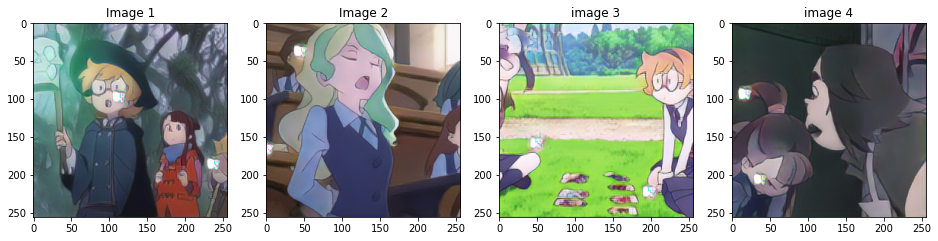

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot67", "shot165", "shot193", "shot244"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

In [ ]:
color_network.save('saved_model/color')

INFO:tensorflow:Assets written to: saved_model/color/assets


In [ ]:
!zip -rq saved_model.zip saved_model

In [ ]:
!rm -rf saved_model

## Train with spectral normalization

In [ ]:
epochs = 50
train()

 Epoch 01/50 | Step 85/85 | Loss: 35.12202 | Discriminator loss: 1.33625 | Generator loss: 33.78577 | Epoch Time: 143.46
 Epoch 02/50 | Step 85/85 | Loss: 33.50363 | Discriminator loss: 1.15402 | Generator loss: 32.34961 | Epoch Time: 115.26
 Epoch 03/50 | Step 85/85 | Loss: 34.58671 | Discriminator loss: 1.00223 | Generator loss: 33.58448 | Epoch Time: 114.89
 Epoch 04/50 | Step 85/85 | Loss: 29.69180 | Discriminator loss: 1.05325 | Generator loss: 28.63855 | Epoch Time: 114.80
 Epoch 05/50 | Step 85/85 | Loss: 28.68944 | Discriminator loss: 1.08749 | Generator loss: 27.60195 | Epoch Time: 114.84
 Epoch 06/50 | Step 85/85 | Loss: 29.79145 | Discriminator loss: 1.14249 | Generator loss: 28.64896 | Epoch Time: 114.67
 Epoch 07/50 | Step 85/85 | Loss: 31.17983 | Discriminator loss: 1.12647 | Generator loss: 30.05336 | Epoch Time: 114.66
 Epoch 08/50 | Step 85/85 | Loss: 30.92363 | Discriminator loss: 1.21378 | Generator loss: 29.70985 | Epoch Time: 114.61
 Epoch 09/50 | Step 85/85 | Loss

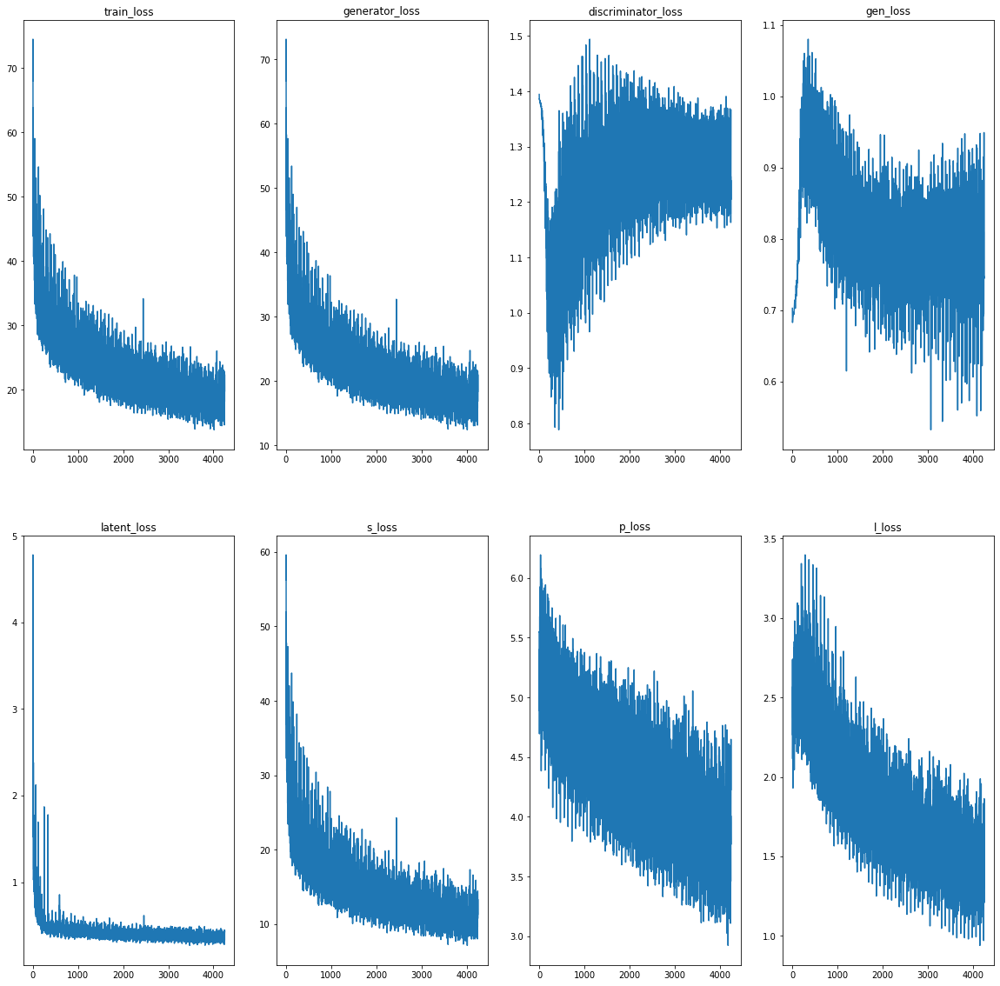

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, latent_loss_results, s_loss_results, p_loss_results, l_loss_results)

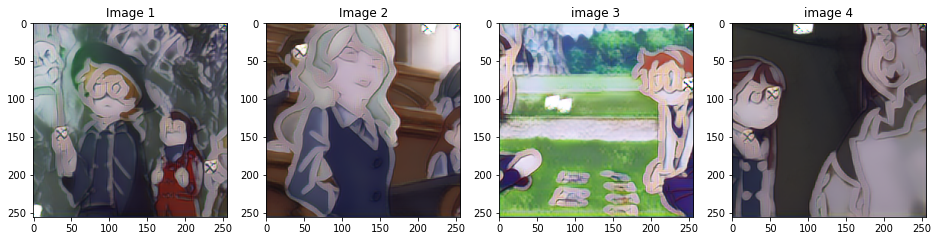

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot67", "shot165", "shot193", "shot244"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

In [ ]:
train()

 Epoch 01/50 | Step 85/85 | Loss: 20.36557 | Discriminator loss: 1.28497 | Generator loss: 19.08060 | Epoch Time: 114.54
 Epoch 02/50 | Step 85/85 | Loss: 18.75993 | Discriminator loss: 1.36268 | Generator loss: 17.39725 | Epoch Time: 113.67
 Epoch 03/50 | Step 85/85 | Loss: 20.47683 | Discriminator loss: 1.27440 | Generator loss: 19.20243 | Epoch Time: 113.28
 Epoch 04/50 | Step 85/85 | Loss: 20.33255 | Discriminator loss: 1.28740 | Generator loss: 19.04515 | Epoch Time: 113.16
 Epoch 05/50 | Step 85/85 | Loss: 18.82081 | Discriminator loss: 1.31208 | Generator loss: 17.50873 | Epoch Time: 112.86
 Epoch 06/50 | Step 85/85 | Loss: 18.63640 | Discriminator loss: 1.37320 | Generator loss: 17.26320 | Epoch Time: 113.06
 Epoch 07/50 | Step 85/85 | Loss: 19.14646 | Discriminator loss: 1.32760 | Generator loss: 17.81886 | Epoch Time: 113.29
 Epoch 08/50 | Step 85/85 | Loss: 18.44141 | Discriminator loss: 1.31925 | Generator loss: 17.12216 | Epoch Time: 113.31
 Epoch 09/50 | Step 85/85 | Loss

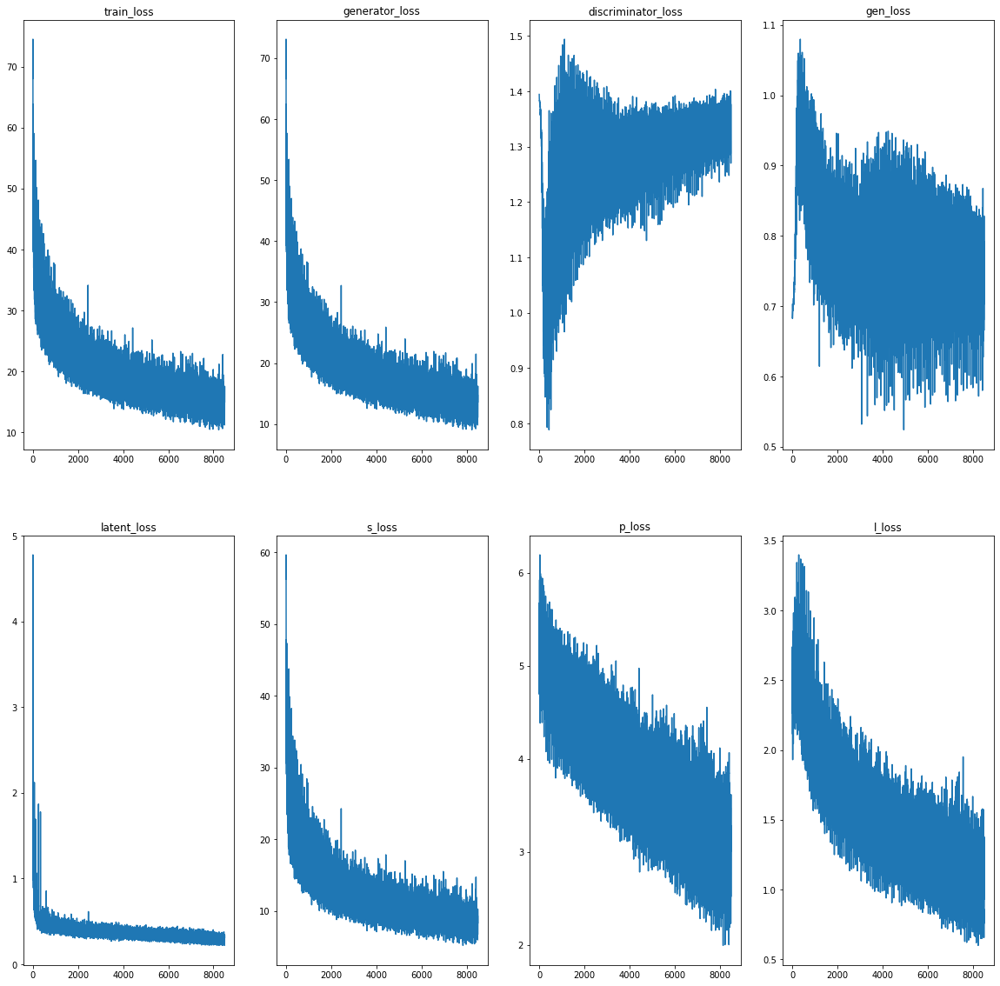

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, latent_loss_results, s_loss_results, p_loss_results, l_loss_results)

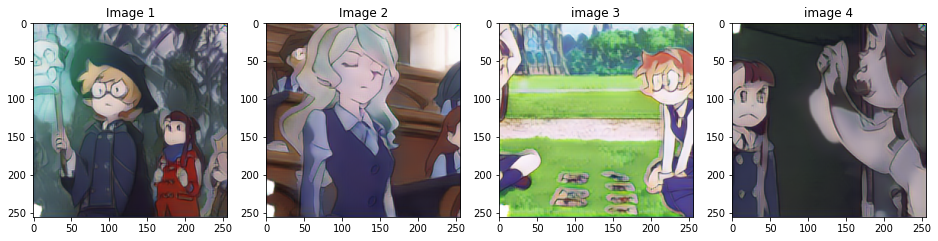

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot67", "shot165", "shot193", "shot244"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

In [ ]:
train()

 Epoch 01/50 | Step 85/85 | Loss: 18.15558 | Discriminator loss: 1.34515 | Generator loss: 16.81043 | Epoch Time: 114.10
 Epoch 02/50 | Step 85/85 | Loss: 18.36393 | Discriminator loss: 1.34711 | Generator loss: 17.01682 | Epoch Time: 114.05
 Epoch 03/50 | Step 85/85 | Loss: 13.98374 | Discriminator loss: 1.36602 | Generator loss: 12.61772 | Epoch Time: 113.53
 Epoch 04/50 | Step 85/85 | Loss: 14.53069 | Discriminator loss: 1.35721 | Generator loss: 13.17349 | Epoch Time: 114.55
 Epoch 05/50 | Step 85/85 | Loss: 15.99543 | Discriminator loss: 1.31792 | Generator loss: 14.67751 | Epoch Time: 113.89
 Epoch 06/50 | Step 85/85 | Loss: 14.19801 | Discriminator loss: 1.34061 | Generator loss: 12.85740 | Epoch Time: 114.01
 Epoch 07/50 | Step 85/85 | Loss: 14.99108 | Discriminator loss: 1.36515 | Generator loss: 13.62593 | Epoch Time: 114.00
 Epoch 08/50 | Step 85/85 | Loss: 17.92195 | Discriminator loss: 1.32783 | Generator loss: 16.59412 | Epoch Time: 113.24
 Epoch 09/50 | Step 85/85 | Loss

In [ ]:
epochs = 10
train()

 Epoch 01/10 | Step 85/85 | Loss: 15.29807 | Discriminator loss: 1.30588 | Generator loss: 13.99219 | Epoch Time: 115.79
 Epoch 02/10 | Step 85/85 | Loss: 14.46211 | Discriminator loss: 1.35324 | Generator loss: 13.10888 | Epoch Time: 115.60
 Epoch 03/10 | Step 85/85 | Loss: 15.23349 | Discriminator loss: 1.34867 | Generator loss: 13.88482 | Epoch Time: 115.71
 Epoch 04/10 | Step 85/85 | Loss: 15.52100 | Discriminator loss: 1.34588 | Generator loss: 14.17512 | Epoch Time: 115.65
 Epoch 05/10 | Step 85/85 | Loss: 17.40777 | Discriminator loss: 1.37020 | Generator loss: 16.03757 | Epoch Time: 115.60
 Epoch 06/10 | Step 85/85 | Loss: 16.34800 | Discriminator loss: 1.32172 | Generator loss: 15.02627 | Epoch Time: 115.75
 Epoch 07/10 | Step 85/85 | Loss: 14.57809 | Discriminator loss: 1.35017 | Generator loss: 13.22792 | Epoch Time: 115.62
 Epoch 08/10 | Step 85/85 | Loss: 12.30137 | Discriminator loss: 1.37194 | Generator loss: 10.92943 | Epoch Time: 115.43
 Epoch 09/10 | Step 85/85 | Loss

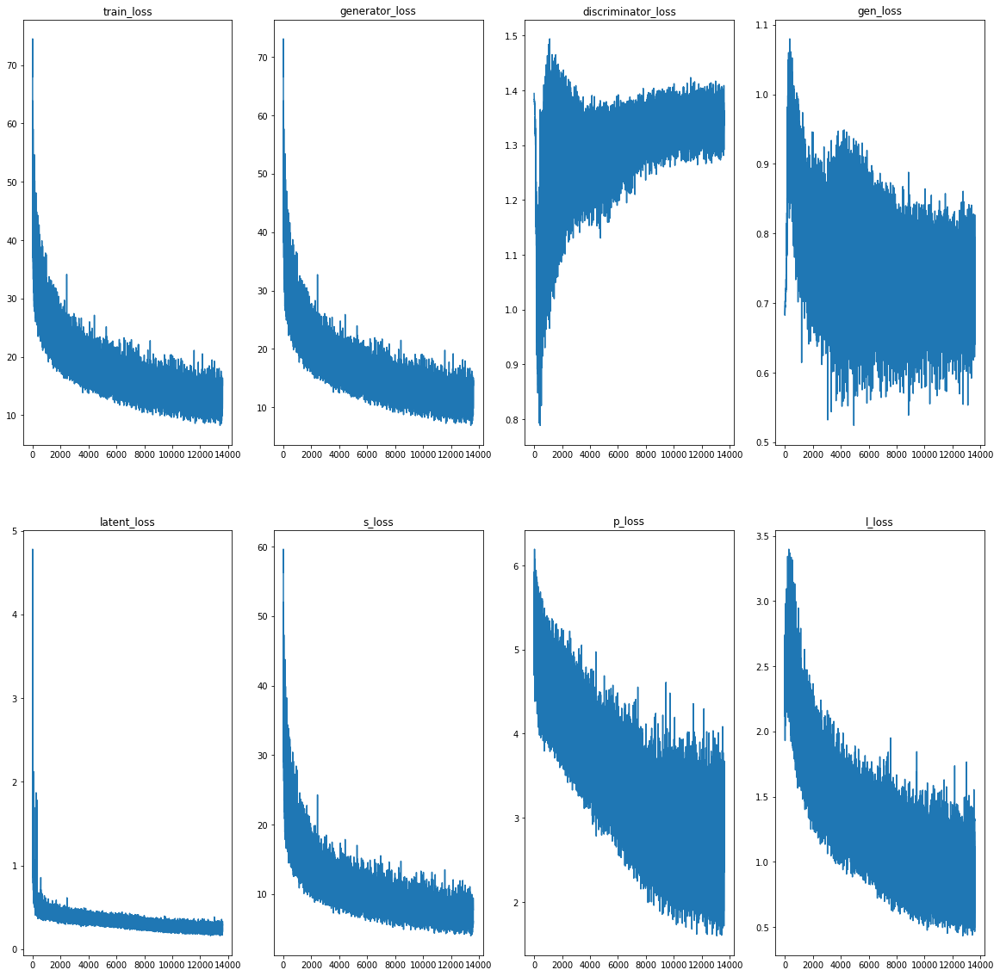

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, latent_loss_results, s_loss_results, p_loss_results, l_loss_results)

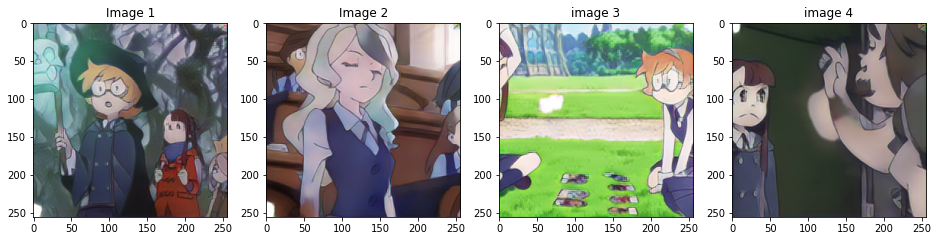

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot67", "shot165", "shot193", "shot244"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

In [ ]:
epochs = 40
train()

 Epoch 01/40 | Step 85/85 | Loss: 12.08448 | Discriminator loss: 1.33658 | Generator loss: 10.74789 | Epoch Time: 137.42
 Epoch 02/40 | Step 85/85 | Loss: 11.75990 | Discriminator loss: 1.32909 | Generator loss: 10.43081 | Epoch Time: 111.79
 Epoch 03/40 | Step 85/85 | Loss: 12.23102 | Discriminator loss: 1.34989 | Generator loss: 10.88113 | Epoch Time: 111.93
 Epoch 04/40 | Step 85/85 | Loss: 13.07078 | Discriminator loss: 1.33391 | Generator loss: 11.73686 | Epoch Time: 111.76
 Epoch 05/40 | Step 85/85 | Loss: 12.40286 | Discriminator loss: 1.34250 | Generator loss: 11.06036 | Epoch Time: 112.10
 Epoch 06/40 | Step 85/85 | Loss: 10.84509 | Discriminator loss: 1.33418 | Generator loss: 9.51092 | Epoch Time: 111.98
 Epoch 07/40 | Step 85/85 | Loss: 10.62724 | Discriminator loss: 1.33421 | Generator loss: 9.29303 | Epoch Time: 111.70
 Epoch 08/40 | Step 85/85 | Loss: 11.24543 | Discriminator loss: 1.35596 | Generator loss: 9.88947 | Epoch Time: 111.68
 Epoch 09/40 | Step 85/85 | Loss: 1

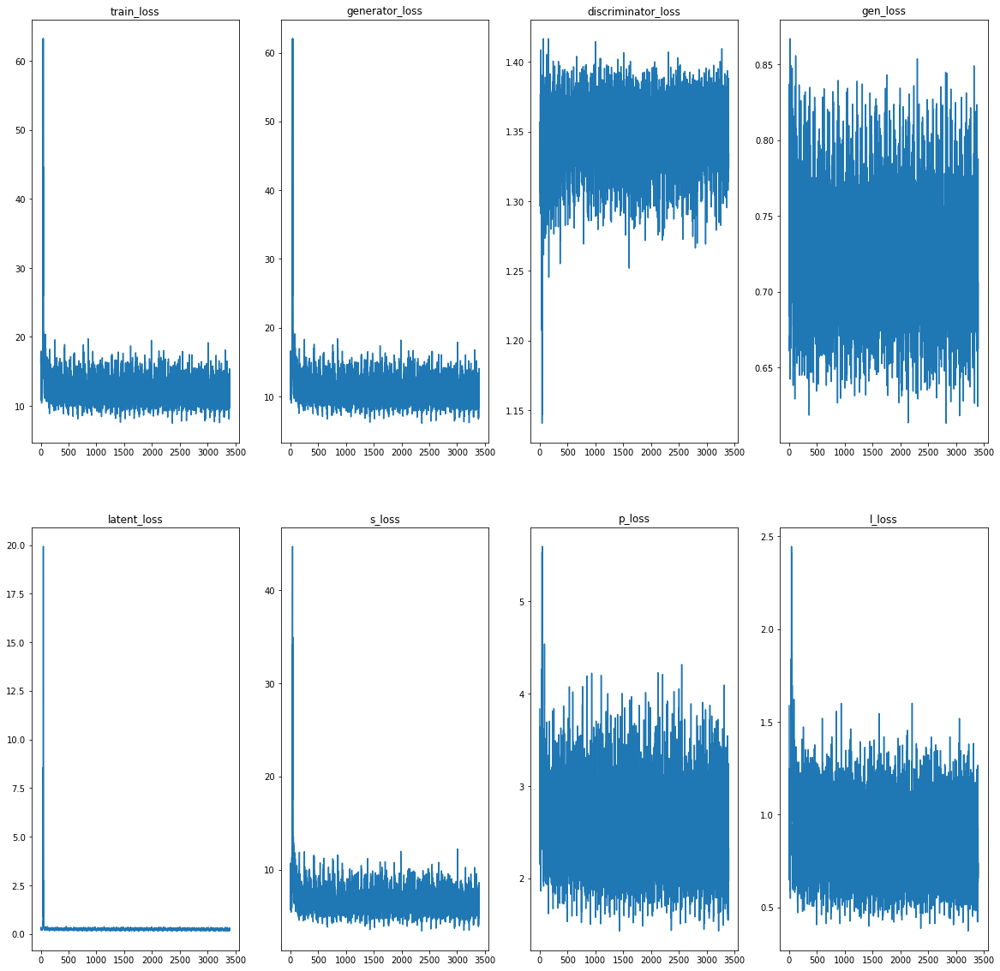

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, latent_loss_results, s_loss_results, p_loss_results, l_loss_results)

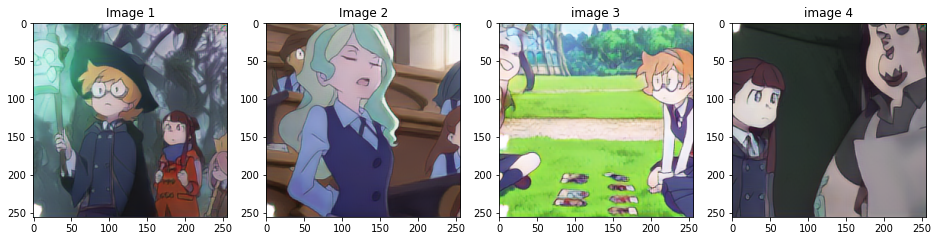

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot67", "shot165", "shot193", "shot244"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

In [ ]:
epochs = 50
train()

 Epoch 01/50 | Step 85/85 | Loss: 12.51746 | Discriminator loss: 1.33827 | Generator loss: 11.17919 | Epoch Time: 112.88
 Epoch 02/50 | Step 85/85 | Loss: 12.05102 | Discriminator loss: 1.34675 | Generator loss: 10.70427 | Epoch Time: 112.31
 Epoch 03/50 | Step 85/85 | Loss: 10.04946 | Discriminator loss: 1.35732 | Generator loss: 8.69213 | Epoch Time: 112.34
 Epoch 04/50 | Step 85/85 | Loss: 11.08456 | Discriminator loss: 1.32943 | Generator loss: 9.75513 | Epoch Time: 112.09
 Epoch 05/50 | Step 85/85 | Loss: 11.26478 | Discriminator loss: 1.33214 | Generator loss: 9.93265 | Epoch Time: 112.22
 Epoch 06/50 | Step 85/85 | Loss: 10.23623 | Discriminator loss: 1.35887 | Generator loss: 8.87737 | Epoch Time: 112.30
 Epoch 07/50 | Step 85/85 | Loss: 12.07175 | Discriminator loss: 1.33122 | Generator loss: 10.74053 | Epoch Time: 112.55
 Epoch 08/50 | Step 85/85 | Loss: 9.96183 | Discriminator loss: 1.33485 | Generator loss: 8.62698 | Epoch Time: 112.72
 Epoch 09/50 | Step 85/85 | Loss: 12.2

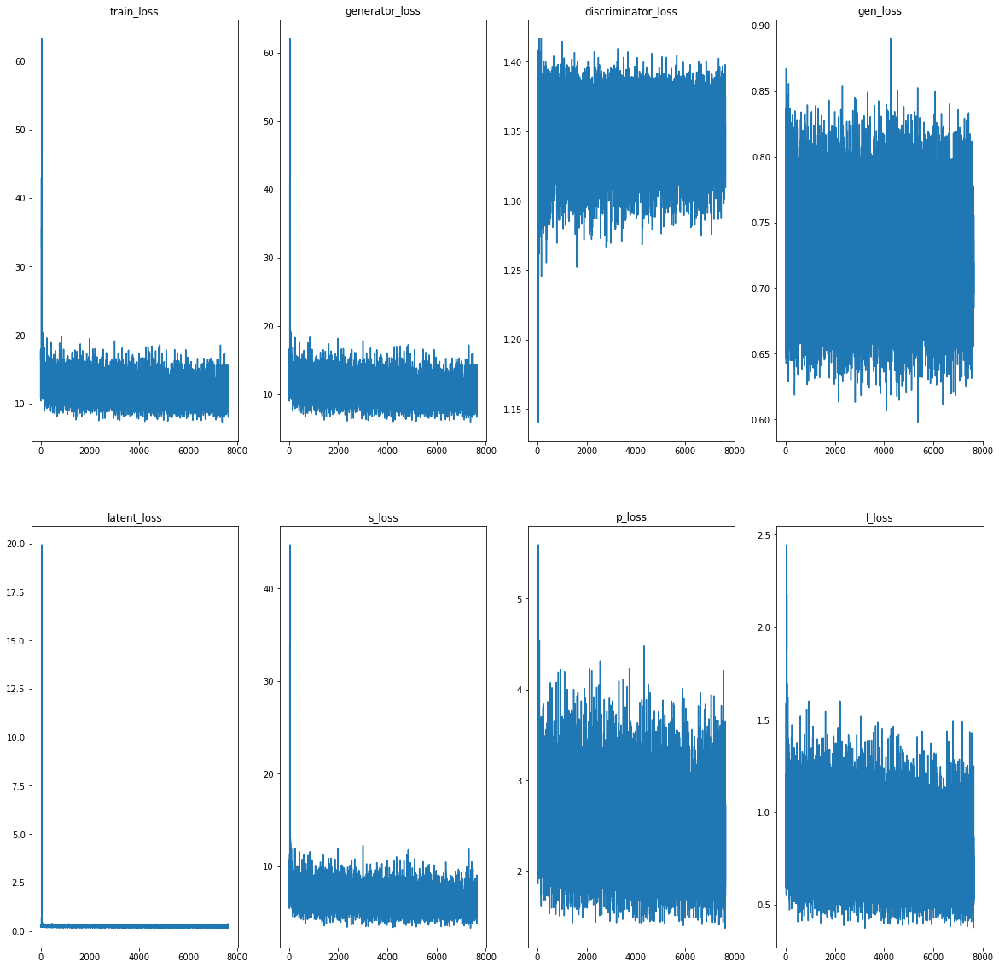

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, latent_loss_results, s_loss_results, p_loss_results, l_loss_results)

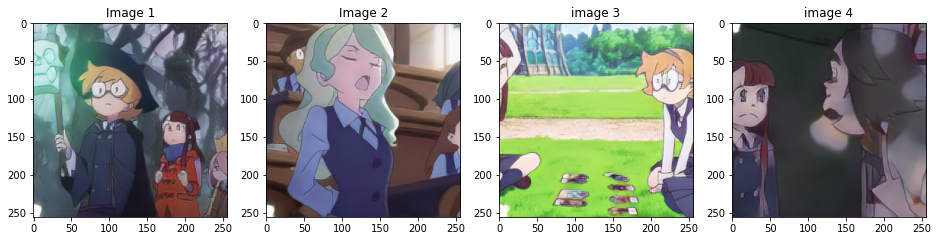

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot67", "shot165", "shot193", "shot244"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

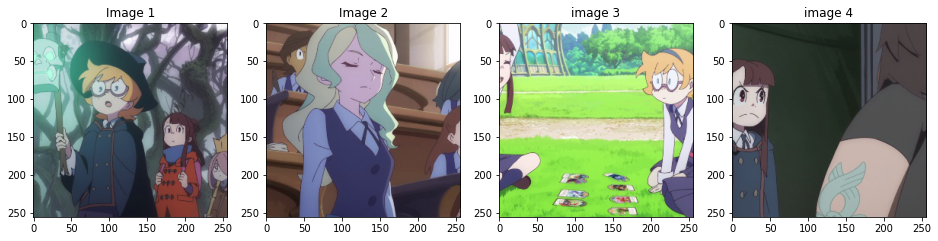

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot67", "shot165", "shot193", "shot244"])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(middle[0][0])

ax[1].set_title("Image 2")
ax[1].imshow(middle[0][1])

ax[2].set_title("image 3")
ax[2].imshow(middle[0][2])

ax[3].set_title("image 4")
ax[3].imshow(middle[0][3])

In [ ]:
# !rm -rf training_checkpoints/

In [ ]:
epochs = 50
train()

 Epoch 01/50 | Step 85/85 | Loss: 12.47287 | Discriminator loss: 1.33548 | Generator loss: 11.13739 | Epoch Time: 110.91
 Epoch 02/50 | Step 85/85 | Loss: 10.32386 | Discriminator loss: 1.33909 | Generator loss: 8.98477 | Epoch Time: 110.81
 Epoch 03/50 | Step 85/85 | Loss: 11.19572 | Discriminator loss: 1.35147 | Generator loss: 9.84425 | Epoch Time: 111.16
 Epoch 04/50 | Step 85/85 | Loss: 10.79264 | Discriminator loss: 1.34638 | Generator loss: 9.44626 | Epoch Time: 111.11
 Epoch 05/50 | Step 85/85 | Loss: 10.64837 | Discriminator loss: 1.36383 | Generator loss: 9.28455 | Epoch Time: 111.31
 Epoch 06/50 | Step 85/85 | Loss: 9.03629 | Discriminator loss: 1.34924 | Generator loss: 7.68705 | Epoch Time: 111.86
 Epoch 07/50 | Step 85/85 | Loss: 9.72849 | Discriminator loss: 1.34158 | Generator loss: 8.38690 | Epoch Time: 111.79
 Epoch 08/50 | Step 85/85 | Loss: 10.44885 | Discriminator loss: 1.35438 | Generator loss: 9.09447 | Epoch Time: 112.18
 Epoch 09/50 | Step 85/85 | Loss: 9.88306

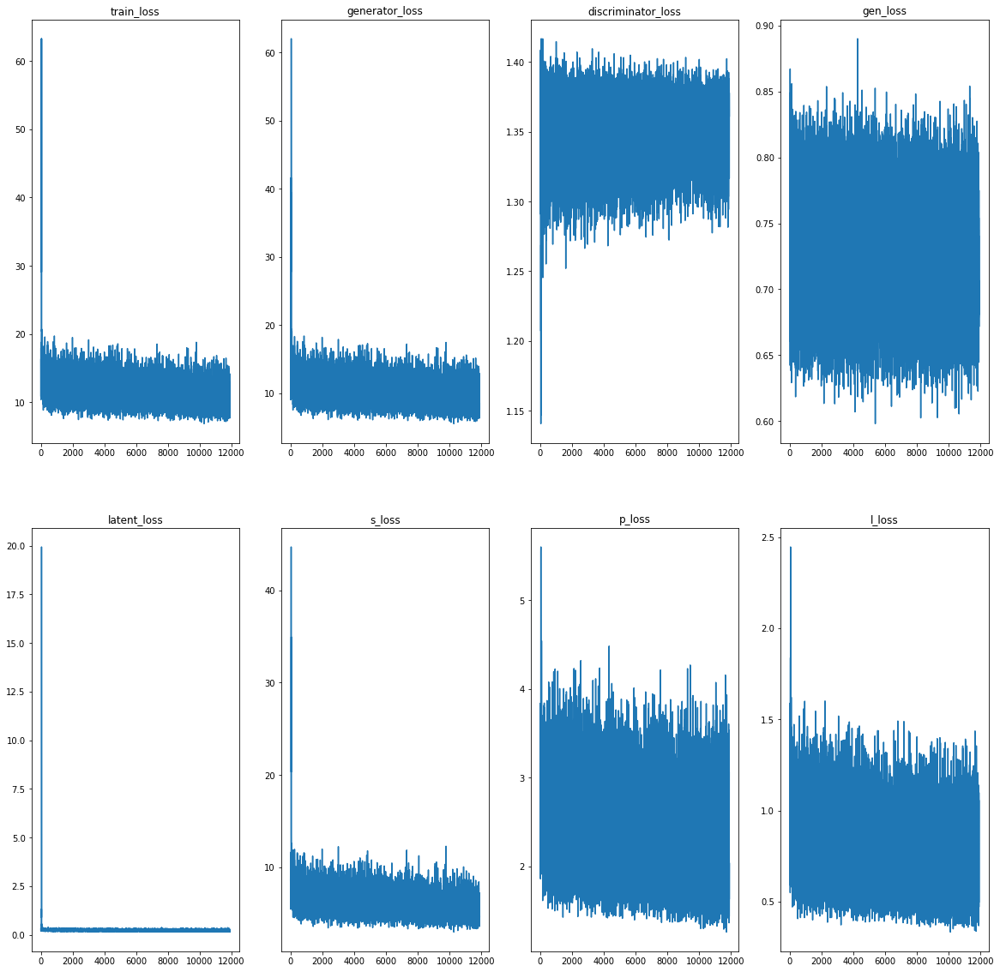

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, latent_loss_results, s_loss_results, p_loss_results, l_loss_results)

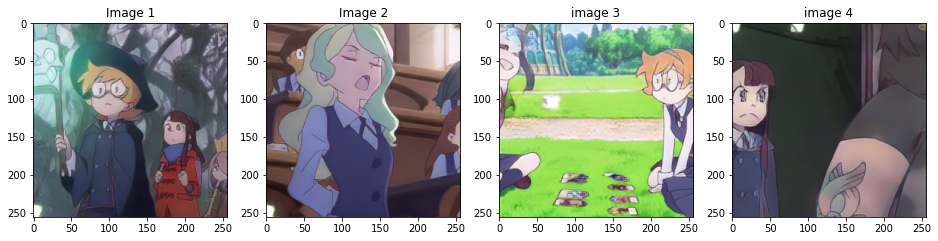

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot67", "shot165", "shot193", "shot244"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

In [ ]:
train()

 Epoch 01/50 | Step 85/85 | Loss: 9.89728 | Discriminator loss: 1.35183 | Generator loss: 8.54546 | Epoch Time: 109.69
 Epoch 02/50 | Step 85/85 | Loss: 9.44207 | Discriminator loss: 1.35713 | Generator loss: 8.08494 | Epoch Time: 111.02
 Epoch 03/50 | Step 85/85 | Loss: 10.40608 | Discriminator loss: 1.35847 | Generator loss: 9.04761 | Epoch Time: 111.18
 Epoch 04/50 | Step 85/85 | Loss: 12.01284 | Discriminator loss: 1.34889 | Generator loss: 10.66395 | Epoch Time: 111.29
 Epoch 05/50 | Step 85/85 | Loss: 9.06180 | Discriminator loss: 1.35861 | Generator loss: 7.70319 | Epoch Time: 111.25
 Epoch 06/50 | Step 85/85 | Loss: 12.47456 | Discriminator loss: 1.32829 | Generator loss: 11.14627 | Epoch Time: 111.97
 Epoch 07/50 | Step 85/85 | Loss: 9.62763 | Discriminator loss: 1.33720 | Generator loss: 8.29044 | Epoch Time: 111.94
 Epoch 08/50 | Step 85/85 | Loss: 10.21629 | Discriminator loss: 1.35154 | Generator loss: 8.86475 | Epoch Time: 112.01
 Epoch 09/50 | Step 85/85 | Loss: 12.47235

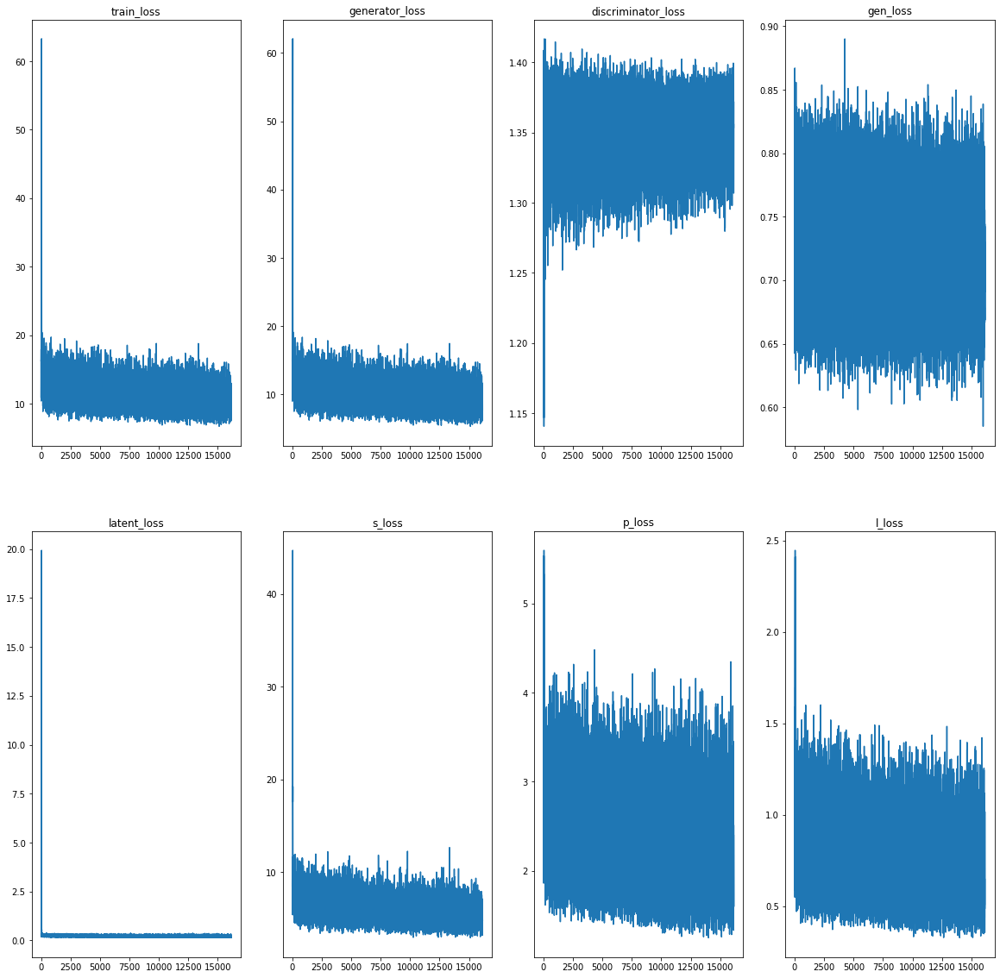

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, latent_loss_results, s_loss_results, p_loss_results, l_loss_results)

In paper "Analyzing and Improving the Image Quality of StyleGAN" they solve the same problem by changing instance normalization to weight demodulation.

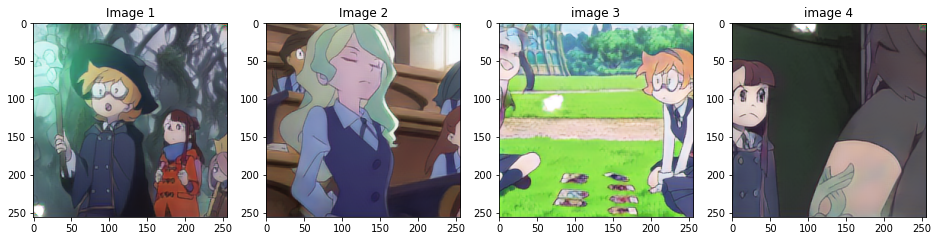

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot67", "shot165", "shot193", "shot244"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

In [ ]:
epochs = 50
train()

 Epoch 01/50 | Step 85/85 | Loss: 7.71331 | Discriminator loss: 1.38612 | Generator loss: 6.32718 | Epoch Time: 136.53
 Epoch 02/50 | Step 85/85 | Loss: 9.30698 | Discriminator loss: 1.37119 | Generator loss: 7.93579 | Epoch Time: 112.50
 Epoch 03/50 | Step 85/85 | Loss: 8.81465 | Discriminator loss: 1.37855 | Generator loss: 7.43610 | Epoch Time: 112.45
 Epoch 04/50 | Step 85/85 | Loss: 8.68641 | Discriminator loss: 1.35826 | Generator loss: 7.32815 | Epoch Time: 112.64
 Epoch 05/50 | Step 85/85 | Loss: 7.99634 | Discriminator loss: 1.38122 | Generator loss: 6.61511 | Epoch Time: 112.43
 Epoch 06/50 | Step 85/85 | Loss: 8.77125 | Discriminator loss: 1.37243 | Generator loss: 7.39881 | Epoch Time: 112.76
 Epoch 07/50 | Step 85/85 | Loss: 8.76771 | Discriminator loss: 1.38293 | Generator loss: 7.38478 | Epoch Time: 112.84
 Epoch 08/50 | Step 85/85 | Loss: 9.33321 | Discriminator loss: 1.35729 | Generator loss: 7.97592 | Epoch Time: 112.79
 Epoch 09/50 | Step 85/85 | Loss: 8.81355 | Disc

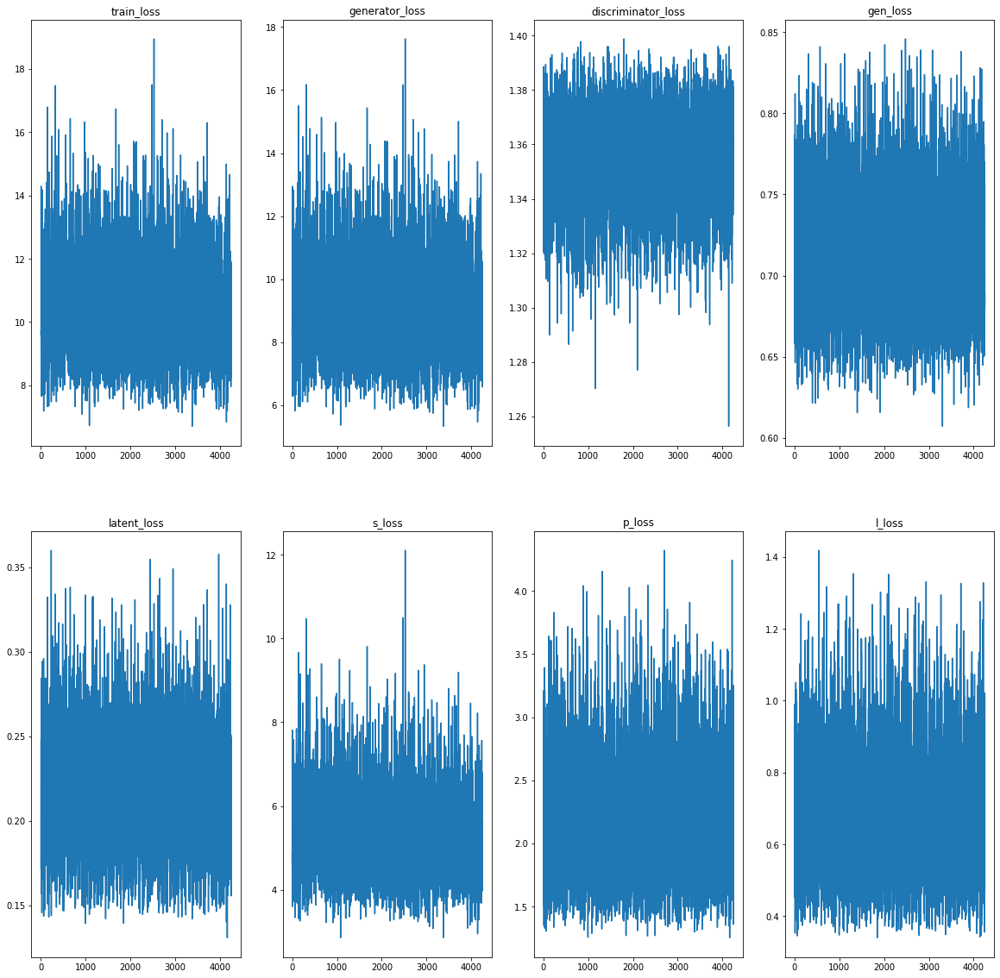

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, latent_loss_results, s_loss_results, p_loss_results, l_loss_results)

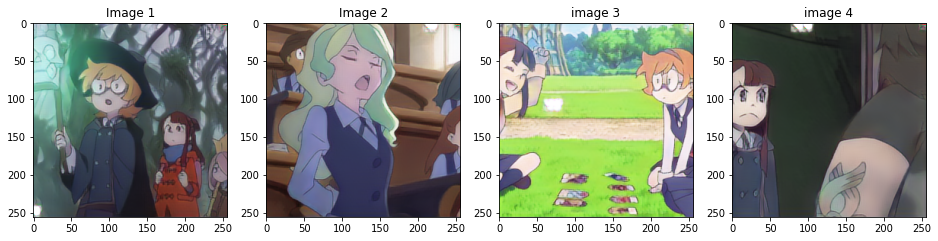

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot67", "shot165", "shot193", "shot244"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

In [ ]:
train()

 Epoch 01/50 | Step 85/85 | Loss: 7.88836 | Discriminator loss: 1.38805 | Generator loss: 6.50031 | Epoch Time: 112.58
 Epoch 02/50 | Step 85/85 | Loss: 8.76877 | Discriminator loss: 1.38422 | Generator loss: 7.38455 | Epoch Time: 113.04
 Epoch 03/50 | Step 85/85 | Loss: 7.77729 | Discriminator loss: 1.37051 | Generator loss: 6.40678 | Epoch Time: 112.49
 Epoch 04/50 | Step 85/85 | Loss: 8.11949 | Discriminator loss: 1.37831 | Generator loss: 6.74118 | Epoch Time: 112.74
 Epoch 05/50 | Step 85/85 | Loss: 8.65323 | Discriminator loss: 1.37722 | Generator loss: 7.27600 | Epoch Time: 112.69
 Epoch 06/50 | Step 85/85 | Loss: 7.82396 | Discriminator loss: 1.36684 | Generator loss: 6.45712 | Epoch Time: 112.93
 Epoch 07/50 | Step 85/85 | Loss: 8.55133 | Discriminator loss: 1.36947 | Generator loss: 7.18186 | Epoch Time: 112.59
 Epoch 08/50 | Step 85/85 | Loss: 7.34280 | Discriminator loss: 1.37274 | Generator loss: 5.97006 | Epoch Time: 112.74
 Epoch 09/50 | Step 85/85 | Loss: 8.99942 | Disc

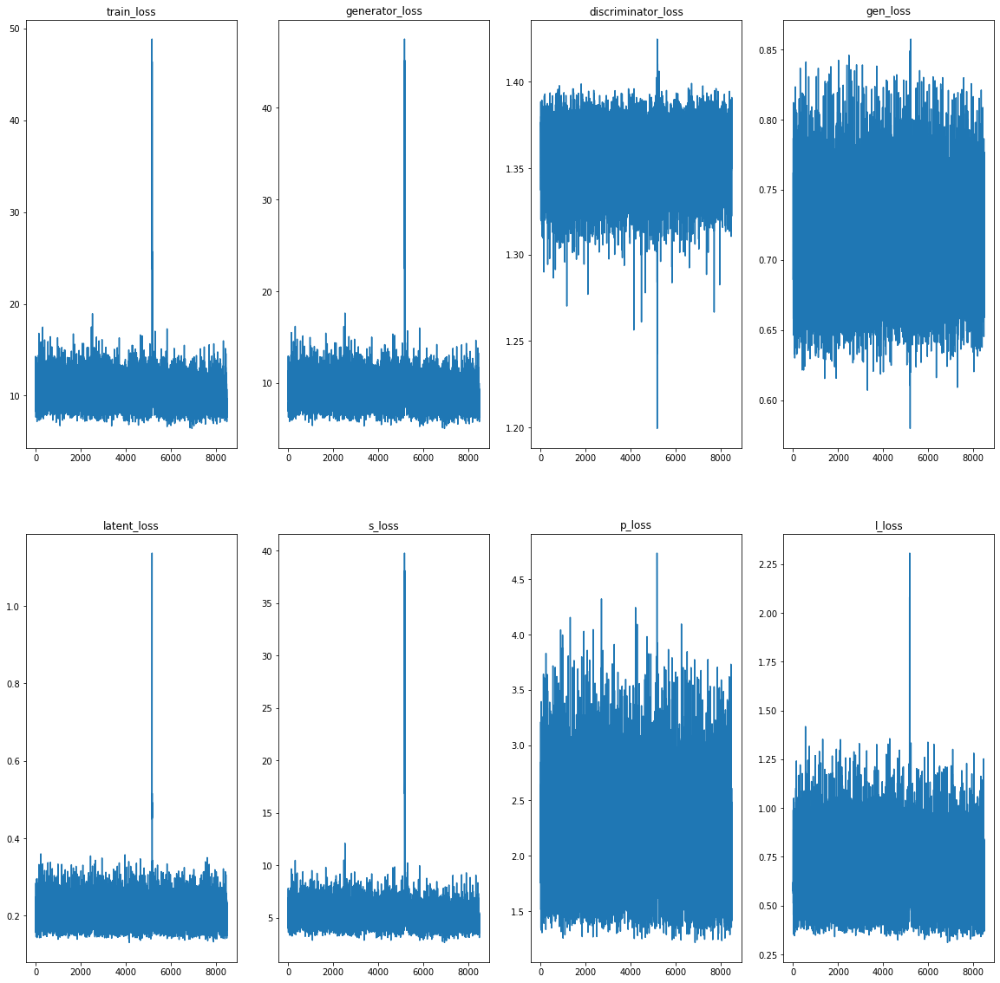

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, latent_loss_results, s_loss_results, p_loss_results, l_loss_results)

## Export 3 part Model

In [ ]:
# first part model

def create_first_part_model():
  target_line_art_input = tf.keras.Input(shape=(256, 256, 3))
  target_distance_input = tf.keras.Input(shape=(256, 256, 3))
  reference_color_0_input = tf.keras.Input(shape=(256, 256, 3))
  reference_line_art_0_input = tf.keras.Input(shape=(256, 256, 3))
  reference_distance_0_input = tf.keras.Input(shape=(256, 256, 3))
  reference_color_1_input = tf.keras.Input(shape=(256, 256, 3))
  reference_line_art_1_input = tf.keras.Input(shape=(256, 256, 3))
  reference_distance_1_input = tf.keras.Input(shape=(256, 256, 3))

  # line art encoder

  target_line_art_images_features = color_network.layers[1](target_line_art_input)

  # distance map encoder
  target_distance_maps_features =  color_network.layers[2](target_distance_input) # EnD

  reference_distance_maps_0_features =  color_network.layers[2](reference_distance_0_input) # EnD
  reference_distance_maps_1_features =  color_network.layers[2](reference_distance_1_input) # EnD

  # color encoder

  reference_color_images_0_features = color_network.layers[0](reference_color_0_input)
  reference_color_images_1_features = color_network.layers[0](reference_color_1_input)

  # color transform layer

  f_sim = color_network.layers[3]([target_distance_maps_features,
                                  reference_distance_maps_0_features,
                                  reference_distance_maps_1_features,
                                  reference_color_images_0_features,
                                  reference_color_images_1_features])
  

  # SEV
  style_vector = color_network.layers[4]([reference_line_art_0_input,
                            reference_color_0_input,
                            reference_line_art_1_input,
                            reference_color_1_input])
  # SIM output

  Y_trans_sim = color_network.layers[13](f_sim)
  Y_trans_sim = layers.UpSampling2D(size=(2, 2))(Y_trans_sim)
  Y_trans_sim = layers.UpSampling2D(size=(2, 2))(Y_trans_sim)
  
  res_input = layers.add([target_line_art_images_features, f_sim])

  inputs = [target_line_art_input,
            target_distance_input,
            reference_color_0_input,
            reference_line_art_0_input,
            reference_distance_0_input,
            reference_color_1_input,
            reference_line_art_1_input,
            reference_distance_1_input]

  outputs = [Y_trans_sim, res_input, style_vector]

  model = tf.keras.Model(inputs=[*inputs], outputs=[*outputs])

  return model

In [ ]:
first_part_model = create_first_part_model()

In [ ]:
Y_trans_sim, res_input, style_vector = first_part_model([middle[1], middle[2],
                                                        reference_0[0], reference_0[1],
                                                        reference_0[2], reference_1[0], 
                                                        reference_1[1], reference_1[2]])

In [ ]:
Y_trans_sim.shape, res_input.shape, style_vector.shape

(TensorShape([4, 256, 256, 3]),
 TensorShape([4, 64, 64, 256]),
 TensorShape([4, 1, 1, 512]))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


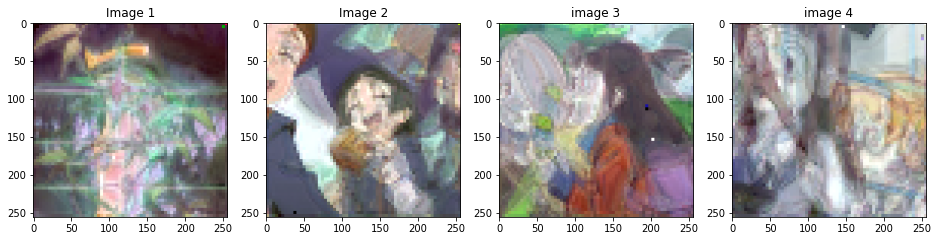

In [ ]:
_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(Y_trans_sim[0])

ax[1].set_title("Image 2")
ax[1].imshow(Y_trans_sim[1])

ax[2].set_title("image 3")
ax[2].imshow(Y_trans_sim[2])

ax[3].set_title("image 4")
ax[3].imshow(Y_trans_sim[3])

In [ ]:
color_network.layers[5].layers

In [ ]:
# second part model

def create_second_part_model():
  res_input = tf.keras.Input(shape=(64, 64, 256))
  style_vector = tf.keras.Input(shape=(1, 1, 512))

  x = color_network.layers[5]([res_input, style_vector])
  x = color_network.layers[6]([x, style_vector])
  x = color_network.layers[7]([x, style_vector])
  x = color_network.layers[8]([x, style_vector])
  x = color_network.layers[9]([x, style_vector])
  x = color_network.layers[10]([x, style_vector])
  x = color_network.layers[11]([x, style_vector])
  x = color_network.layers[12]([x, style_vector])

  Y_trans_mid = color_network.layers[14](x)
  Y_trans_mid = layers.UpSampling2D(size=(2, 2))(Y_trans_mid)
  Y_trans_mid = layers.UpSampling2D(size=(2, 2))(Y_trans_mid)

  inputs = [res_input,
            style_vector]

  outputs = [Y_trans_mid, x]

  model = tf.keras.Model(inputs=[*inputs], outputs=[*outputs])

  return model

In [ ]:
second_part_model = create_second_part_model()

In [ ]:
Y_trans_mid, x = second_part_model([res_input, style_vector])

In [ ]:
Y_trans_mid.shape, x.shape

(TensorShape([4, 256, 256, 3]), TensorShape([4, 64, 64, 256]))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


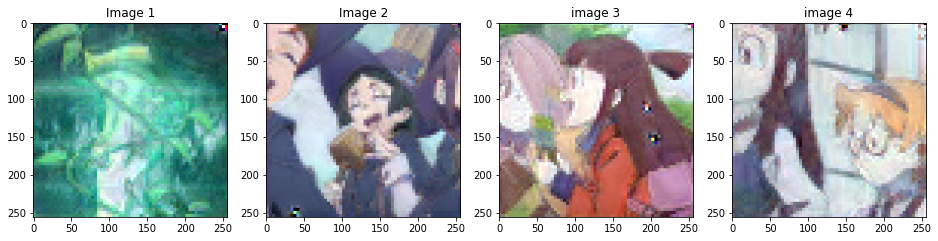

In [ ]:
_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(Y_trans_mid[0])

ax[1].set_title("Image 2")
ax[1].imshow(Y_trans_mid[1])

ax[2].set_title("image 3")
ax[2].imshow(Y_trans_mid[2])

ax[3].set_title("image 4")
ax[3].imshow(Y_trans_mid[3])

In [ ]:
# third part model

def create_third_part_model():
  input = tf.keras.Input(shape=(64, 64, 256))

  x = color_network.layers[15](input)

  model = tf.keras.Model(inputs=[input], outputs=[x])

  return model

In [ ]:
third_part_model = create_third_part_model()

In [ ]:
y_trans = third_part_model(x)

In [ ]:
y_trans.shape

TensorShape([4, 256, 256, 3])

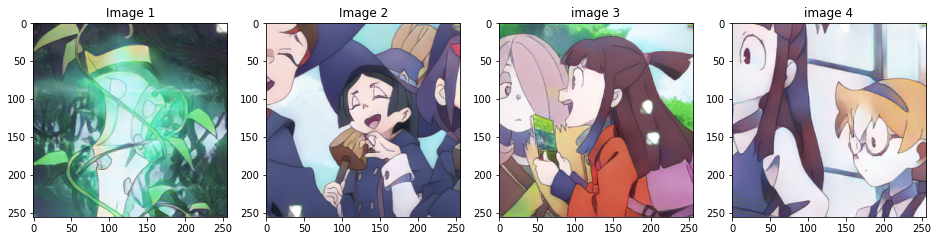

In [ ]:
_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

In [ ]:
first_part_model.save('saved_model/first_part_model')

INFO:tensorflow:Assets written to: saved_model/first_part_model/assets


In [ ]:
second_part_model.save('saved_model/second_part_model')

INFO:tensorflow:Assets written to: saved_model/second_part_model/assets


In [ ]:
third_part_model.save('saved_model/third_part_model')

INFO:tensorflow:Assets written to: saved_model/third_part_model/assets


In [ ]:
color_network.save("saved_model/color", include_optimizer=False)

INFO:tensorflow:Assets written to: saved_model/color/assets


INFO:tensorflow:Assets written to: saved_model/color/assets


In [ ]:
def create_complete_model():
  target_line_art_input = tf.keras.Input(shape=(256, 256, 3))
  target_distance_input = tf.keras.Input(shape=(256, 256, 3))
  reference_color_0_input = tf.keras.Input(shape=(256, 256, 3))
  reference_line_art_0_input = tf.keras.Input(shape=(256, 256, 3))
  reference_distance_0_input = tf.keras.Input(shape=(256, 256, 3))
  reference_color_1_input = tf.keras.Input(shape=(256, 256, 3))
  reference_line_art_1_input = tf.keras.Input(shape=(256, 256, 3))
  reference_distance_1_input = tf.keras.Input(shape=(256, 256, 3))

  # line art encoder

  target_line_art_images_features = color_network.layers[1](target_line_art_input)

  # distance map encoder
  target_distance_maps_features =  color_network.layers[2](target_distance_input) # EnD

  reference_distance_maps_0_features =  color_network.layers[2](reference_distance_0_input) # EnD
  reference_distance_maps_1_features =  color_network.layers[2](reference_distance_1_input) # EnD

  # color encoder

  reference_color_images_0_features = color_network.layers[0](reference_color_0_input)
  reference_color_images_1_features = color_network.layers[0](reference_color_1_input)

  # color transform layer

  f_sim = color_network.layers[3]([target_distance_maps_features,
                                  reference_distance_maps_0_features,
                                  reference_distance_maps_1_features,
                                  reference_color_images_0_features,
                                  reference_color_images_1_features])
  

  # SEV
  style_vector = color_network.layers[4]([reference_line_art_0_input,
                            reference_color_0_input,
                            reference_line_art_1_input,
                            reference_color_1_input])
  # SIM output

  Y_trans_sim = color_network.layers[13](f_sim)
  Y_trans_sim = layers.UpSampling2D(size=(2, 2))(Y_trans_sim)
  Y_trans_sim = layers.UpSampling2D(size=(2, 2))(Y_trans_sim)
  
  res_input = layers.add([target_line_art_images_features, f_sim])

  inputs = [target_line_art_input,
            target_distance_input,
            reference_color_0_input,
            reference_line_art_0_input,
            reference_distance_0_input,
            reference_color_1_input,
            reference_line_art_1_input,
            reference_distance_1_input]

  x = color_network.layers[5]([res_input, style_vector])
  x = color_network.layers[6]([x, style_vector])
  x = color_network.layers[7]([x, style_vector])
  x = color_network.layers[8]([x, style_vector])
  x = color_network.layers[9]([x, style_vector])
  x = color_network.layers[10]([x, style_vector])
  x = color_network.layers[11]([x, style_vector])
  x = color_network.layers[12]([x, style_vector])

  Y_trans_mid = color_network.layers[14](x)
  Y_trans_mid = layers.UpSampling2D(size=(2, 2))(Y_trans_mid)
  Y_trans_mid = layers.UpSampling2D(size=(2, 2))(Y_trans_mid)

  x = color_network.layers[15](x)

  outputs = [x, Y_trans_mid, Y_trans_sim]

  model = tf.keras.Model(inputs=[*inputs], outputs=[*outputs])

  return model

In [ ]:
color_network_complete = create_complete_model()

## 350 Tests

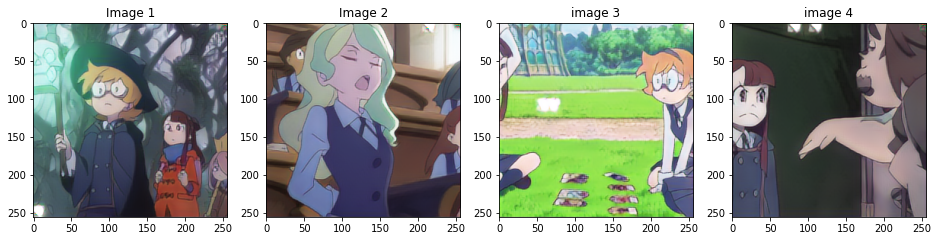

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot67", "shot165", "shot193", "shot244"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

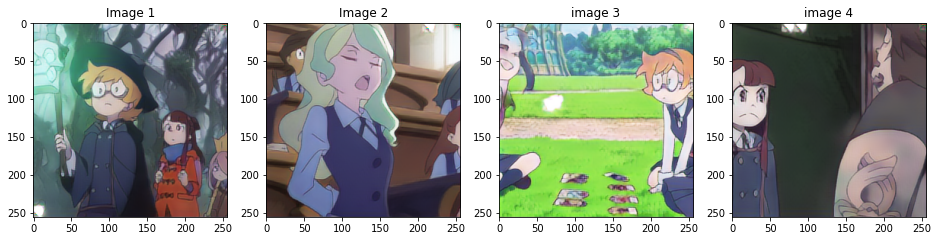

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot67", "shot165", "shot193", "shot244"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

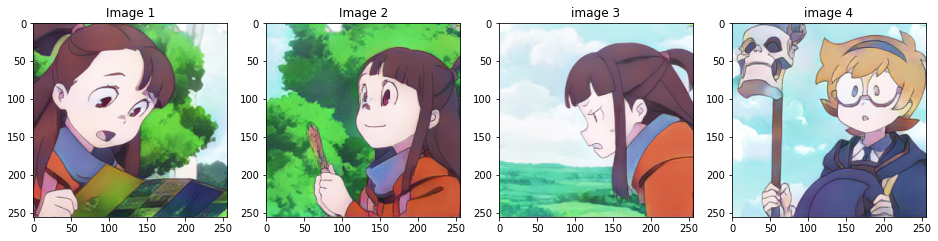

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot11", "shot22", "shot33", "shot44"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

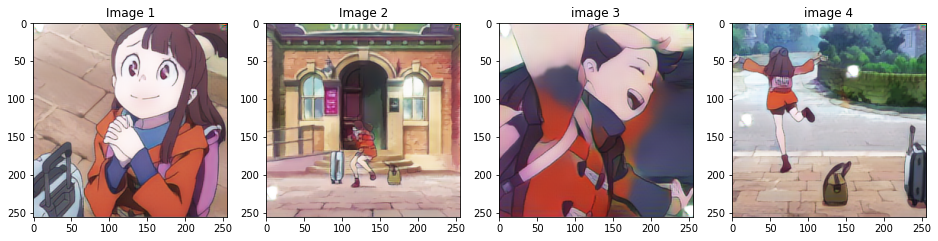

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot1", "shot2", "shot3", "shot4"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

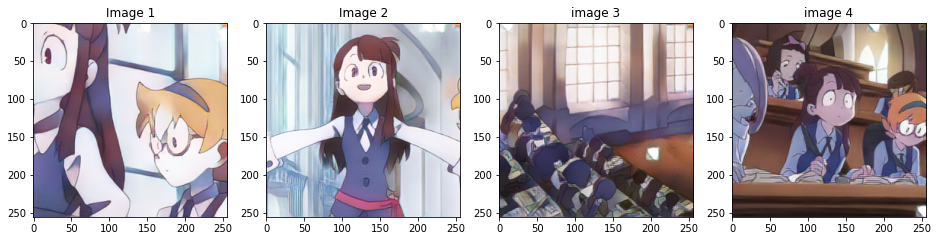

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot161", "shot162", "shot163", "shot164"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

## 450 Tests

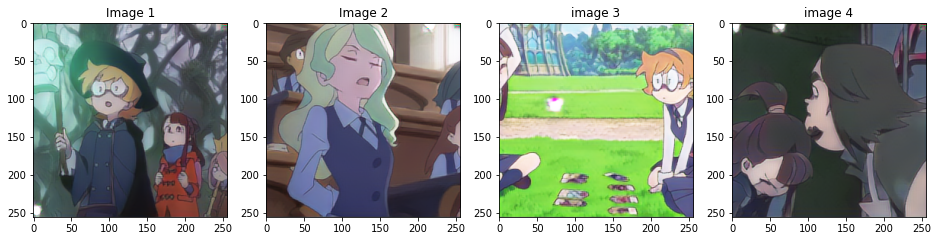

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot67", "shot165", "shot193", "shot244"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

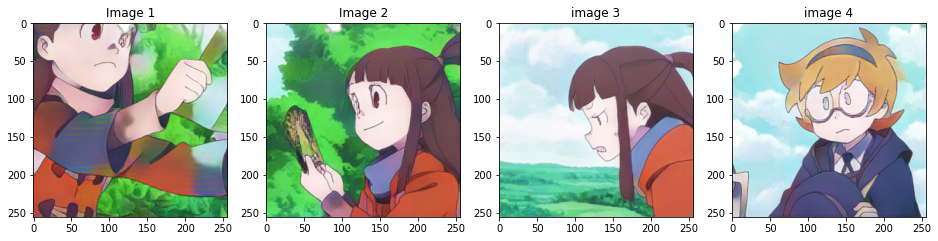

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot11", "shot22", "shot33", "shot44"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

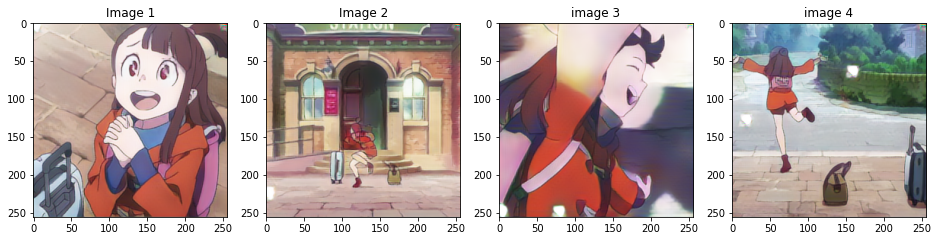

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot1", "shot2", "shot3", "shot4"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

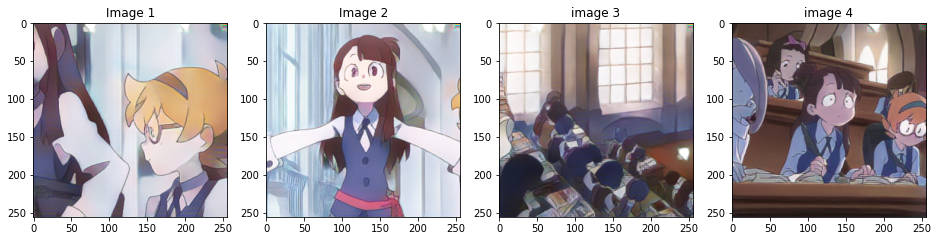

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot161", "shot162", "shot163", "shot164"])

y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

Decrese discriminator learning rate, change data generator to mimic the one in the paper

In [ ]:
from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 13163991215620526450, name: "/device:XLA_CPU:0"
 device_type: "XLA_CPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 10863949630544282303
 physical_device_desc: "device: XLA_CPU device", name: "/device:XLA_GPU:0"
 device_type: "XLA_GPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 4572807926990318523
 physical_device_desc: "device: XLA_GPU device", name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 14613293312
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 7960270241928457202
 physical_device_desc: "device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5"]

In [ ]:
reference_0.shape, middle.shape, reference_1.shape

In [ ]:
reference_0[2].shape

TensorShape([4, 256, 256, 3])

In [ ]:
# 3 different images
# 3 types of images




In [ ]:
  def call(self, x, y0, y1):
    # x = inputs[0]
    # y0 = inputs[1]
    # y1 = inputs[2]
    # _, target_line_art_images, target_distance_maps = x
    # reference_color_images_0, reference_line_art_images_0, reference_distance_maps_0 = y0
    # reference_color_images_1, reference_line_art_images_1, reference_distance_maps_1 = y1

    target_line_art_images = x[1]
    target_distance_maps = x[2]

    reference_color_images_0 = y0[0]
    reference_line_art_images_0 = y0[1]
    reference_distance_maps_0 = y0[2]

    reference_color_images_1 = y1[0]
    reference_line_art_images_1 = y1[1]

In [ ]:
  def call(self,
           target_line_art_images,
           target_distance_maps,
           reference_color_images_0,
           reference_line_art_images_0,
           reference_distance_maps_0,
           reference_color_images_1,
           reference_line_art_images_1,
           reference_distance_maps_1
           ):

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


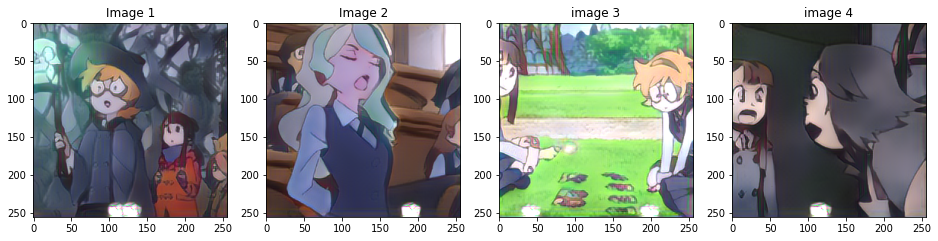

In [ ]:
reference_0, middle, reference_1, y_small = test_generator.getitem(["shot67", "shot165", "shot193", "shot244"])

# y_trans, y_trans_mid, y_trans_sim = color_network(middle, reference_0, reference_1, training=False)
y_trans, y_trans_mid, y_trans_sim = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])
# y_trans, y_trans_mid, y_trans_sim = color_network(target_line_art_images=middle[1], target_distance_maps=middle[2],
#                                                   reference_color_images_0=reference_0[0], reference_line_art_images_0=reference_0[1],
#                                                   reference_distance_maps_0=reference_0[2], 
#                                                   reference_color_images_1=reference_1[0], reference_line_art_images_1=reference_1[1],
#                                                   reference_distance_maps_1=reference_1[2])

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

In [ ]:
y_trans[0].numpy().min()

-1.6959316

In [ ]:
new_max = 255
new_min = 0
grid = (new_max - new_min) / (tf.keras.backend.max(y_trans[0]) - tf.keras.backend.min(y_trans[0])) * (y_trans[0] - tf.keras.backend.max(y_trans[0])) + new_max

In [ ]:
grid.numpy().max()

255.0

In [ ]:
grid.dtype

tf.float32

In [ ]:
tf.cast(grid, tf.int32).numpy().max()

255

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


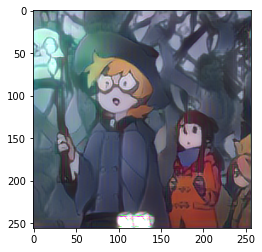

In [ ]:
plt.imshow(tf.cast(y_trans[0] * 255.0, tf.int32))

In [ ]:
tf.keras.preprocessing.image.array_to_img(tf.cast(y_trans[0] * 255.0, tf.int32)).save("./try.jpg")

In [ ]:
df = tf.clip_by_value(tf.cast(y_trans[0] * 255.0, tf.int32), clip_value_min=0, clip_value_max=255)

In [ ]:
tf.keras.preprocessing.image.save_img("./try.jpg", df, scale=False)

In [ ]:
color_network_input = tf.concat([middle, reference_0, reference_1], axis=0)

In [ ]:
color_network_input.shape # 0:3 middle, 3:6 reference_0, 6:9 reference_1

TensorShape([9, 4, 256, 256, 3])

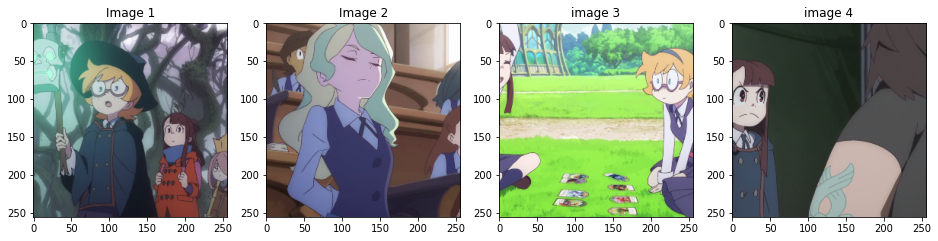

In [ ]:
_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(color_network_input[6][0])

ax[1].set_title("Image 2")
ax[1].imshow(color_network_input[6][1])

ax[2].set_title("image 3")
ax[2].imshow(color_network_input[6][2])

ax[3].set_title("image 4")
ax[3].imshow(color_network_input[6][3])

In [ ]:
# class ColorTransformNetworkSave(tf.keras.Model):
#   def __init__(self, color_network):
#     super(ColorTransformNetworkSave, self).__init__()
#     self.color_network = color_network
  
#   def call(self, x):
#     middle = x[0:3]
#     reference_0 = x[3:6]
#     reference_1 = x[6:9]

#     Y_trans, Y_trans_mid, Y_trans_sim = self.color_network([middle, reference_0, reference_1])

#     return Y_trans, Y_trans_mid, Y_trans_sim

In [ ]:
# color_network_to_save = ColorTransformNetworkSave(color_network)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


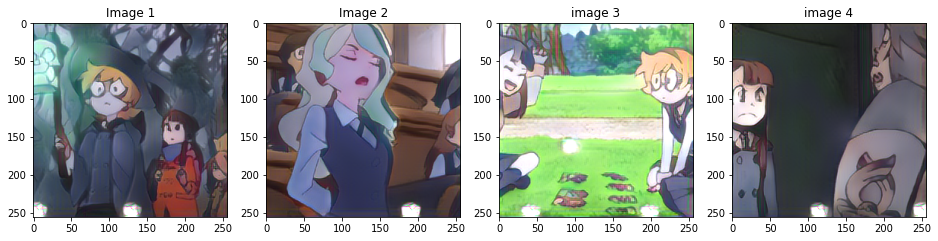

In [ ]:
# y_trans, y_trans_mid, y_trans_sim = color_network_to_save(color_network_input, training=False)

# _, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
# ax[0].set_title("Image 1")
# ax[0].imshow(y_trans[0])

# ax[1].set_title("Image 2")
# ax[1].imshow(y_trans[1])

# ax[2].set_title("image 3")
# ax[2].imshow(y_trans[2])

# ax[3].set_title("image 4")
# ax[3].imshow(y_trans[3])

In [ ]:
# !mkdir saved_model

In [ ]:
!zip -qr saved_model.zip saved_model

In [ ]:
target_line_art_images,
           target_distance_maps,
           reference_color_images_0,
           reference_line_art_images_0,
           reference_distance_maps_0,
           reference_color_images_1,
           reference_line_art_images_1,
           reference_distance_maps_1

In [ ]:
input_signature = [[tf.TensorSpec(shape=[None, 256, 256, 3], dtype=tf.float32), tf.TensorSpec(shape=[None, 256, 256, 3], dtype=tf.float32),
                 tf.TensorSpec(shape=[None, 256, 256, 3], dtype=tf.float32), tf.TensorSpec(shape=[None, 256, 256, 3], dtype=tf.float32),
                 tf.TensorSpec(shape=[None, 256, 256, 3], dtype=tf.float32), tf.TensorSpec(shape=[None, 256, 256, 3], dtype=tf.float32),
                 tf.TensorSpec(shape=[None, 256, 256, 3], dtype=tf.float32), tf.TensorSpec(shape=[None, 256, 256, 3], dtype=tf.float32)]]

In [ ]:
class ColorNetworkModule(tf.Module):
  def __init__(self, model):
    self.model = model

  @tf.function(input_signature=input_signature)
  def generate_image(self, target_line_art_images,
           target_distance_maps,
           reference_color_images_0,
           reference_line_art_images_0,
           reference_distance_maps_0,
           reference_color_images_1,
           reference_line_art_images_1,
           reference_distance_maps_1):
    y_trans, y_trans_mid, y_trans_sim = self.model(target_line_art_images,
           target_distance_maps,
           reference_color_images_0,
           reference_line_art_images_0,
           reference_distance_maps_0,
           reference_color_images_1,
           reference_line_art_images_1,
           reference_distance_maps_1)
    return y_trans, y_trans_mid, y_trans_sim

In [ ]:
color_network_module = ColorNetworkModule(color_network)

In [ ]:
color_network.call

In [ ]:
tf.saved_model.save(color_network_module, 'saved_model/color_network')

In [ ]:
color_network.save('saved_model/color_network')

INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a84eda0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).
INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a800be0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).
INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a810cf8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).
INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.fl

INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a84eda0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a84eda0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a800be0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a800be0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a810cf8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a810cf8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7c0b38>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7c0b38>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7d1c50>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7d1c50>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a783a90>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a783a90>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a792ba8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a792ba8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7419e8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7419e8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a753b00>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a753b00>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a701940>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a701940>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a712a58>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a712a58>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6c4898>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6c4898>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6d39b0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6d39b0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6837f0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6837f0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a695908>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a695908>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a648748>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a648748>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a800be0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a800be0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a84eda0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a84eda0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a84eda0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a84eda0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7c0b38>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7c0b38>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a810cf8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a810cf8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a810cf8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a810cf8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a783a90>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a783a90>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7d1c50>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7d1c50>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7d1c50>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7d1c50>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7419e8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7419e8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a792ba8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a792ba8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a792ba8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a792ba8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a701940>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a701940>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a753b00>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a753b00>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a753b00>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a753b00>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6c4898>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6c4898>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a712a58>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a712a58>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a712a58>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a712a58>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6837f0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6837f0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6d39b0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6d39b0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6d39b0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6d39b0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a648748>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a648748>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a695908>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a695908>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a695908>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a695908>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a84eda0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a84eda0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a800be0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a800be0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a810cf8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a810cf8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7c0b38>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7c0b38>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7d1c50>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7d1c50>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a783a90>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a783a90>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a792ba8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a792ba8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7419e8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a7419e8>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a753b00>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a753b00>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a701940>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a701940>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a712a58>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a712a58>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6c4898>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6c4898>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6d39b0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6d39b0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6837f0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a6837f0>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a695908>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a695908>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a648748>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Unsupported signature for serialization: (([TensorSpec(shape=(None, 64, 64, 256), dtype=tf.float32, name='inputs/0'), <tensorflow.python.framework.func_graph.UnknownArgument object at 0x7f932a648748>, TensorSpec(shape=(None, 1, 1, 512), dtype=tf.float32, name='inputs/2')],), {}).


INFO:tensorflow:Assets written to: saved_model/color_network/assets


INFO:tensorflow:Assets written to: saved_model/color_network/assets


In [ ]:
# color_network_to_save.save('saved_model/color_network')

In [ ]:
# !pip uninstall tensorflow

In [ ]:
# !pip install tensorflow==2.3.1

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


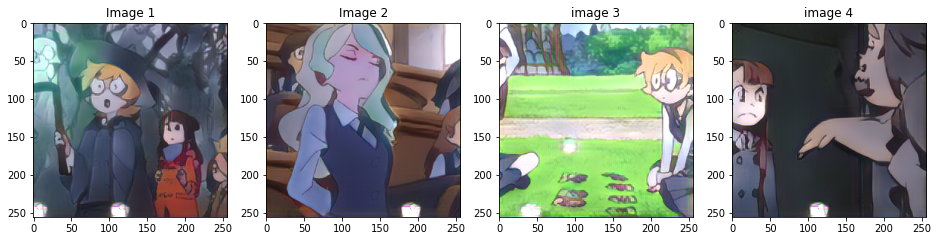

In [ ]:
reference_0, middle, reference_1, y_small = test_generator.getitem(["shot67", "shot165", "shot193", "shot244"])

y_trans, y_trans_mid, y_trans_sim = color_network(middle, reference_0, reference_1, training=False)

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


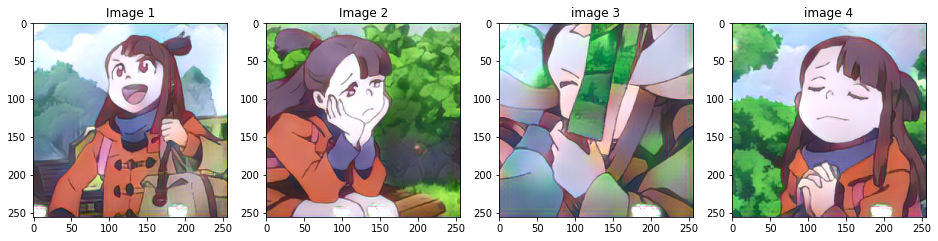

In [ ]:
reference_0, middle, reference_1, y_small = test_generator.getitem(["shot5", "shot10", "shot15", "shot20"])

y_trans, y_trans_mid, y_trans_sim = color_network(middle, reference_0, reference_1, training=False)

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


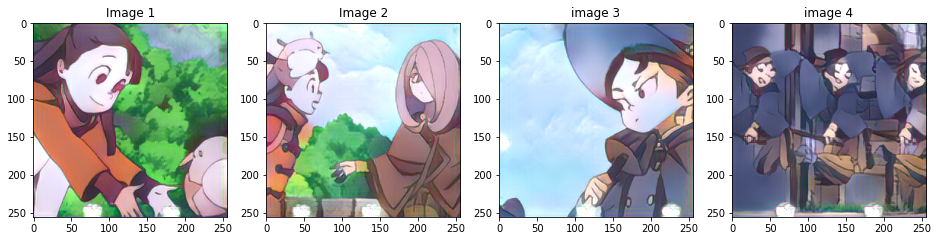

In [ ]:
reference_0, middle, reference_1, y_small = test_generator.getitem(["shot25", "shot30", "shot35", "shot40"])

y_trans, y_trans_mid, y_trans_sim = color_network(middle, reference_0, reference_1, training=False)

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


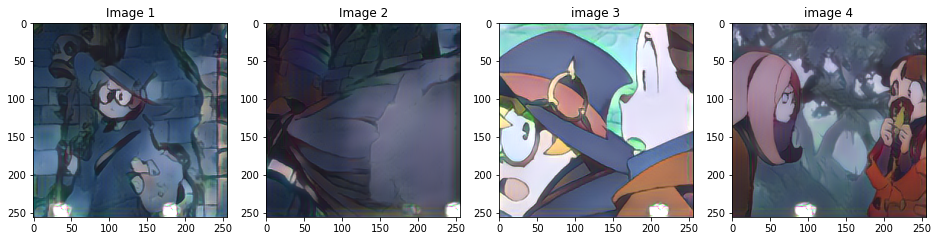

In [ ]:
reference_0, middle, reference_1, y_small = test_generator.getitem(["shot45", "shot50", "shot55", "shot60"])

y_trans, y_trans_mid, y_trans_sim = color_network(middle, reference_0, reference_1, training=False)

_, ax = plt.subplots(nrows=1, ncols=4, figsize=(16, 10))
ax[0].set_title("Image 1")
ax[0].imshow(y_trans[0])

ax[1].set_title("Image 2")
ax[1].imshow(y_trans[1])

ax[2].set_title("image 3")
ax[2].imshow(y_trans[2])

ax[3].set_title("image 4")
ax[3].imshow(y_trans[3])

# Temporal Constraint Network Training

In [ ]:
generator_lr = 1e-4
discriminator_lr = 1e-5

temporal_network_optimizer = tf.keras.optimizers.Adam(learning_rate=generator_lr, beta_1=0.5, beta_2=0.999)
discriminator_3d_optimizer = tf.keras.optimizers.Adam(learning_rate=discriminator_lr, beta_1=0.5, beta_2=0.999)

batch_size = 4
train_steps = len(name_folders) // batch_size

In [ ]:
temporal_network = TemporalConstraintNetwork()
discriminator_3d = TemporalConstraintDiscriminator()

In [ ]:
checkpoint_dir = './temporal_network_checkpoints'
checkpoint_tcn_prefix = os.path.join(checkpoint_dir, "tcn_ckpt")
tcn_checkpoint = tf.train.Checkpoint(temporal_network=temporal_network,
                                 discriminator_3d=discriminator_3d,
                                 temporal_network_optimizer=temporal_network_optimizer,
                                 discriminator_3d_optimizer=discriminator_3d_optimizer)

In [ ]:
print(tf.train.latest_checkpoint(checkpoint_dir))

None


In [ ]:
tcn_checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))
# checkpoint.restore("./training_checkpoints/ckpt-410")

In [ ]:
# !rm -rf temporal_network_checkpoints

In [ ]:
# tf.keras.backend.clear_session()

In [ ]:
def compute_temporal_network_loss(y_trans_class, y, y_trans, y_list, y_trans_list, lambda_style=1000, lambda_l1=10):
  weights = [1, 10, 1]

  mean_avg = 1/3

  loss = 0

  gen_loss = 0
  for i in range(y_trans.shape[1]):
    gen_loss += generator_loss(y_trans_class[:, i]) * mean_avg * weights[i]

  loss += gen_loss

  s_loss = 0
  for i in range(y_trans.shape[1]):
    frame_trans_list = [feature_tensor[i * 4: (i + 1) * 4] for feature_tensor in y_trans_list]
    frame_list = [feature_tensor[i * 4: (i + 1) * 4] for feature_tensor in y_list]
    s_loss += style_loss(frame_list, frame_trans_list) * 1000 * mean_avg * weights[i]

  loss += s_loss

  p_loss = 0
  for i in range(y_trans.shape[1]):
    frame_trans_list = [feature_tensor[i * 4: (i + 1) * 4] for feature_tensor in y_trans_list]
    frame_list = [feature_tensor[i * 4: (i + 1) * 4] for feature_tensor in y_list]
    p_loss += perceptual_loss(frame_list, frame_trans_list) * mean_avg * weights[i]

  loss += p_loss

  l_loss = 0
  for i in range(y_trans.shape[1]):
    l_loss += l1_loss(y[:, i], y_trans[:, i]) * 10 * mean_avg * weights[i]

  loss += l_loss

  return loss, gen_loss, s_loss, p_loss, l_loss

In [ ]:
def compute_discriminator_3d_loss(y_class, y_trans_class):
  real_loss = cross_entropy(tf.ones_like(y_class), y_class)
  fake_loss = cross_entropy(tf.zeros_like(y_trans_class), y_trans_class)
  loss = real_loss + fake_loss

  return loss

In [ ]:
@tf.function
def train_step(x, y0, y1):
  y_trans, _, _ = color_network([x[1], x[2], y0[0], y0[1], y0[2], y1[0], y1[1], y1[2]], training=False)

  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    reference_0 = tf.concat([y0[1][..., :1], y0[0]], -1) #4x256x256x4
    target = tf.concat([x[1][..., :1], y_trans], -1) # 4x256x256x4
    reference_1 = tf.concat([y1[1][..., :1], y1[0]], -1) # 4x256x256x4

    input = tf.stack([reference_0, target, reference_1], axis=1) # 4x3x256x256x4
    # BxTxHxWxC

    y_final = temporal_network(input, training=True) #(4, 3, 256, 256, 3)
    # BxTxHxWxC C=3

    B, T, H, W, C = y_final.shape

    reference_0 = reference_0[:, :, :, 1:] #4x256x256x3
    target = tf.concat([x[1], x[0]], -1)
    target = target[:, :, :, 3:] # 4x256x256x3
    reference_1 = reference_1[:, :, :, 1:] # 4x256x256x3
    y = tf.stack([reference_0, target, reference_1], axis=1)

    y_2d = tf.reshape(y, [B * T, H, W, C])

    y_final_2d = tf.reshape(y_final, [B * T, H, W, C])

    y_list = vgg(y_2d)
    y_trans_list = vgg(tf.clip_by_value(y_final_2d, 0, 1))

    y_class = discriminator_3d(y, training=True)
    y_trans_class = discriminator_3d(y_final, training=True)

    temporal_network_loss, gen_loss, s_loss, p_loss, l_loss = compute_temporal_network_loss(y_trans_class, y, y_final, y_list, y_trans_list)
    discriminator_3d_loss = compute_discriminator_3d_loss(y_class, y_trans_class)
  
  temporal_network_gradients = gen_tape.gradient(temporal_network_loss, temporal_network.trainable_variables)
  discriminator_3d_gradients = disc_tape.gradient(discriminator_3d_loss, discriminator_3d.trainable_variables)

  temporal_network_optimizer.apply_gradients(zip(temporal_network_gradients, temporal_network.trainable_variables))
  discriminator_3d_optimizer.apply_gradients(zip(discriminator_3d_gradients, discriminator_3d.trainable_variables))

  return temporal_network_loss, gen_loss, s_loss, p_loss, l_loss, discriminator_3d_loss

In [ ]:
train_loss_results = []
generator_loss_results = []
discriminator_loss_results = []

gen_loss_results = []
s_loss_results = []
p_loss_results = []
l_loss_results = []

In [ ]:
def train():
  for epoch in range(epochs):
    batch_time = time.time()
    epoch_time = time.time()
    step = 0
    epoch_count = f"0{epoch + 1}/{epochs}" if epoch < 9 else f"{epoch + 1}/{epochs}"

    for reference_0, middle, reference_1 in train_generator:
      temporal_network_loss, gen_loss, s_loss, p_loss, l_loss, discriminator_3d_loss = train_step(middle, reference_0, reference_1)

      temporal_network_loss = float(temporal_network_loss)
      discriminator_3d_loss = float(discriminator_3d_loss)
      loss = temporal_network_loss + discriminator_3d_loss
      step += 1

      print('\r', 'Epoch', epoch_count, '| Step', f"{step}/{train_steps}",
              '| Loss:', f"{loss:.5f}", '| Discriminator loss:', f"{discriminator_3d_loss:.5f}",
             '| Generator loss:', f"{temporal_network_loss:.5f}", "| Step Time:", f"{time.time() - batch_time:.2f}", end='')    
        
      batch_time = time.time()
      train_loss_results.append(loss)
      generator_loss_results.append(temporal_network_loss)
      discriminator_loss_results.append(discriminator_3d_loss)
      gen_loss_results.append(float(gen_loss))
      s_loss_results.append(float(s_loss))
      p_loss_results.append(float(p_loss))
      l_loss_results.append(float(l_loss))

    tcn_checkpoint.save(file_prefix=checkpoint_tcn_prefix)

    print('\r', 'Epoch', epoch_count, '| Step', f"{step}/{train_steps}",
          '| Loss:', f"{loss:.5f}", '| Discriminator loss:', f"{discriminator_3d_loss:.5f}",
          '| Generator loss:', f"{temporal_network_loss:.5f}", "| Epoch Time:", f"{time.time() - epoch_time:.2f}")

In [ ]:
epochs = 20
train()

 Epoch 01/20 | Step 85/85 | Loss: 146.28924 | Discriminator loss: 1.39532 | Generator loss: 144.89392 | Epoch Time: 289.78
 Epoch 02/20 | Step 85/85 | Loss: 123.15700 | Discriminator loss: 1.40836 | Generator loss: 121.74863 | Epoch Time: 257.39
 Epoch 03/20 | Step 85/85 | Loss: 112.16057 | Discriminator loss: 1.43546 | Generator loss: 110.72511 | Epoch Time: 257.55
 Epoch 04/20 | Step 85/85 | Loss: 102.82365 | Discriminator loss: 1.42587 | Generator loss: 101.39778 | Epoch Time: 257.22
 Epoch 05/20 | Step 85/85 | Loss: 98.30271 | Discriminator loss: 1.42627 | Generator loss: 96.87644 | Epoch Time: 257.35
 Epoch 06/20 | Step 85/85 | Loss: 95.06094 | Discriminator loss: 1.38766 | Generator loss: 93.67328 | Epoch Time: 257.26
 Epoch 07/20 | Step 85/85 | Loss: 90.79539 | Discriminator loss: 1.38763 | Generator loss: 89.40777 | Epoch Time: 257.26
 Epoch 08/20 | Step 85/85 | Loss: 89.25146 | Discriminator loss: 1.36017 | Generator loss: 87.89130 | Epoch Time: 257.17
 Epoch 09/20 | Step 85/8

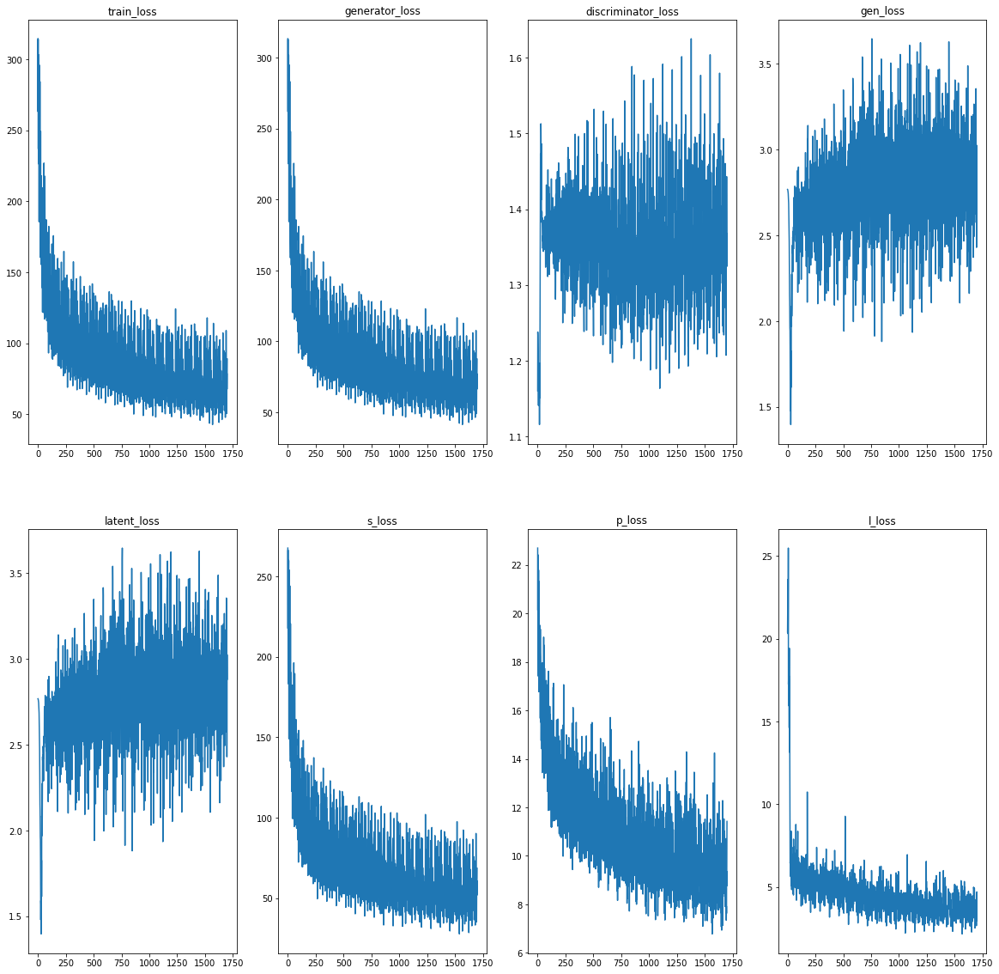

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, gen_loss_results, s_loss_results, p_loss_results, l_loss_results)

In [ ]:
epochs = 20
train()

 Epoch 01/20 | Step 85/85 | Loss: 149.47276 | Discriminator loss: 0.95184 | Generator loss: 148.52092 | Epoch Time: 295.14
 Epoch 02/20 | Step 85/85 | Loss: 128.50496 | Discriminator loss: 1.09255 | Generator loss: 127.41241 | Epoch Time: 266.81
 Epoch 03/20 | Step 85/85 | Loss: 118.77979 | Discriminator loss: 0.91419 | Generator loss: 117.86560 | Epoch Time: 266.68
 Epoch 04/20 | Step 85/85 | Loss: 109.81907 | Discriminator loss: 0.91666 | Generator loss: 108.90240 | Epoch Time: 266.68
 Epoch 05/20 | Step 85/85 | Loss: 110.30414 | Discriminator loss: 0.78085 | Generator loss: 109.52328 | Epoch Time: 266.72
 Epoch 06/20 | Step 85/85 | Loss: 101.22744 | Discriminator loss: 0.85479 | Generator loss: 100.37265 | Epoch Time: 266.79
 Epoch 07/20 | Step 85/85 | Loss: 97.25338 | Discriminator loss: 0.93714 | Generator loss: 96.31624 | Epoch Time: 266.46
 Epoch 08/20 | Step 85/85 | Loss: 90.96389 | Discriminator loss: 0.82272 | Generator loss: 90.14117 | Epoch Time: 266.24
 Epoch 09/20 | Step 

In [ ]:
train()

 Epoch 01/20 | Step 85/85 | Loss: 76.07941 | Discriminator loss: 1.00279 | Generator loss: 75.07661 | Epoch Time: 265.84
 Epoch 02/20 | Step 85/85 | Loss: 78.04342 | Discriminator loss: 0.99614 | Generator loss: 77.04729 | Epoch Time: 266.15
 Epoch 03/20 | Step 85/85 | Loss: 75.57383 | Discriminator loss: 1.05239 | Generator loss: 74.52144 | Epoch Time: 266.35
 Epoch 04/20 | Step 85/85 | Loss: 78.46486 | Discriminator loss: 0.98106 | Generator loss: 77.48380 | Epoch Time: 266.22
 Epoch 05/20 | Step 85/85 | Loss: 77.82831 | Discriminator loss: 0.99442 | Generator loss: 76.83389 | Epoch Time: 266.27
 Epoch 06/20 | Step 85/85 | Loss: 79.44706 | Discriminator loss: 1.01167 | Generator loss: 78.43539 | Epoch Time: 266.45
 Epoch 07/20 | Step 85/85 | Loss: 80.61664 | Discriminator loss: 1.03487 | Generator loss: 79.58177 | Epoch Time: 265.89
 Epoch 08/20 | Step 85/85 | Loss: 72.20485 | Discriminator loss: 1.05305 | Generator loss: 71.15180 | Epoch Time: 266.42
 Epoch 09/20 | Step 85/85 | Loss

In [ ]:
epochs = 10
train()

 Epoch 01/10 | Step 85/85 | Loss: 67.05705 | Discriminator loss: 1.14293 | Generator loss: 65.91412 | Epoch Time: 266.41
 Epoch 02/10 | Step 85/85 | Loss: 73.65567 | Discriminator loss: 1.12826 | Generator loss: 72.52741 | Epoch Time: 266.00
 Epoch 03/10 | Step 85/85 | Loss: 76.01263 | Discriminator loss: 1.14907 | Generator loss: 74.86356 | Epoch Time: 266.11
 Epoch 04/10 | Step 85/85 | Loss: 70.44276 | Discriminator loss: 1.14684 | Generator loss: 69.29592 | Epoch Time: 266.16
 Epoch 05/10 | Step 85/85 | Loss: 75.58300 | Discriminator loss: 1.15020 | Generator loss: 74.43280 | Epoch Time: 266.05
 Epoch 06/10 | Step 85/85 | Loss: 63.58667 | Discriminator loss: 1.19448 | Generator loss: 62.39218 | Epoch Time: 266.42
 Epoch 07/10 | Step 85/85 | Loss: 73.91803 | Discriminator loss: 1.15014 | Generator loss: 72.76788 | Epoch Time: 266.40
 Epoch 08/10 | Step 85/85 | Loss: 62.96866 | Discriminator loss: 1.20497 | Generator loss: 61.76369 | Epoch Time: 266.49
 Epoch 09/10 | Step 85/85 | Loss

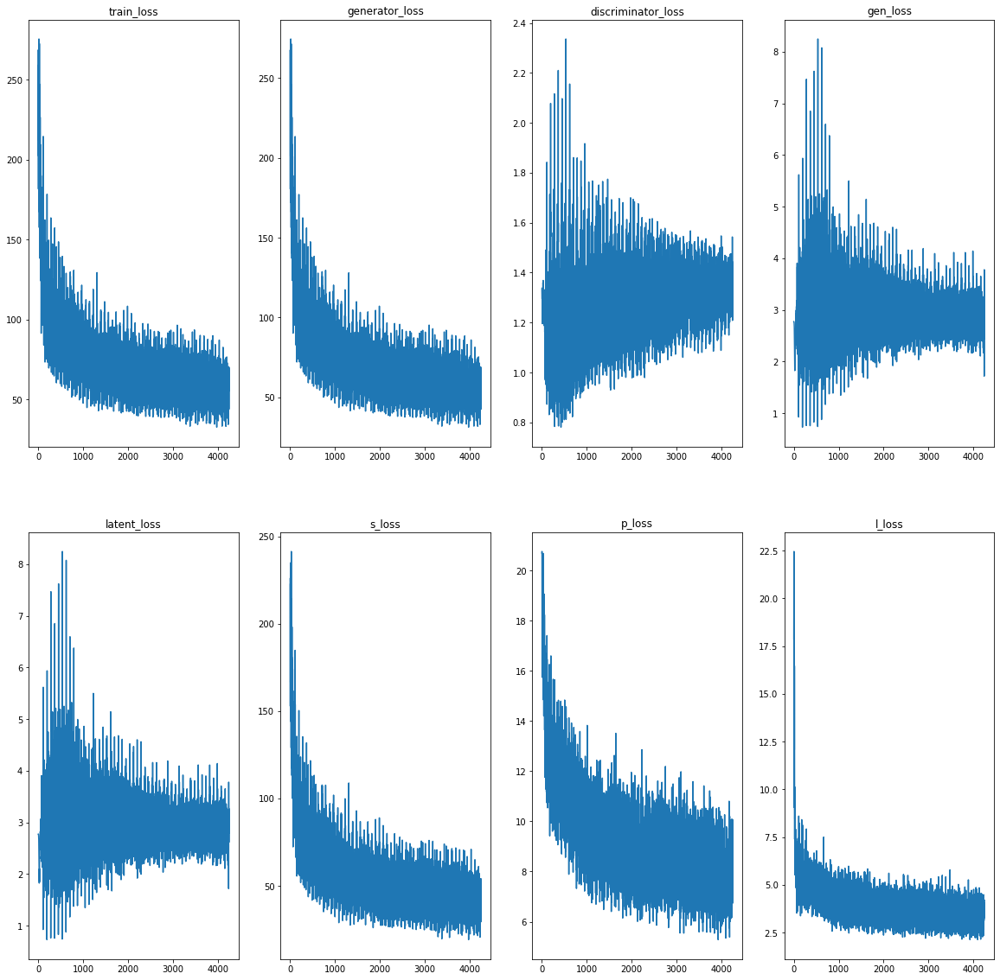

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, gen_loss_results, s_loss_results, p_loss_results, l_loss_results)

In [ ]:
epochs = 30
train()

 Epoch 01/30 | Step 85/85 | Loss: 46.51064 | Discriminator loss: 1.36847 | Generator loss: 45.14217 | Epoch Time: 289.03
 Epoch 02/30 | Step 85/85 | Loss: 40.00335 | Discriminator loss: 1.32742 | Generator loss: 38.67593 | Epoch Time: 265.66
 Epoch 03/30 | Step 85/85 | Loss: 43.57478 | Discriminator loss: 1.36730 | Generator loss: 42.20749 | Epoch Time: 267.15
 Epoch 04/30 | Step 85/85 | Loss: 40.13717 | Discriminator loss: 1.34213 | Generator loss: 38.79504 | Epoch Time: 267.23
 Epoch 05/30 | Step 85/85 | Loss: 37.72185 | Discriminator loss: 1.33106 | Generator loss: 36.39079 | Epoch Time: 266.61
 Epoch 06/30 | Step 85/85 | Loss: 39.87155 | Discriminator loss: 1.35892 | Generator loss: 38.51263 | Epoch Time: 266.70
 Epoch 07/30 | Step 85/85 | Loss: 41.03859 | Discriminator loss: 1.34020 | Generator loss: 39.69839 | Epoch Time: 266.88
 Epoch 08/30 | Step 85/85 | Loss: 39.63964 | Discriminator loss: 1.33958 | Generator loss: 38.30006 | Epoch Time: 266.80
 Epoch 09/30 | Step 85/85 | Loss

In [ ]:
epochs = 20
train()

 Epoch 01/20 | Step 85/85 | Loss: 35.43895 | Discriminator loss: 1.37571 | Generator loss: 34.06324 | Epoch Time: 266.85
 Epoch 02/20 | Step 85/85 | Loss: 34.72334 | Discriminator loss: 1.36661 | Generator loss: 33.35673 | Epoch Time: 267.06
 Epoch 03/20 | Step 85/85 | Loss: 35.21306 | Discriminator loss: 1.37992 | Generator loss: 33.83315 | Epoch Time: 267.14
 Epoch 04/20 | Step 85/85 | Loss: 38.95229 | Discriminator loss: 1.38028 | Generator loss: 37.57201 | Epoch Time: 267.35
 Epoch 05/20 | Step 85/85 | Loss: 36.22124 | Discriminator loss: 1.37696 | Generator loss: 34.84428 | Epoch Time: 267.34
 Epoch 06/20 | Step 85/85 | Loss: 32.06809 | Discriminator loss: 1.37685 | Generator loss: 30.69123 | Epoch Time: 267.18
 Epoch 07/20 | Step 85/85 | Loss: 37.66713 | Discriminator loss: 1.37433 | Generator loss: 36.29279 | Epoch Time: 266.84
 Epoch 08/20 | Step 85/85 | Loss: 37.85133 | Discriminator loss: 1.37470 | Generator loss: 36.47663 | Epoch Time: 266.81
 Epoch 09/20 | Step 85/85 | Loss

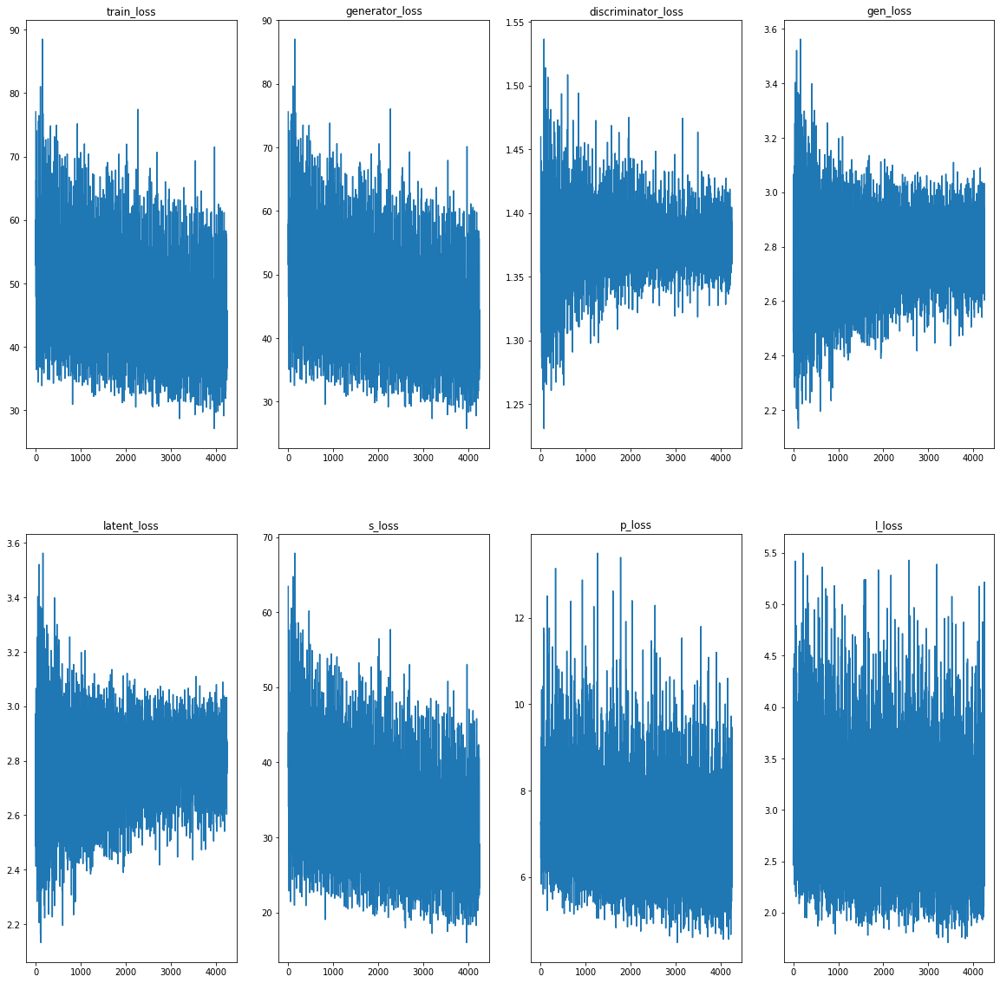

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, gen_loss_results, s_loss_results, p_loss_results, l_loss_results)

In [ ]:
epochs = 20

In [ ]:
train()

 Epoch 01/20 | Step 85/85 | Loss: 35.86021 | Discriminator loss: 1.38058 | Generator loss: 34.47963 | Epoch Time: 266.83
 Epoch 02/20 | Step 85/85 | Loss: 32.67068 | Discriminator loss: 1.37139 | Generator loss: 31.29929 | Epoch Time: 267.22
 Epoch 03/20 | Step 85/85 | Loss: 34.82161 | Discriminator loss: 1.36690 | Generator loss: 33.45471 | Epoch Time: 267.21
 Epoch 04/20 | Step 85/85 | Loss: 34.54195 | Discriminator loss: 1.36737 | Generator loss: 33.17458 | Epoch Time: 266.99
 Epoch 05/20 | Step 85/85 | Loss: 34.29588 | Discriminator loss: 1.37434 | Generator loss: 32.92155 | Epoch Time: 267.18
 Epoch 06/20 | Step 85/85 | Loss: 33.55836 | Discriminator loss: 1.37243 | Generator loss: 32.18592 | Epoch Time: 267.07
 Epoch 07/20 | Step 85/85 | Loss: 34.58179 | Discriminator loss: 1.37348 | Generator loss: 33.20831 | Epoch Time: 266.90
 Epoch 08/20 | Step 85/85 | Loss: 35.59621 | Discriminator loss: 1.37532 | Generator loss: 34.22089 | Epoch Time: 267.27
 Epoch 09/20 | Step 85/85 | Loss

In [ ]:
train()

 Epoch 01/20 | Step 85/85 | Loss: 35.08416 | Discriminator loss: 1.37350 | Generator loss: 33.71066 | Epoch Time: 266.59
 Epoch 02/20 | Step 85/85 | Loss: 33.84225 | Discriminator loss: 1.37902 | Generator loss: 32.46323 | Epoch Time: 266.58
 Epoch 03/20 | Step 85/85 | Loss: 32.42757 | Discriminator loss: 1.36947 | Generator loss: 31.05811 | Epoch Time: 266.78
 Epoch 04/20 | Step 85/85 | Loss: 33.48314 | Discriminator loss: 1.37493 | Generator loss: 32.10821 | Epoch Time: 266.43
 Epoch 05/20 | Step 85/85 | Loss: 31.59025 | Discriminator loss: 1.37232 | Generator loss: 30.21793 | Epoch Time: 266.77
 Epoch 06/20 | Step 85/85 | Loss: 32.66629 | Discriminator loss: 1.36993 | Generator loss: 31.29636 | Epoch Time: 266.77
 Epoch 07/20 | Step 85/85 | Loss: 31.64865 | Discriminator loss: 1.36961 | Generator loss: 30.27904 | Epoch Time: 266.84
 Epoch 08/20 | Step 85/85 | Loss: 33.84294 | Discriminator loss: 1.37964 | Generator loss: 32.46331 | Epoch Time: 266.58
 Epoch 09/20 | Step 85/85 | Loss

In [ ]:
epochs = 10
train()

 Epoch 01/10 | Step 85/85 | Loss: 29.88303 | Discriminator loss: 1.37807 | Generator loss: 28.50496 | Epoch Time: 267.04
 Epoch 02/10 | Step 85/85 | Loss: 32.56863 | Discriminator loss: 1.37188 | Generator loss: 31.19675 | Epoch Time: 267.21
 Epoch 03/10 | Step 85/85 | Loss: 34.78501 | Discriminator loss: 1.37871 | Generator loss: 33.40630 | Epoch Time: 267.00
 Epoch 04/10 | Step 85/85 | Loss: 31.09314 | Discriminator loss: 1.37992 | Generator loss: 29.71322 | Epoch Time: 267.14
 Epoch 05/10 | Step 85/85 | Loss: 30.19799 | Discriminator loss: 1.37409 | Generator loss: 28.82390 | Epoch Time: 266.98
 Epoch 06/10 | Step 85/85 | Loss: 32.58653 | Discriminator loss: 1.37685 | Generator loss: 31.20969 | Epoch Time: 266.55
 Epoch 07/10 | Step 85/85 | Loss: 33.77247 | Discriminator loss: 1.38360 | Generator loss: 32.38887 | Epoch Time: 266.94
 Epoch 08/10 | Step 85/85 | Loss: 34.09717 | Discriminator loss: 1.38115 | Generator loss: 32.71602 | Epoch Time: 266.69
 Epoch 09/10 | Step 85/85 | Loss

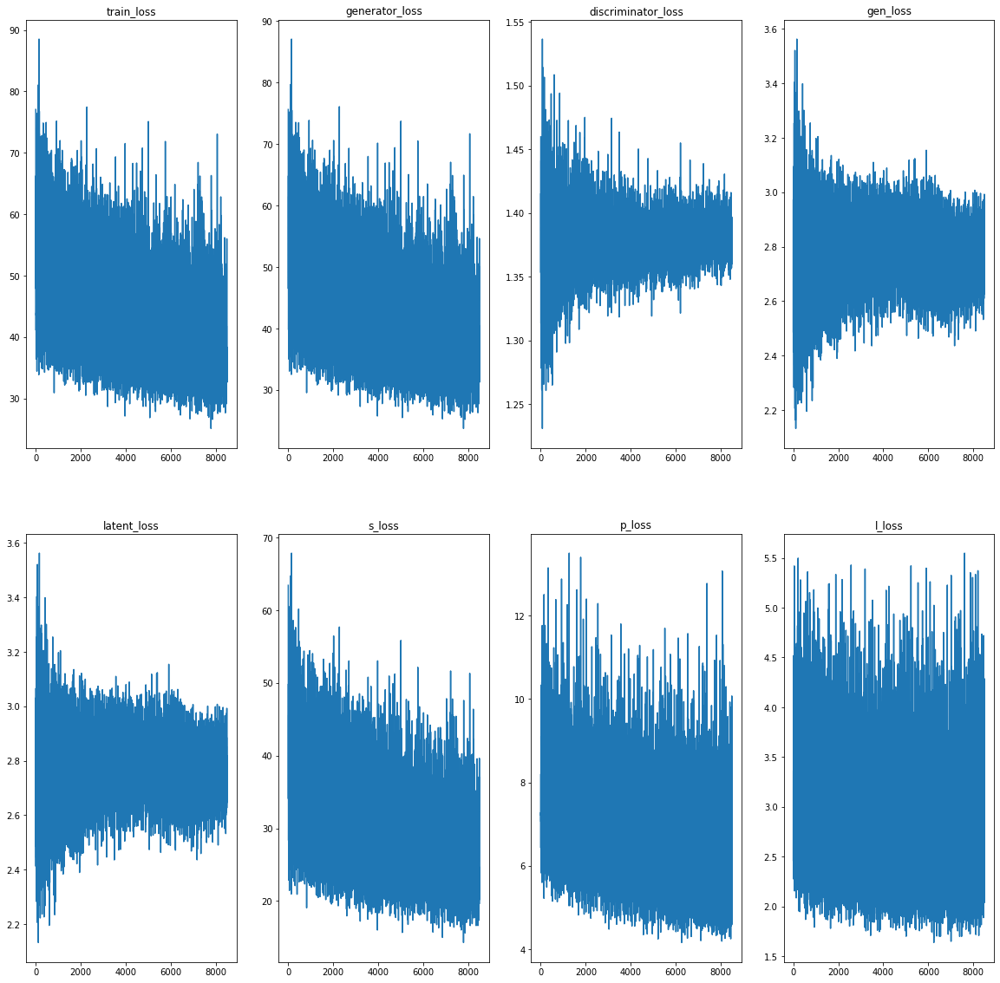

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, gen_loss_results, s_loss_results, p_loss_results, l_loss_results)

In [ ]:
train()

 Epoch 01/20 | Step 85/85 | Loss: 16.62938 | Discriminator loss: 1.23162 | Generator loss: 15.39776 | Epoch Time: 246.31
 Epoch 02/20 | Step 85/85 | Loss: 15.45729 | Discriminator loss: 1.26705 | Generator loss: 14.19024 | Epoch Time: 246.49
 Epoch 03/20 | Step 85/85 | Loss: 14.94692 | Discriminator loss: 1.30899 | Generator loss: 13.63794 | Epoch Time: 246.33
 Epoch 04/20 | Step 85/85 | Loss: 14.59520 | Discriminator loss: 1.25995 | Generator loss: 13.33526 | Epoch Time: 246.47
 Epoch 05/20 | Step 85/85 | Loss: 16.84754 | Discriminator loss: 1.31873 | Generator loss: 15.52881 | Epoch Time: 246.03
 Epoch 06/20 | Step 85/85 | Loss: 15.14987 | Discriminator loss: 1.24658 | Generator loss: 13.90329 | Epoch Time: 245.87
 Epoch 07/20 | Step 85/85 | Loss: 15.02183 | Discriminator loss: 1.29454 | Generator loss: 13.72729 | Epoch Time: 245.91
 Epoch 08/20 | Step 85/85 | Loss: 13.86525 | Discriminator loss: 1.28901 | Generator loss: 12.57624 | Epoch Time: 245.86
 Epoch 09/20 | Step 85/85 | Loss

In [ ]:
epochs = 10
train()

 Epoch 01/10 | Step 85/85 | Loss: 13.75127 | Discriminator loss: 1.31013 | Generator loss: 12.44115 | Epoch Time: 246.45
 Epoch 02/10 | Step 85/85 | Loss: 13.89669 | Discriminator loss: 1.30291 | Generator loss: 12.59378 | Epoch Time: 246.49
 Epoch 03/10 | Step 85/85 | Loss: 15.51253 | Discriminator loss: 1.28598 | Generator loss: 14.22655 | Epoch Time: 246.65
 Epoch 04/10 | Step 85/85 | Loss: 13.49340 | Discriminator loss: 1.29813 | Generator loss: 12.19528 | Epoch Time: 246.35
 Epoch 05/10 | Step 85/85 | Loss: 13.64353 | Discriminator loss: 1.31494 | Generator loss: 12.32859 | Epoch Time: 246.59
 Epoch 06/10 | Step 85/85 | Loss: 12.96610 | Discriminator loss: 1.26812 | Generator loss: 11.69798 | Epoch Time: 246.44
 Epoch 07/10 | Step 85/85 | Loss: 12.86391 | Discriminator loss: 1.31672 | Generator loss: 11.54719 | Epoch Time: 246.37
 Epoch 08/10 | Step 85/85 | Loss: 12.50241 | Discriminator loss: 1.28384 | Generator loss: 11.21856 | Epoch Time: 246.44
 Epoch 09/10 | Step 85/85 | Loss

In [ ]:
train()

 Epoch 01/10 | Step 85/85 | Loss: 12.05470 | Discriminator loss: 1.29364 | Generator loss: 10.76107 | Epoch Time: 246.11
 Epoch 02/10 | Step 85/85 | Loss: 12.06002 | Discriminator loss: 1.31787 | Generator loss: 10.74215 | Epoch Time: 246.25
 Epoch 03/10 | Step 85/85 | Loss: 11.49304 | Discriminator loss: 1.34499 | Generator loss: 10.14805 | Epoch Time: 246.33
 Epoch 04/10 | Step 85/85 | Loss: 11.40586 | Discriminator loss: 1.36106 | Generator loss: 10.04479 | Epoch Time: 246.21
 Epoch 05/10 | Step 85/85 | Loss: 10.93781 | Discriminator loss: 1.35222 | Generator loss: 9.58559 | Epoch Time: 246.23
 Epoch 06/10 | Step 85/85 | Loss: 12.97618 | Discriminator loss: 1.40200 | Generator loss: 11.57418 | Epoch Time: 246.13
 Epoch 07/10 | Step 85/85 | Loss: 12.58426 | Discriminator loss: 1.39857 | Generator loss: 11.18569 | Epoch Time: 245.85
 Epoch 08/10 | Step 85/85 | Loss: 12.13502 | Discriminator loss: 1.38788 | Generator loss: 10.74713 | Epoch Time: 246.15
 Epoch 09/10 | Step 85/85 | Loss:

In [ ]:
train()

 Epoch 01/10 | Step 85/85 | Loss: 13.48874 | Discriminator loss: 1.40536 | Generator loss: 12.08338 | Epoch Time: 238.90
 Epoch 02/10 | Step 85/85 | Loss: 10.87656 | Discriminator loss: 1.36107 | Generator loss: 9.51549 | Epoch Time: 245.40
 Epoch 03/10 | Step 85/85 | Loss: 12.50779 | Discriminator loss: 1.37350 | Generator loss: 11.13429 | Epoch Time: 246.43
 Epoch 04/10 | Step 85/85 | Loss: 13.00480 | Discriminator loss: 1.39045 | Generator loss: 11.61436 | Epoch Time: 246.49
 Epoch 05/10 | Step 85/85 | Loss: 12.36608 | Discriminator loss: 1.35844 | Generator loss: 11.00764 | Epoch Time: 246.54
 Epoch 06/10 | Step 85/85 | Loss: 13.58622 | Discriminator loss: 1.40072 | Generator loss: 12.18550 | Epoch Time: 246.51
 Epoch 07/10 | Step 85/85 | Loss: 11.92287 | Discriminator loss: 1.38419 | Generator loss: 10.53868 | Epoch Time: 246.78
 Epoch 08/10 | Step 85/85 | Loss: 14.20481 | Discriminator loss: 1.39093 | Generator loss: 12.81388 | Epoch Time: 246.63
 Epoch 09/10 | Step 85/85 | Loss:

In [ ]:
train()

 Epoch 01/10 | Step 85/85 | Loss: 11.27059 | Discriminator loss: 1.37968 | Generator loss: 9.89090 | Epoch Time: 246.15
 Epoch 02/10 | Step 85/85 | Loss: 11.59482 | Discriminator loss: 1.36607 | Generator loss: 10.22875 | Epoch Time: 246.41
 Epoch 03/10 | Step 85/85 | Loss: 11.60026 | Discriminator loss: 1.37283 | Generator loss: 10.22743 | Epoch Time: 246.29
 Epoch 04/10 | Step 85/85 | Loss: 12.11566 | Discriminator loss: 1.37332 | Generator loss: 10.74234 | Epoch Time: 246.34
 Epoch 05/10 | Step 85/85 | Loss: 10.98286 | Discriminator loss: 1.37047 | Generator loss: 9.61239 | Epoch Time: 245.94
 Epoch 06/10 | Step 85/85 | Loss: 12.01334 | Discriminator loss: 1.38419 | Generator loss: 10.62915 | Epoch Time: 246.34
 Epoch 07/10 | Step 85/85 | Loss: 11.31109 | Discriminator loss: 1.37493 | Generator loss: 9.93616 | Epoch Time: 246.08
 Epoch 08/10 | Step 85/85 | Loss: 13.75786 | Discriminator loss: 1.39490 | Generator loss: 12.36296 | Epoch Time: 245.89
 Epoch 09/10 | Step 85/85 | Loss: 1

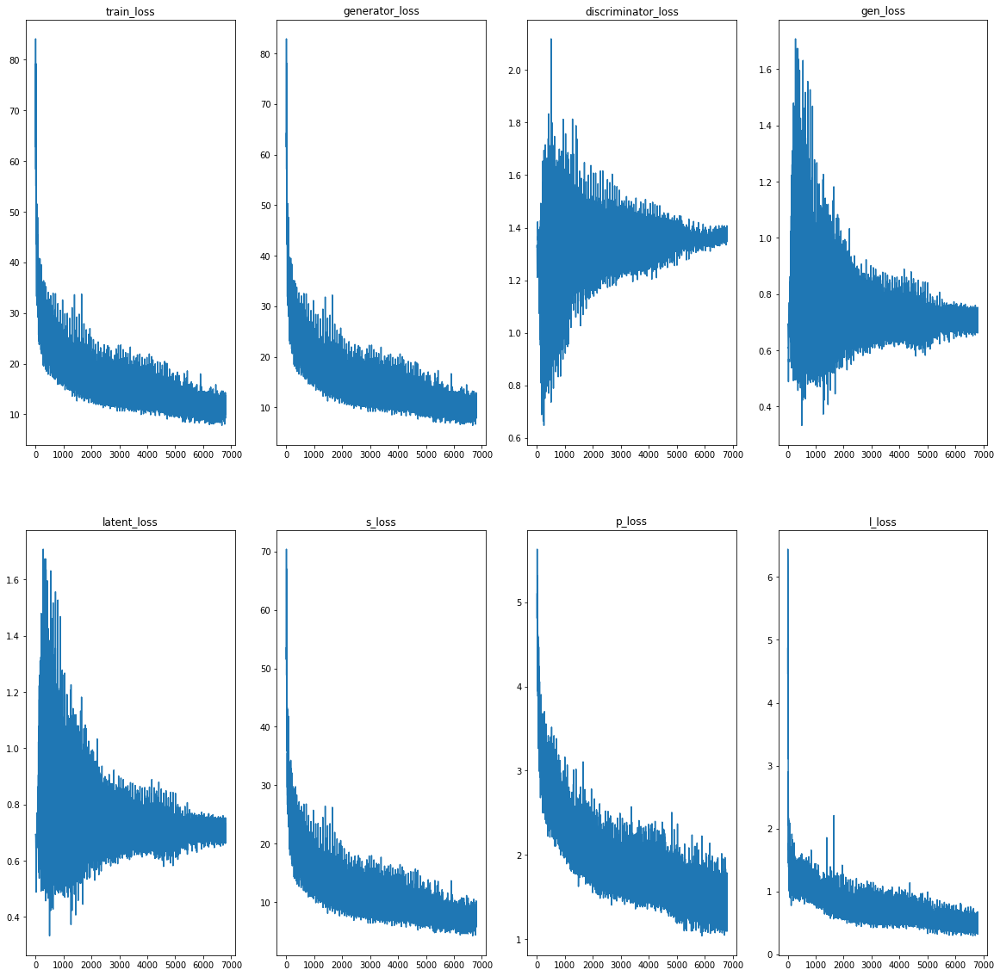

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, gen_loss_results, s_loss_results, p_loss_results, l_loss_results)

In [ ]:
epochs = 20
train()

 Epoch 01/20 | Step 85/85 | Loss: 9.18627 | Discriminator loss: 1.38533 | Generator loss: 7.80094 | Epoch Time: 294.53
 Epoch 02/20 | Step 85/85 | Loss: 8.48256 | Discriminator loss: 1.36910 | Generator loss: 7.11346 | Epoch Time: 260.55
 Epoch 03/20 | Step 85/85 | Loss: 8.70184 | Discriminator loss: 1.37432 | Generator loss: 7.32752 | Epoch Time: 260.56
 Epoch 04/20 | Step 85/85 | Loss: 8.77385 | Discriminator loss: 1.36845 | Generator loss: 7.40541 | Epoch Time: 260.90
 Epoch 05/20 | Step 85/85 | Loss: 9.05709 | Discriminator loss: 1.37529 | Generator loss: 7.68179 | Epoch Time: 260.33
 Epoch 06/20 | Step 85/85 | Loss: 8.62101 | Discriminator loss: 1.38181 | Generator loss: 7.23919 | Epoch Time: 261.12
 Epoch 07/20 | Step 85/85 | Loss: 8.57535 | Discriminator loss: 1.37499 | Generator loss: 7.20036 | Epoch Time: 260.38
 Epoch 08/20 | Step 85/85 | Loss: 8.87626 | Discriminator loss: 1.38421 | Generator loss: 7.49205 | Epoch Time: 260.57
 Epoch 09/20 | Step 85/85 | Loss: 9.09745 | Disc

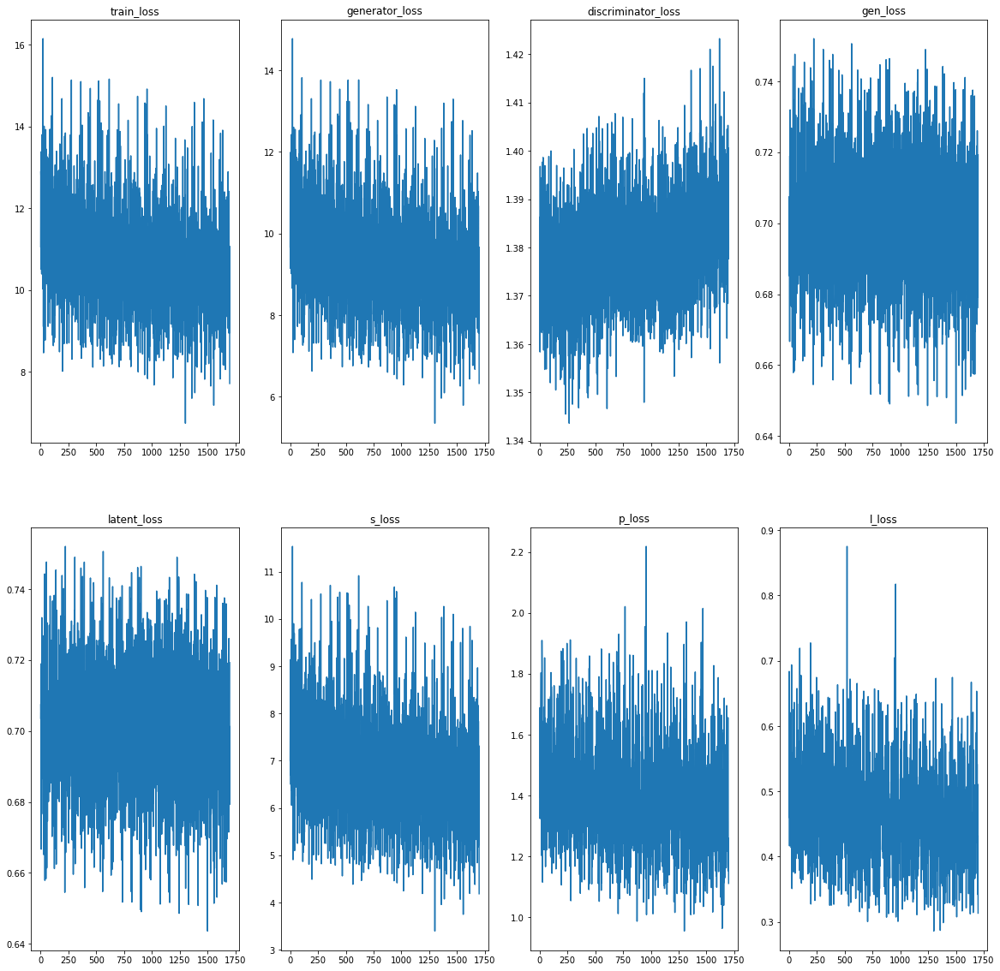

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, gen_loss_results, s_loss_results, p_loss_results, l_loss_results)

In [ ]:
epochs = 20
train()

 Epoch 01/20 | Step 85/85 | Loss: 9.73341 | Discriminator loss: 1.39014 | Generator loss: 8.34327 | Epoch Time: 269.04
 Epoch 02/20 | Step 85/85 | Loss: 10.22208 | Discriminator loss: 1.38540 | Generator loss: 8.83668 | Epoch Time: 243.13
 Epoch 03/20 | Step 85/85 | Loss: 10.58870 | Discriminator loss: 1.39202 | Generator loss: 9.19668 | Epoch Time: 244.11
 Epoch 04/20 | Step 85/85 | Loss: 10.57616 | Discriminator loss: 1.37209 | Generator loss: 9.20408 | Epoch Time: 244.77
 Epoch 05/20 | Step 85/85 | Loss: 9.32287 | Discriminator loss: 1.38929 | Generator loss: 7.93358 | Epoch Time: 244.88
 Epoch 06/20 | Step 85/85 | Loss: 10.14172 | Discriminator loss: 1.39745 | Generator loss: 8.74427 | Epoch Time: 244.10
 Epoch 07/20 | Step 85/85 | Loss: 9.74890 | Discriminator loss: 1.38778 | Generator loss: 8.36112 | Epoch Time: 244.17
 Epoch 08/20 | Step 85/85 | Loss: 10.08526 | Discriminator loss: 1.39078 | Generator loss: 8.69449 | Epoch Time: 244.45
 Epoch 09/20 | Step 85/85 | Loss: 9.58687 |

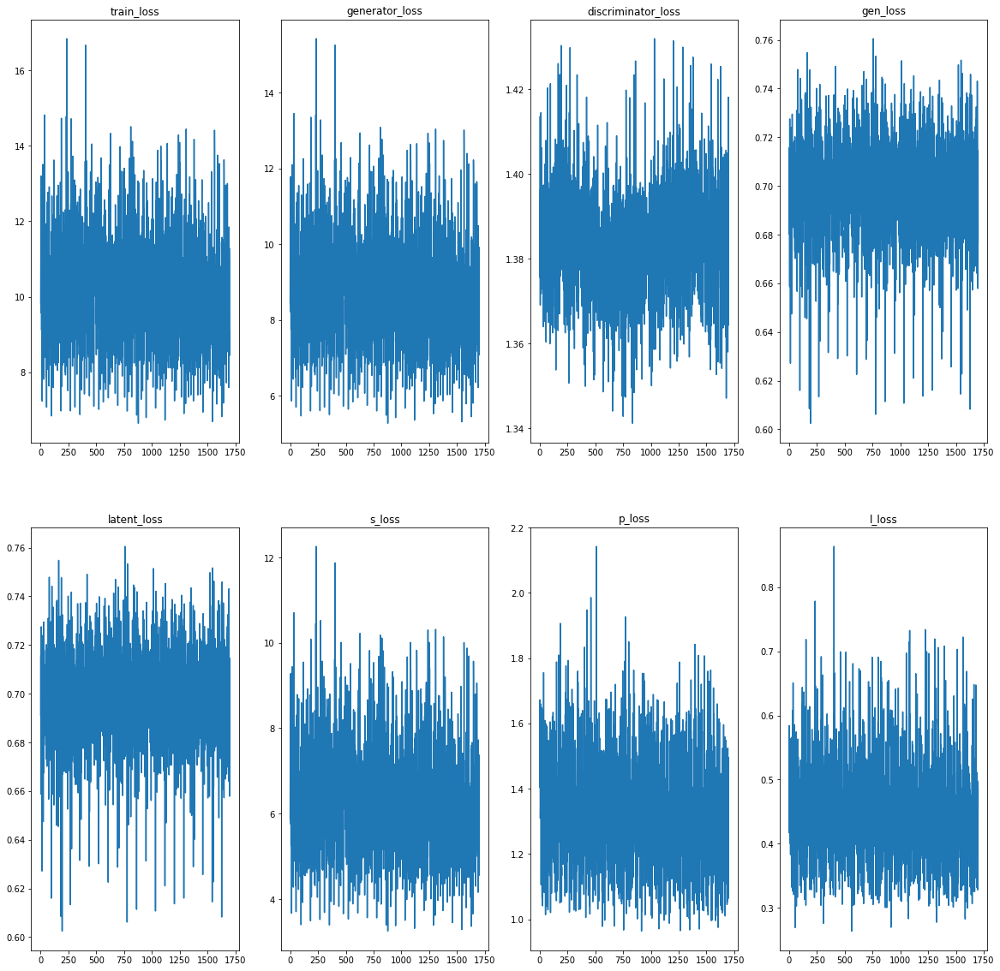

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, gen_loss_results, s_loss_results, p_loss_results, l_loss_results)

In [ ]:
epochs = 30
train()

 Epoch 01/30 | Step 85/85 | Loss: 9.65722 | Discriminator loss: 1.39242 | Generator loss: 8.26480 | Epoch Time: 238.24
 Epoch 02/30 | Step 85/85 | Loss: 9.36880 | Discriminator loss: 1.38589 | Generator loss: 7.98291 | Epoch Time: 243.51
 Epoch 03/30 | Step 85/85 | Loss: 9.51209 | Discriminator loss: 1.39858 | Generator loss: 8.11351 | Epoch Time: 244.22
 Epoch 04/30 | Step 85/85 | Loss: 9.38342 | Discriminator loss: 1.39185 | Generator loss: 7.99157 | Epoch Time: 244.61
 Epoch 05/30 | Step 85/85 | Loss: 9.14045 | Discriminator loss: 1.37518 | Generator loss: 7.76527 | Epoch Time: 244.04
 Epoch 06/30 | Step 85/85 | Loss: 10.38235 | Discriminator loss: 1.40107 | Generator loss: 8.98128 | Epoch Time: 244.78
 Epoch 07/30 | Step 85/85 | Loss: 9.66612 | Discriminator loss: 1.38905 | Generator loss: 8.27707 | Epoch Time: 244.51
 Epoch 08/30 | Step 85/85 | Loss: 10.07692 | Discriminator loss: 1.38950 | Generator loss: 8.68742 | Epoch Time: 244.19
 Epoch 09/30 | Step 85/85 | Loss: 9.64486 | Di

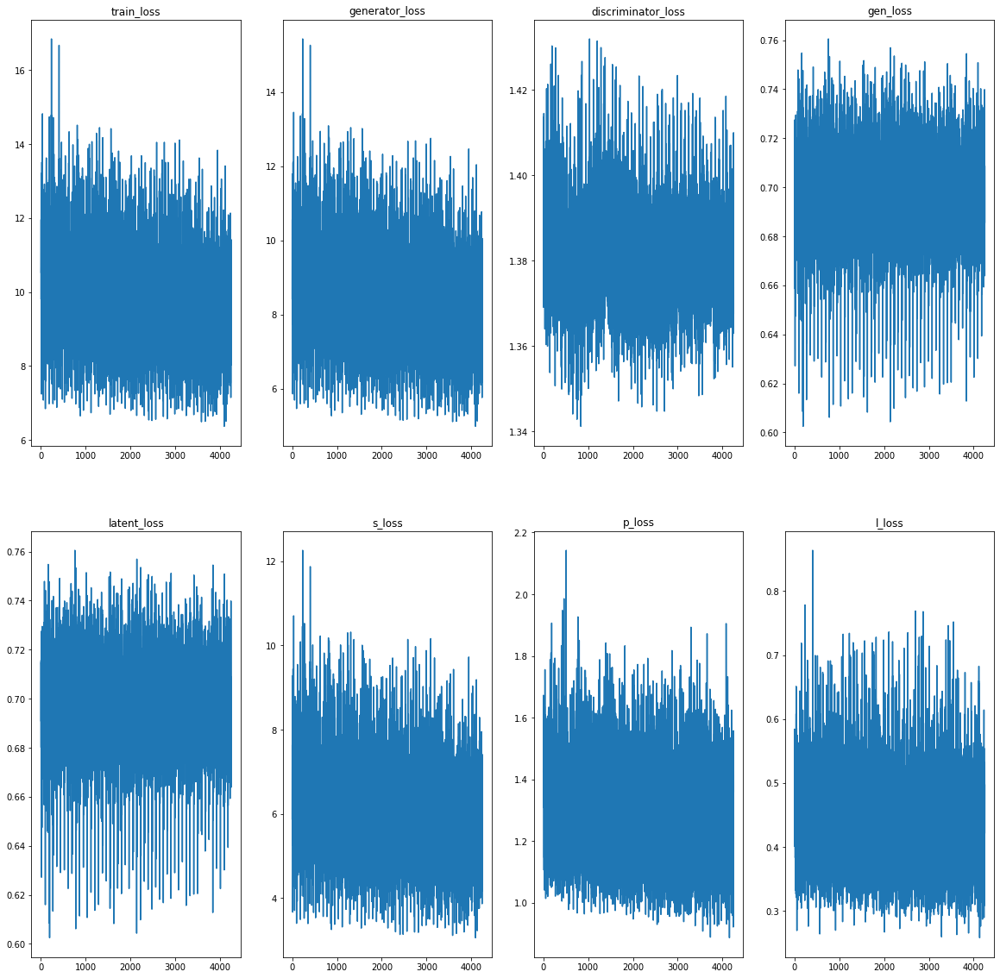

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, gen_loss_results, s_loss_results, p_loss_results, l_loss_results)

In [ ]:
epochs = 20
train()

 Epoch 01/20 | Step 85/85 | Loss: 9.01202 | Discriminator loss: 1.38538 | Generator loss: 7.62664 | Epoch Time: 237.46
 Epoch 02/20 | Step 85/85 | Loss: 8.81013 | Discriminator loss: 1.37389 | Generator loss: 7.43623 | Epoch Time: 244.18
 Epoch 03/20 | Step 85/85 | Loss: 10.50999 | Discriminator loss: 1.36615 | Generator loss: 9.14384 | Epoch Time: 244.52
 Epoch 04/20 | Step 85/85 | Loss: 9.48660 | Discriminator loss: 1.39694 | Generator loss: 8.08966 | Epoch Time: 244.69
 Epoch 05/20 | Step 85/85 | Loss: 9.27353 | Discriminator loss: 1.39048 | Generator loss: 7.88305 | Epoch Time: 244.39
 Epoch 06/20 | Step 85/85 | Loss: 9.38658 | Discriminator loss: 1.38808 | Generator loss: 7.99850 | Epoch Time: 244.66
 Epoch 07/20 | Step 85/85 | Loss: 9.47699 | Discriminator loss: 1.39589 | Generator loss: 8.08110 | Epoch Time: 244.74
 Epoch 08/20 | Step 85/85 | Loss: 9.78429 | Discriminator loss: 1.39558 | Generator loss: 8.38871 | Epoch Time: 244.36
 Epoch 09/20 | Step 85/85 | Loss: 8.99029 | Dis

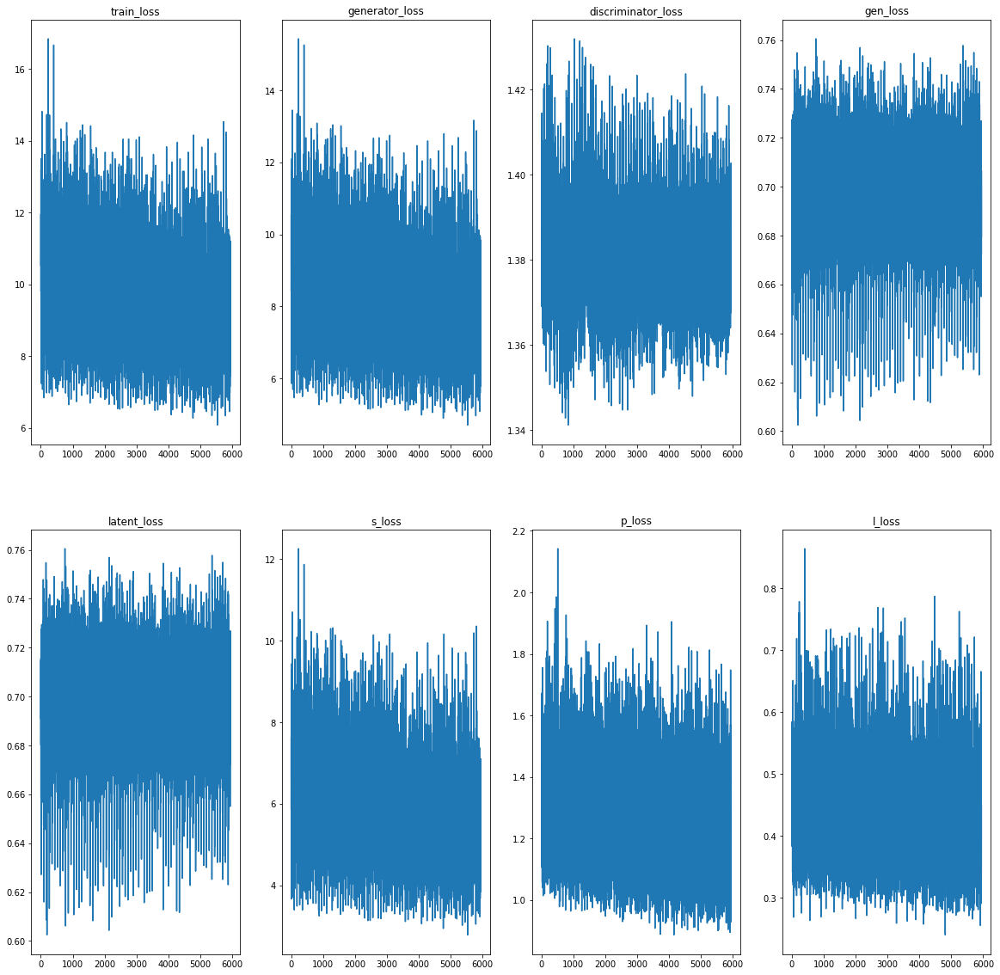

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, gen_loss_results, s_loss_results, p_loss_results, l_loss_results)

In [ ]:
train()

 Epoch 01/20 | Step 85/85 | Loss: 10.84233 | Discriminator loss: 1.38803 | Generator loss: 9.45430 | Epoch Time: 242.61
 Epoch 02/20 | Step 85/85 | Loss: 9.47253 | Discriminator loss: 1.38722 | Generator loss: 8.08531 | Epoch Time: 245.05
 Epoch 03/20 | Step 85/85 | Loss: 10.90877 | Discriminator loss: 1.36214 | Generator loss: 9.54663 | Epoch Time: 244.61
 Epoch 04/20 | Step 85/85 | Loss: 9.03671 | Discriminator loss: 1.38897 | Generator loss: 7.64775 | Epoch Time: 244.58
 Epoch 05/20 | Step 85/85 | Loss: 9.26653 | Discriminator loss: 1.37240 | Generator loss: 7.89413 | Epoch Time: 244.55
 Epoch 06/20 | Step 85/85 | Loss: 9.20826 | Discriminator loss: 1.38043 | Generator loss: 7.82783 | Epoch Time: 244.38
 Epoch 07/20 | Step 85/85 | Loss: 8.82799 | Discriminator loss: 1.38868 | Generator loss: 7.43931 | Epoch Time: 244.94
 Epoch 08/20 | Step 85/85 | Loss: 8.29049 | Discriminator loss: 1.38162 | Generator loss: 6.90887 | Epoch Time: 245.20
 Epoch 09/20 | Step 85/85 | Loss: 8.69083 | Di

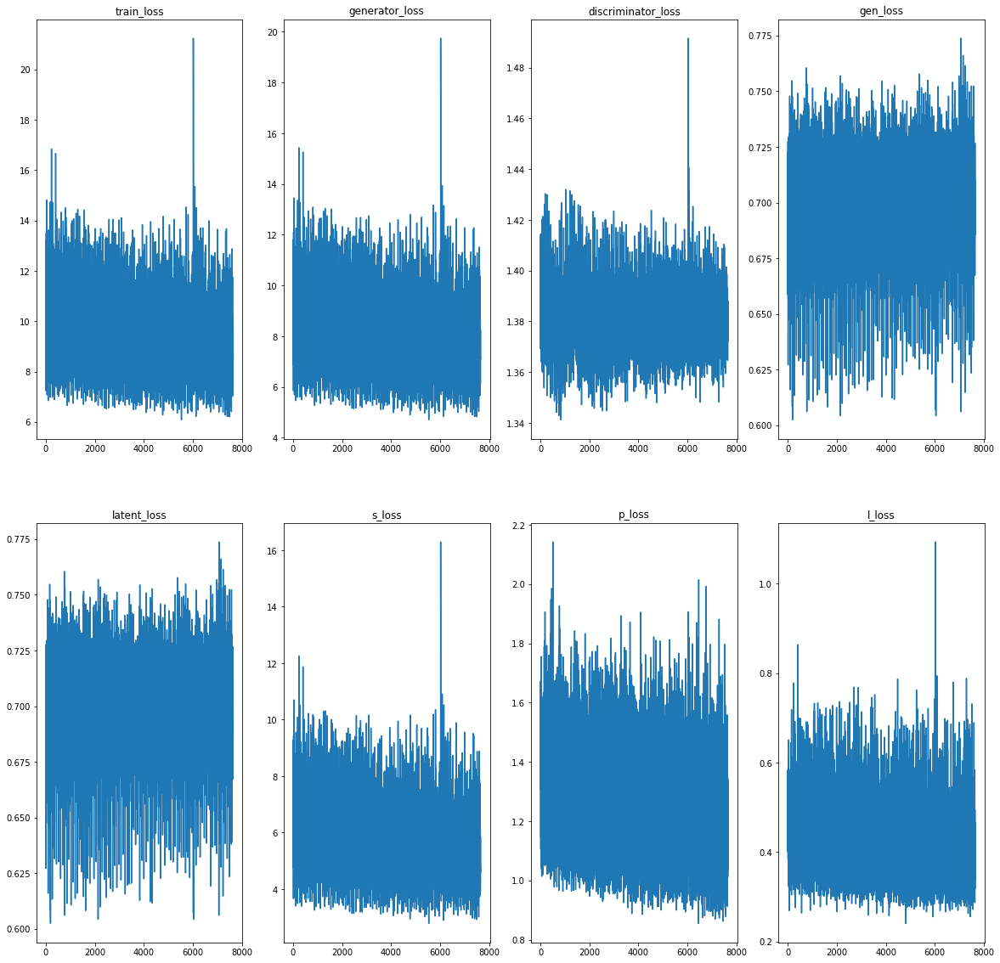

In [ ]:
plot_metrics(train_loss_results, generator_loss_results, discriminator_loss_results, 
             gen_loss_results, gen_loss_results, s_loss_results, p_loss_results, l_loss_results)

## tests

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot11", "shot20", "shot311", "shot320"])

y_trans, _, _ = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

reference_0 = tf.concat([reference_0[1][..., :1], reference_0[0]], -1) #4x256x256x4
target = tf.concat([middle[1][..., :1], y_trans], -1) # 4x256x256x4
reference_1 = tf.concat([reference_1[1][..., :1], reference_1[0]], -1) # 4x256x256x4

input = tf.stack([reference_0, target, reference_1], axis=1) # 4x3x256x256x4
# BxTxHxWxC

y_final = temporal_network(input, training=False) #(4, 3, 256, 256, 3)
y_final.shape

TensorShape([4, 3, 256, 256, 3])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


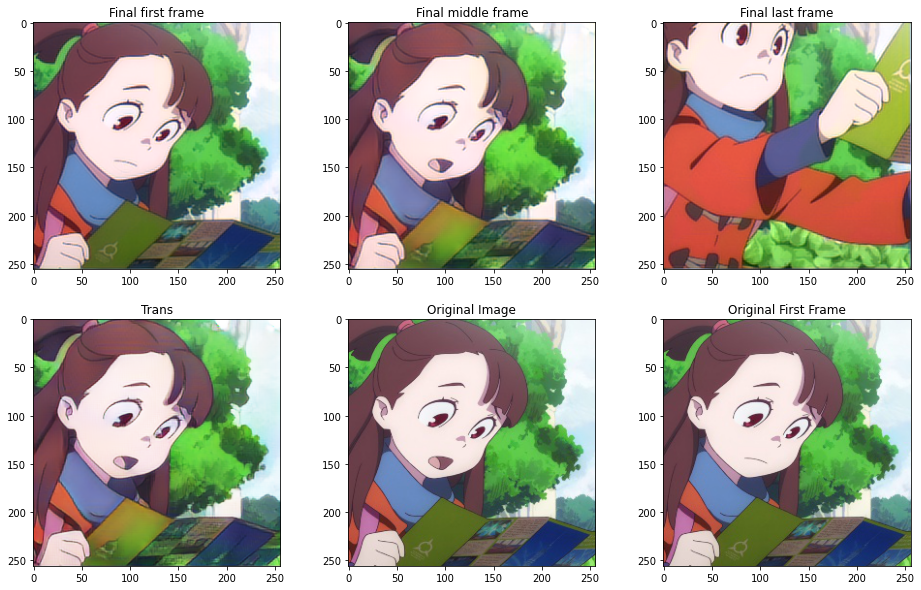

In [ ]:
n = 0
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


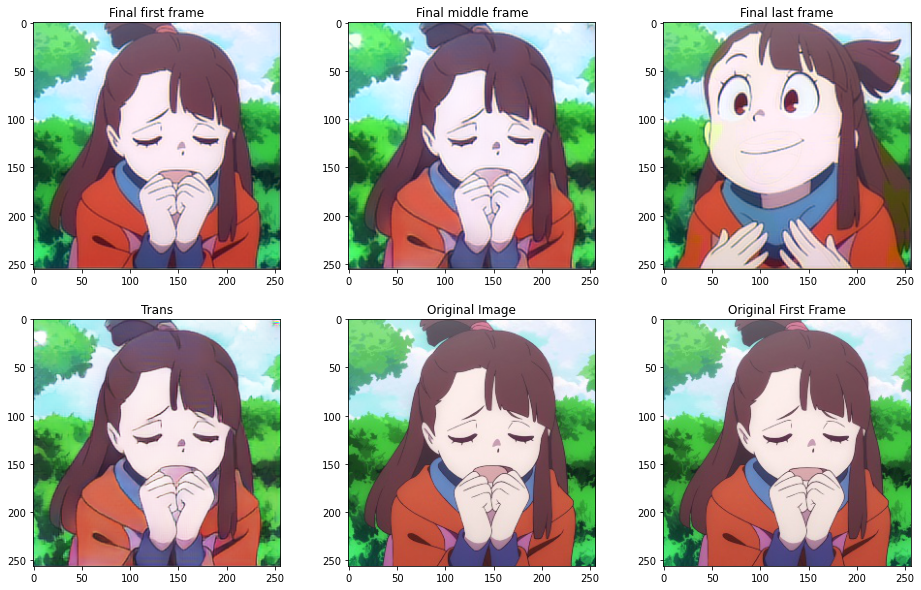

In [ ]:
n = 1
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


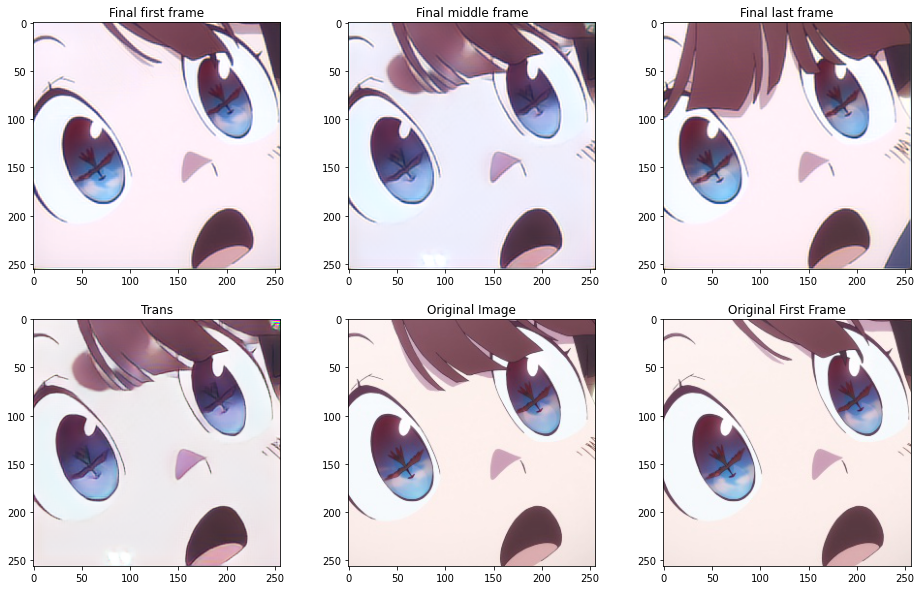

In [ ]:
n = 2
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


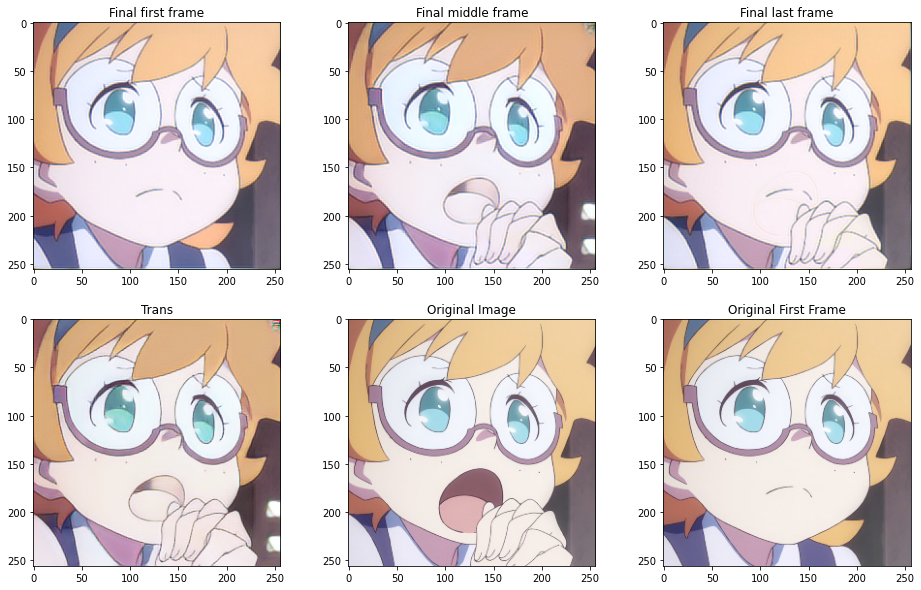

In [ ]:
n = 3
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot9", "shot18", "shot36", "shot48"])

y_trans, _, _ = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

reference_0 = tf.concat([reference_0[1][..., :1], reference_0[0]], -1) #4x256x256x4
target = tf.concat([middle[1][..., :1], y_trans], -1) # 4x256x256x4
reference_1 = tf.concat([reference_1[1][..., :1], reference_1[0]], -1) # 4x256x256x4

input = tf.stack([reference_0, target, reference_1], axis=1) # 4x3x256x256x4
# BxTxHxWxC

y_final = temporal_network(input, training=False) #(4, 3, 256, 256, 3)
y_final.shape

TensorShape([4, 3, 256, 256, 3])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


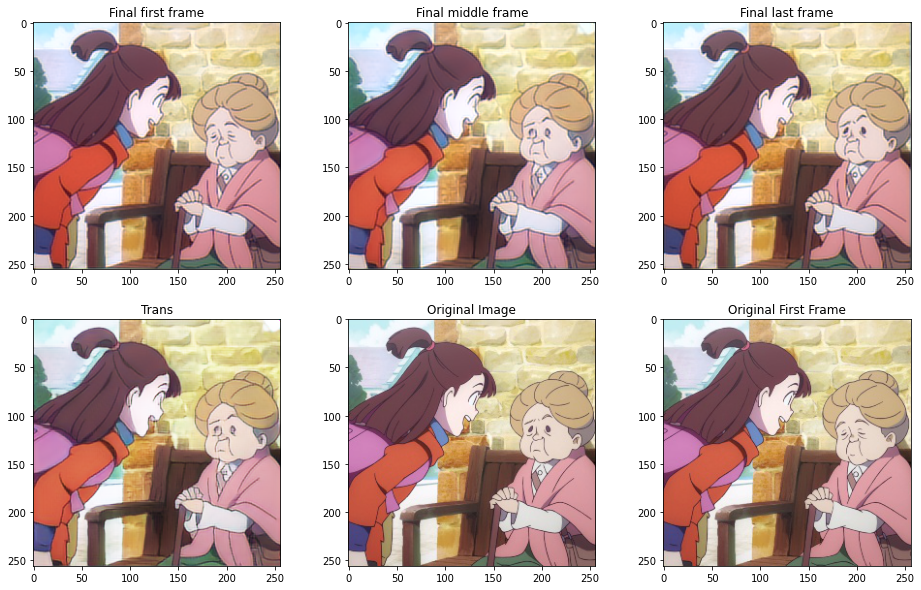

In [ ]:
n = 0
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


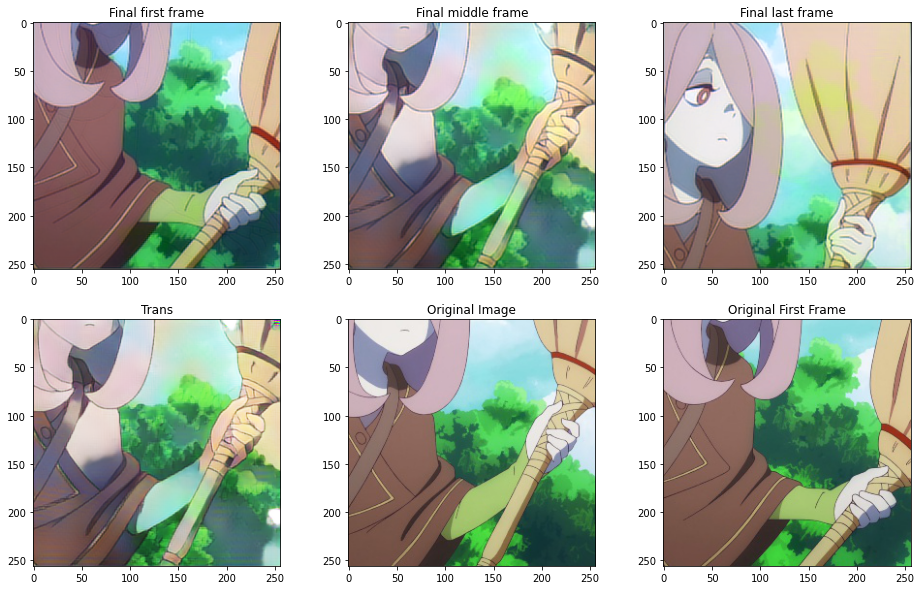

In [ ]:
n = 1
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


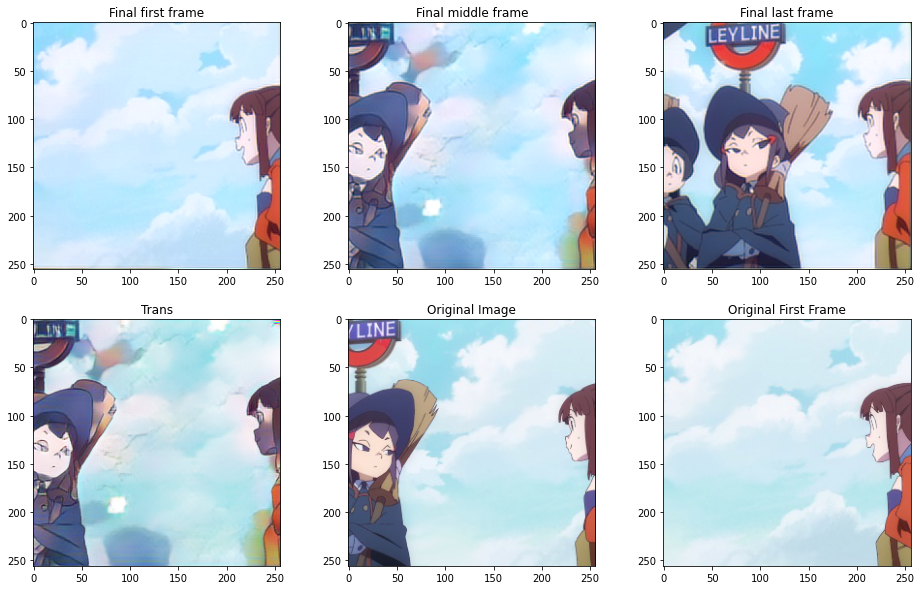

In [ ]:
n = 2
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


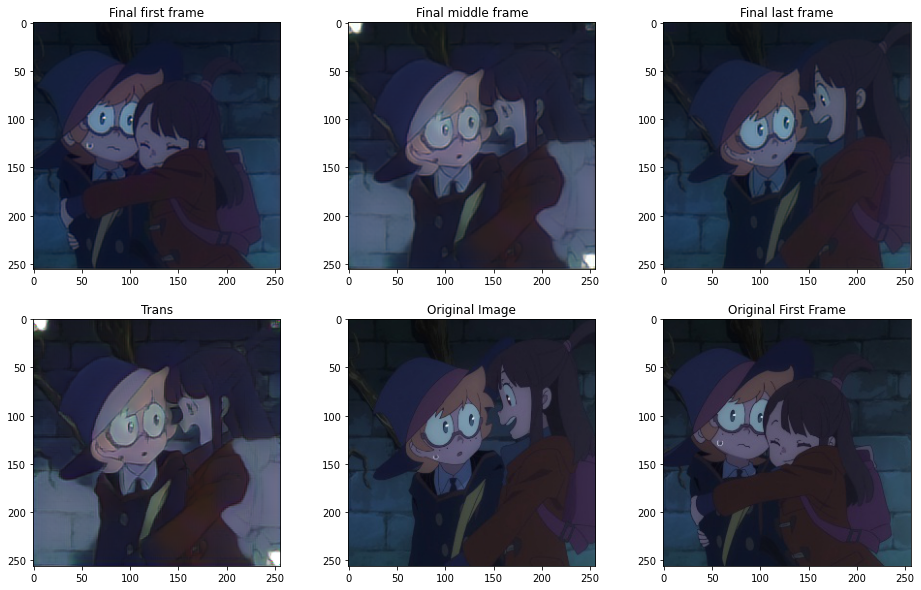

In [ ]:
n = 3
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot17", "shot27", "shot37", "shot47"])

y_trans, _, _ = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

reference_0 = tf.concat([reference_0[1][..., :1], reference_0[0]], -1) #4x256x256x4
target = tf.concat([middle[1][..., :1], y_trans], -1) # 4x256x256x4
reference_1 = tf.concat([reference_1[1][..., :1], reference_1[0]], -1) # 4x256x256x4

input = tf.stack([reference_0, target, reference_1], axis=1) # 4x3x256x256x4
# BxTxHxWxC

y_final = temporal_network(input, training=False) #(4, 3, 256, 256, 3)
y_final.shape

TensorShape([4, 3, 256, 256, 3])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


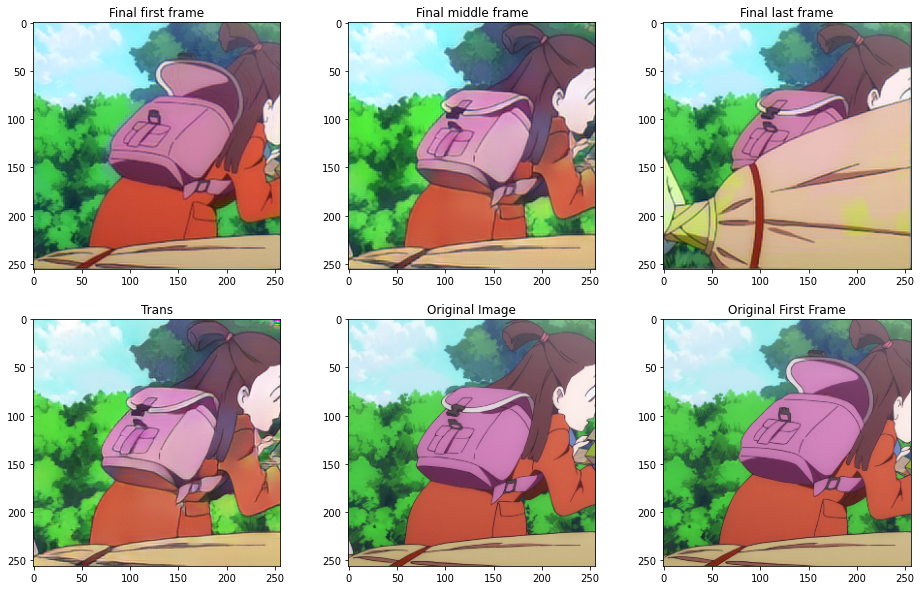

In [ ]:
n = 0
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


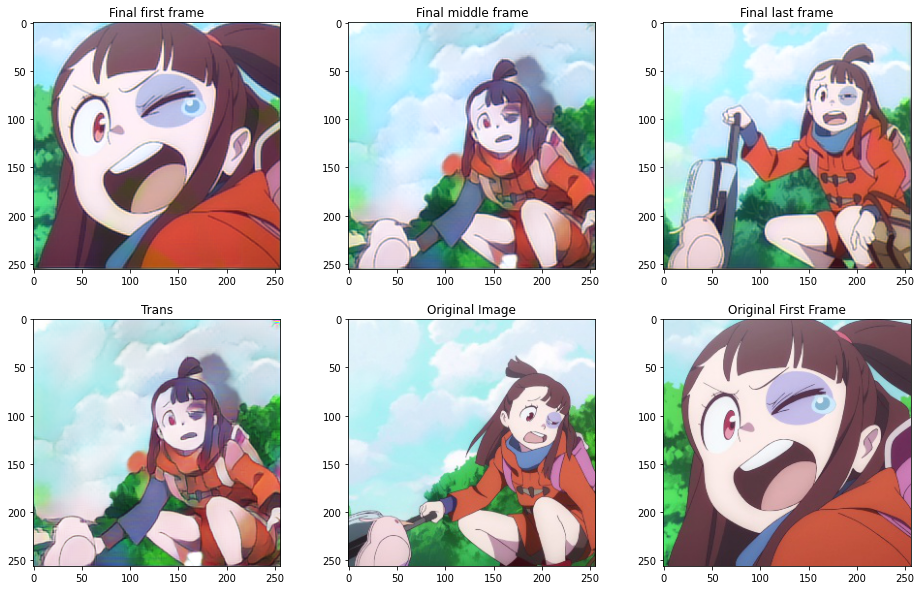

In [ ]:
n = 1
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


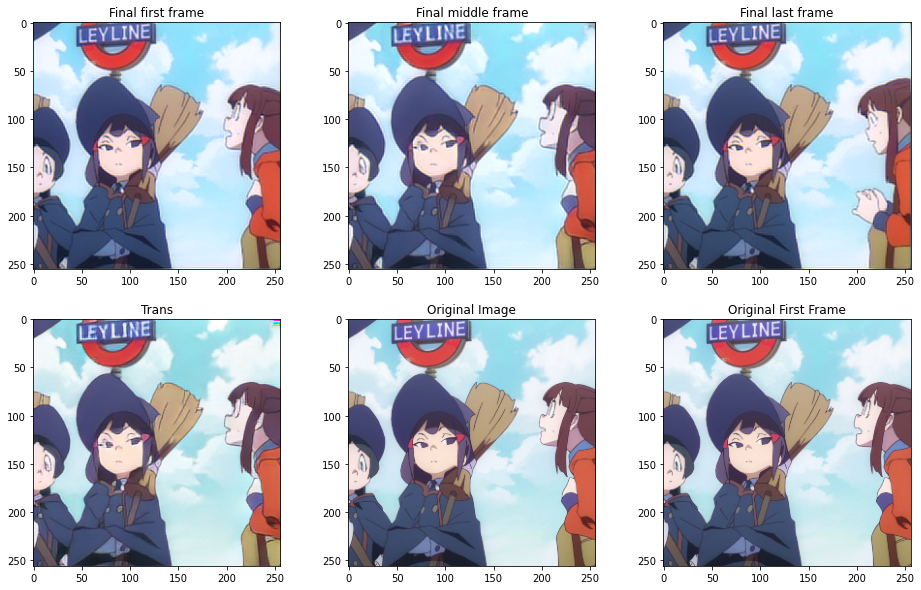

In [ ]:
n = 2
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


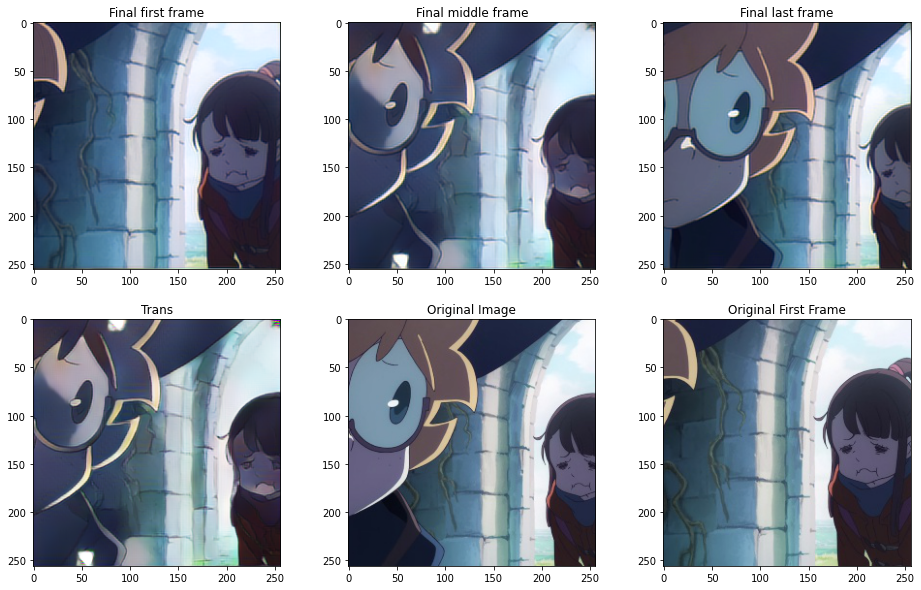

In [ ]:
n = 3
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

In [ ]:
# Shot 57 contains errors in the last line art image

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot56", "shot67", "shot77", "shot87"])

y_trans, _, _ = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

reference_0 = tf.concat([reference_0[1][..., :1], reference_0[0]], -1) #4x256x256x4
target = tf.concat([middle[1][..., :1], y_trans], -1) # 4x256x256x4
reference_1 = tf.concat([reference_1[1][..., :1], reference_1[0]], -1) # 4x256x256x4

input = tf.stack([reference_0, target, reference_1], axis=1) # 4x3x256x256x4
# BxTxHxWxC

y_final = temporal_network(input, training=False) #(4, 3, 256, 256, 3)
y_final.shape

TensorShape([4, 3, 256, 256, 3])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


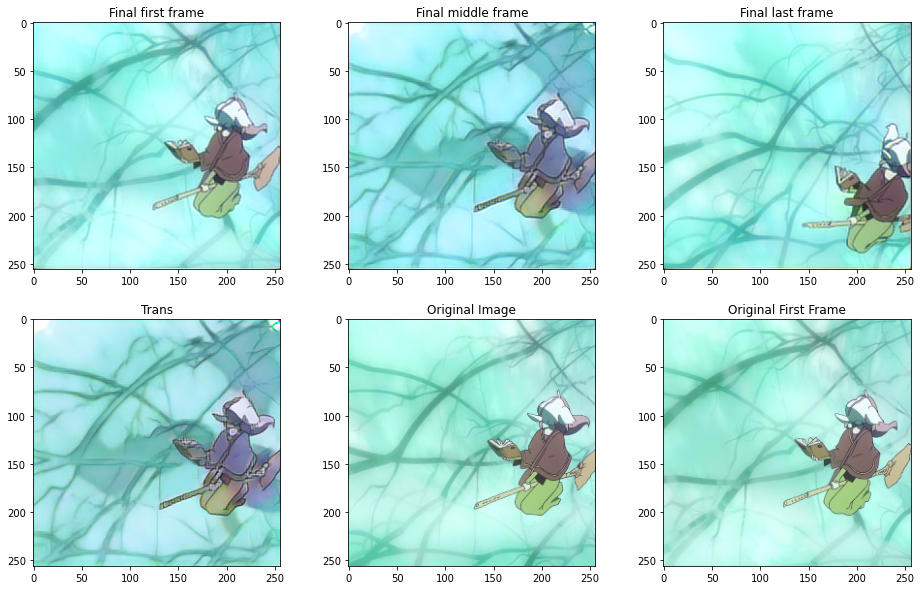

In [ ]:
n = 0
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


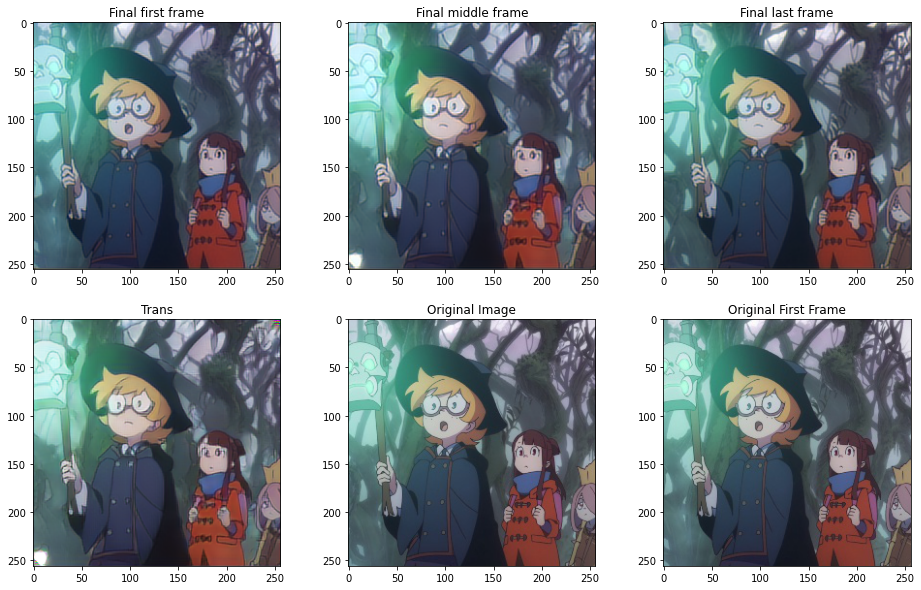

In [ ]:
n = 1
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


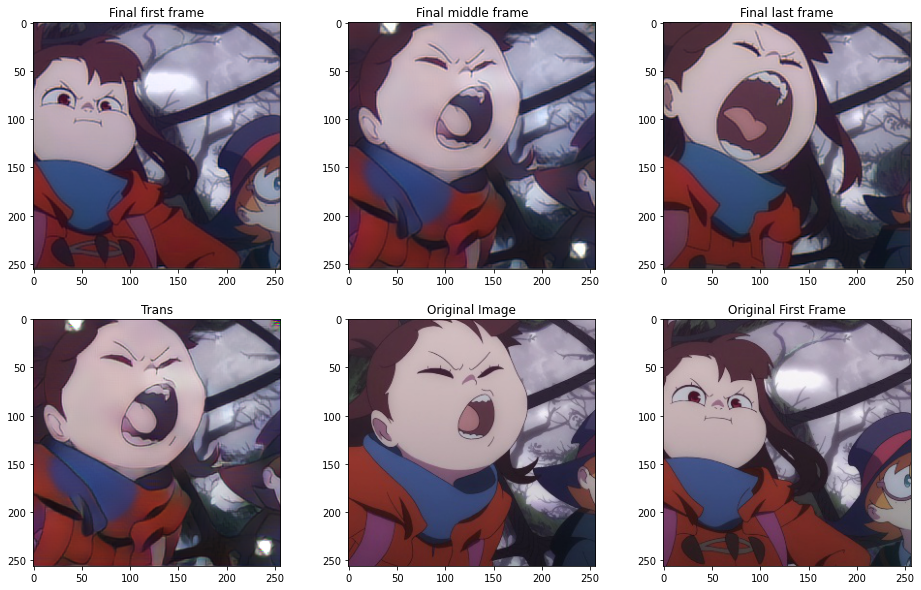

In [ ]:
n = 2
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


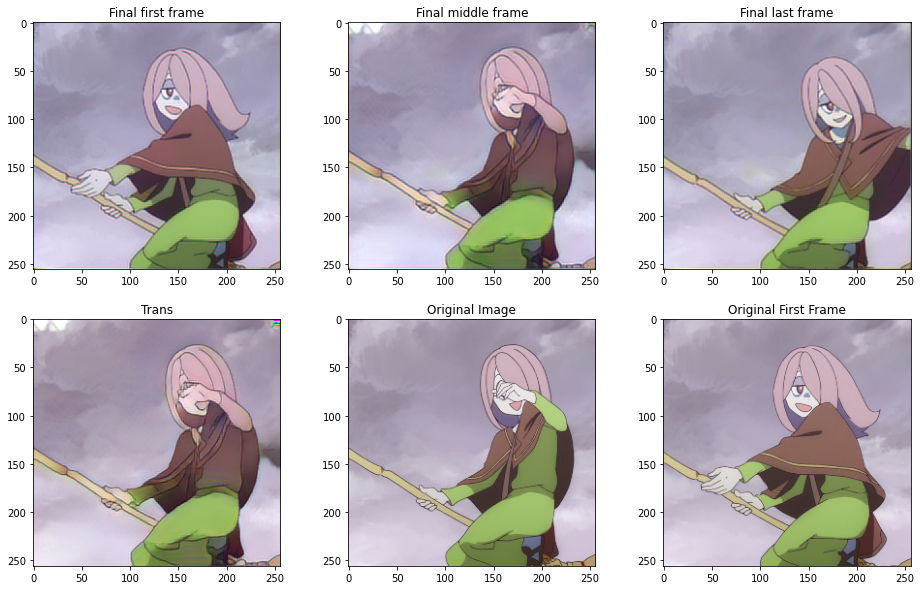

In [ ]:
n = 3
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

In [ ]:
reference_0, middle, reference_1 = test_generator.getitem(["shot300", "shot301", "shot302", "shot303"])

y_trans, _, _ = color_network([middle[1], middle[2],
                                                  reference_0[0], reference_0[1],
                                                  reference_0[2], reference_1[0], 
                                                  reference_1[1], reference_1[2]])

reference_0 = tf.concat([reference_0[1][..., :1], reference_0[0]], -1) #4x256x256x4
target = tf.concat([middle[1][..., :1], y_trans], -1) # 4x256x256x4
reference_1 = tf.concat([reference_1[1][..., :1], reference_1[0]], -1) # 4x256x256x4

input = tf.stack([reference_0, target, reference_1], axis=1) # 4x3x256x256x4
# BxTxHxWxC

y_final = temporal_network(input, training=False) #(4, 3, 256, 256, 3)
y_final.shape

TensorShape([4, 3, 256, 256, 3])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


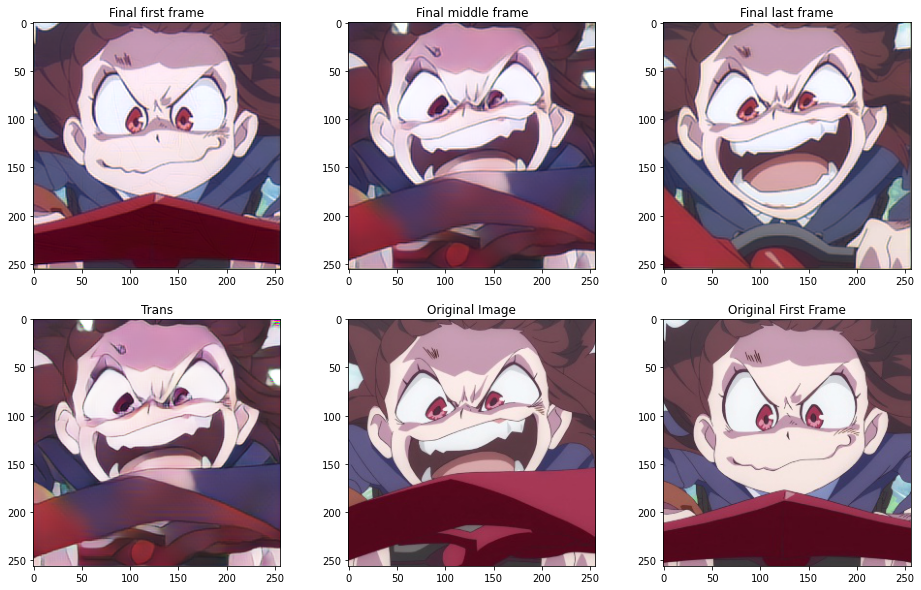

In [ ]:
n = 0
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


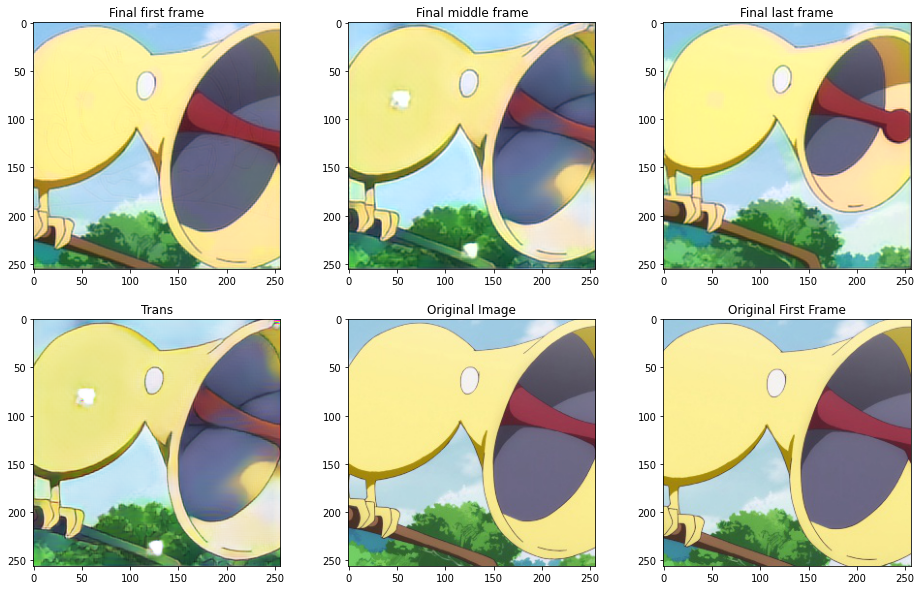

In [ ]:
n = 1
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


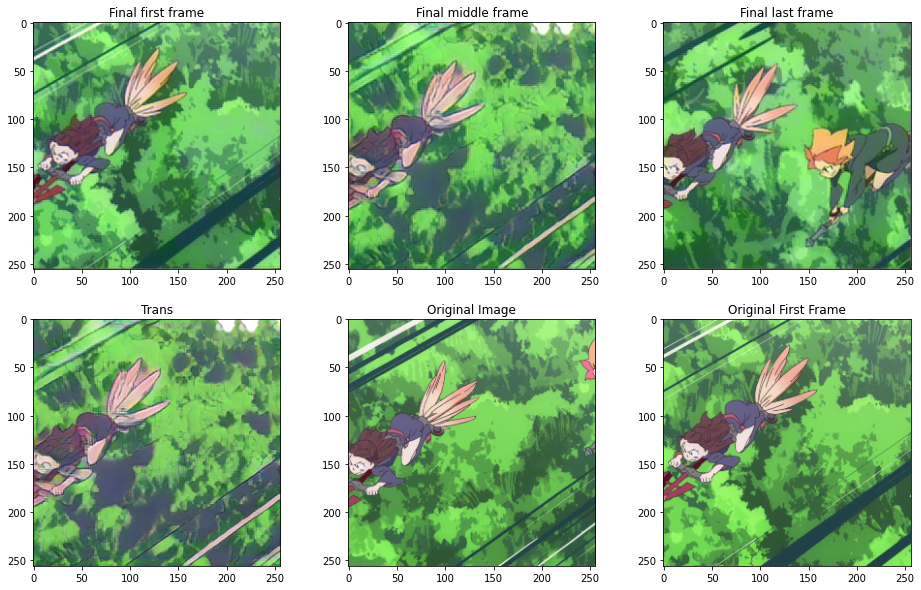

In [ ]:
n = 2
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


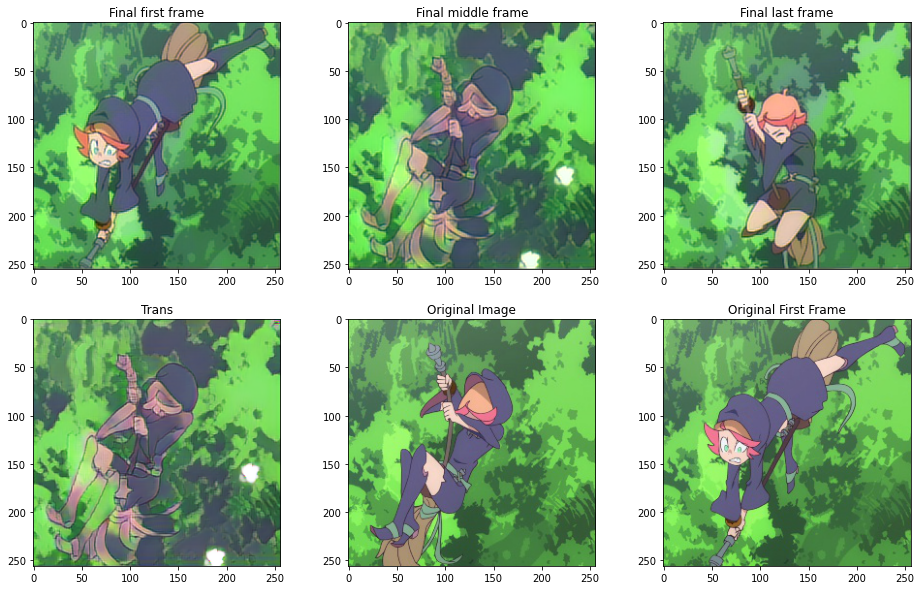

In [ ]:
n = 3
_, ax = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))
ax[0, 0].set_title("Final first frame")
ax[0, 0].imshow(y_final[n][0])

ax[0, 1].set_title("Final middle frame")
ax[0, 1].imshow(y_final[n][1])

ax[0, 2].set_title("Final last frame")
ax[0, 2].imshow(y_final[n][2])

ax[1, 0].set_title("Trans")
ax[1, 0].imshow(y_trans[n])

ax[1, 1].set_title("Original Image")
ax[1, 1].imshow(middle[0][n])

ax[1, 2].set_title("Original First Frame")
ax[1, 2].imshow(reference_0[n][:, :, 1:])